# Request ZTF Forced Photometry and Plot Results 

In [140]:
#pip install PyAstronomy

from astroquery.vizier import Vizier
import pandas as pd
import numpy as np
from __future__ import print_function, division
from PyAstronomy import pyasl
import requests
import os
import matplotlib.pyplot as plt
from ztffps import get_cycle, get_lightcurve
from IPython.display import Image,display, HTML
from astroquery.simbad import Simbad
from astropy.coordinates import SkyCoord
from astropy import units as u
from read_swift import read_swift_data
from io import StringIO
import copy

%matplotlib notebook

In [2]:
# Find catalogs

Vizier.find_catalogs('ritter')

OrderedDict([('III/265', </>),
             ('III/272', </>),
             ('III/283', </>),
             ('V/59', </>),
             ('V/82', </>),
             ('V/99', </>),
             ('V/110', </>),
             ('V/113D', </>),
             ('V/123A', </>),
             ('B/cb', </>),
             ('J/ApJ/851/107', </>),
             ('J/ApJS/225/24', </>),
             ('J/A+A/666/A152', </>),
             ('J/A+AS/123/273', </>),
             ('J/AJ/117/1313', </>)])

In [3]:
# Get catalogs

Vizier.ROW_LIMIT = -1
catalogs = Vizier.get_catalogs('B/cb')
catalogs.print_table_list()

TableList with 10 tables:
	'0:B/cb/cbdata' with 11 column(s) and 1429 row(s) 
	'1:B/cb/lmxbdata' with 11 column(s) and 108 row(s) 
	'2:B/cb/pcbdata' with 11 column(s) and 619 row(s) 
	'3:B/cb/findrefs' with 3 column(s) and 4858 row(s) 
	'4:B/cb/cbrefs' with 3 column(s) and 2953 row(s) 
	'5:B/cb/lmxbrefs' with 3 column(s) and 310 row(s) 
	'6:B/cb/pcbrefs' with 3 column(s) and 1201 row(s) 
	'7:B/cb/whoswho1' with 3 column(s) and 12814 row(s) 
	'8:B/cb/whoswho2' with 3 column(s) and 7307 row(s) 
	'9:B/cb/whoswho5' with 2 column(s) and 1543 row(s) 


In [4]:
# Pull RITTER Catalog

catalog = catalogs[1].to_pandas()
len(catalog)

108

RITTER column descriptions: https://heasarc.gsfc.nasa.gov/W3Browse/all/ritterlmxb.html

In [5]:
# Pull a new catalog, XRBcats

new_catalog = Vizier.get_catalogs('J/A+A/675/A199')[0].to_pandas()
new_catalog['AltName'] = new_catalog['Name']
len(new_catalog)

349

In [6]:
# cross match RITTER and XRBcats catalogs, find unique objects in XRBcats 

delete1 = pd.merge(new_catalog, catalog, on=['Name'], how='inner')
delete2 = pd.merge(new_catalog, catalog, on=['AltName'], how='inner')

new_catalog = new_catalog[~new_catalog['Name'].isin(delete1['Name'])]
new_catalog = new_catalog[~new_catalog['AltName'].isin(delete2['AltName'])]
len(new_catalog)

323

In [7]:
# Define functions 

def request_ztffps(ra, dec, jdstart="", jdend="", email="ykwang@uw.edu", userpass="hgbs526"):
    """Submit a request to ZTFFPS with object coordinates"""
    
    url = "https://ztfweb.ipac.caltech.edu/cgi-bin/requestForcedPhotometry.cgi"
    params = {
        "ra": ra,
        "dec": dec,
        "jdstart": jdstart,
        "jdend": jdend,
        "email": email,
        "userpass": userpass,
    }
    response = requests.get(url, params=params, auth=("ztffps", "dontgocrazy!"))
    if response.status_code == 200:
        with open("test_data.txt", "wb") as f:
    #         f.write(response.content)
            print("Download successful. Data saved in 'log.txt'")
    else:
        print(f"Failed to download. Status code: {response.status_code}")
        

def download_ztffps(lc_dir, output_fname="output.txt"):
    """Download forced photometry """
    
    url = f"https://ztfweb.ipac.caltech.edu{lc_dir}"
    response = requests.get(url, auth=("ztffps", "dontgocrazy!"))
    if response.status_code == 200:
        with open(f"catalog_data/{output_fname}", "w") as output_file:
            output_file.write(response.text)
        print(f"Download successful. Data saved in '{output_fname}'")
    else:
        print(f"Download failed. Status code: {response.status_code}")

In [8]:
# split table into a chunk that wont overload ztffps with too many requests at a time

ritter_chunk = catalog[100:]
ritter_chunk = ritter_chunk.astype(str)


cats_chunk = new_catalog[300:]

In [9]:
# get cordinates from RITTER in the correct format

coords = ritter_chunk['RAJ2000'] + ' ' + ritter_chunk['DEJ2000'] # RITTER

## Loop that requests forced photometry

In [10]:
# RITTER
for c in coords:
    ras, decs = pyasl.coordsSexaToDeg(c)
    #request_ztffps(ras, decs)

# XRBcats
for RA, DEC in zip(cats_chunk.RA_ICRS, cats_chunk.DE_ICRS):
    #request_ztffps(RA, DEC) 

IndentationError: expected an indented block (2755941633.py, line 8)

In [ ]:
len(output)

## Download completed requests

In [102]:
output = pd.read_csv('output.txt', delim_whitespace=True, comment='#', header=0,names=['reqId','ra','dec','startJD','endJD','created1','created2','started1','started2','ended1','ended2','machine','exitcode','lightcurve'])
output

,reqId,ra,dec,startJD,endJD,created1,created2,started1,started2,ended1,ended2,machine,exitcode,lightcurve
0,253650,266.137917,-28.740833,2458194.5,2460171.5,2023-08-14,11:49:25.156432,2023-08-14,11:49:27.403643,2023-08-14,11:49:28.021811,34,63,/ztf/ops/forcedphot/lc/0/253/req253650/cksum2b...
1,253651,265.978333,-29.745278,2458194.5,2460171.5,2023-08-14,11:49:25.211178,2023-08-14,11:49:26.852621,2023-08-14,11:49:27.246146,35,63,/ztf/ops/forcedphot/lc/0/253/req253651/cksum64...
2,253652,273.629583,-17.157222,2458194.5,2460171.5,2023-08-14,11:49:25.239873,2023-08-14,11:49:26.970795,2023-08-14,12:18:22.021029,36,57,/ztf/ops/forcedphot/lc/0/253/req253652/cksum35...
3,253653,270.301667,-25.743333,2458194.5,2460171.5,2023-08-14,11:49:25.271903,2023-08-14,11:49:26.861837,2023-08-14,12:05:01.44684,37,61,/ztf/ops/forcedphot/lc/0/253/req253653/cksum54...
4,253654,253.500417,-39.845833,2458194.5,2460171.5,2023-08-14,13:20:26.766013,2023-08-14,13:20:30.149728,2023-08-14,13:20:30.535876,33,63,/ztf/ops/forcedphot/lc/0/253/req253654/cksum4d...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,254180,326.171467,38.321406,2458194.5,2460174.5,2023-08-17,09:53:16.153254,2023-08-17,10:04:35.170503,2023-08-17,10:49:02.106111,63,61,/ztf/ops/forcedphot/lc/0/254/req254180/cksum5e...
426,254181,287.221128,9.384731,2458194.5,2460174.5,2023-08-17,09:53:16.216077,2023-08-17,10:13:37.930687,2023-08-17,10:55:22.786778,6,57,/ztf/ops/forcedphot/lc/0/254/req254181/cksuma4...
427,254182,285.417500,1.441944,2458194.5,2460174.5,2023-08-17,09:53:16.256529,2023-08-17,10:19:39.679549,2023-08-17,11:03:49.00165,36,57,/ztf/ops/forcedphot/lc/0/254/req254182/cksumd8...
428,254183,336.206875,54.386139,2458194.5,2460174.5,2023-08-17,09:53:16.425387,2023-08-17,10:19:39.808808,2023-08-17,11:11:49.425765,37,61,/ztf/ops/forcedphot/lc/0/254/req254183/cksum6b...


In [103]:
# get links to completed ztffps requests
links = output['lightcurve'].values

In [104]:
# download data to catalog_data folder

for i in links:
    #download_ztffps(i, output_fname=f'{i[32:38]}.txt')

IndentationError: expected an indented block (1737230840.py, line 4)

## Get object names (simbad link)

In [105]:
# change ra and dec to degree format

catalog = catalog.astype(str)
raw_coords = catalog['RAJ2000'] + ' ' + catalog['DEJ2000']
ras=[]
decs=[]
for i in raw_coords:
    ra, dec = pyasl.coordsSexaToDeg(i)
    ras = np.append(ras, ra)
    decs = np.append(decs, dec)
    
catalog['ra'] = ras
catalog['dec'] = decs

In [106]:
# merge catalogs with output tables to get object names

catalog_names = pd.merge(catalog, output, on=['ra'], how='inner')
print(len(catalog_names))

new_catalog.rename(columns={"RA_ICRS": "ra", "DE_ICRS": "dec"}, inplace=True)
new_catalog_names = pd.merge(new_catalog, output, on=['ra'], how='inner')
print(len(new_catalog_names))

41
328


In [74]:
customSimbad = Simbad()
customSimbad.add_votable_fields("otype(3)")
customSimbad.add_votable_fields("otypes(3)")  # returns a '|' separated list of all the otypes

def simbad_test(ras, decs):
    #logging.info("Checking packets for new sources")

    sc = SkyCoord(ras, decs, unit=u.degree)

    MATCH_RADIUS = 3 * u.arcsecond

    sep2d = None
    result_table = None
        
    result_table = customSimbad.query_region(sc, radius=MATCH_RADIUS)  
        # TODO: examine result_table for errors    
        # annoyingly, the result table is unsorted and unlabeled, so we have
        # to re-match it to our packets
    return result_table


In [ ]:
str[1:] str[:-1]

In [122]:
number = "253670"
row = output.loc[output['reqId'] == pd.to_numeric(number)]
row = row.reset_index()

ra1 = row['ra'][0]
dec1 = row['dec'][0]
dec1


0.585

In [75]:
simbad_test(ra1, dec1)

MAIN_ID,RA,DEC,RA_PREC,DEC_PREC,COO_ERR_MAJA,COO_ERR_MINA,COO_ERR_ANGLE,COO_QUAL,COO_WAVELENGTH,COO_BIBCODE,OTYPE_3,OTYPES_3,SCRIPT_NUMBER_ID
,"""h:m:s""","""d:m:s""",,,mas,mas,deg,,,,,,
object,str13,str13,int16,int16,float32,float32,int16,str1,str1,object,object,object,int32
[CIL99] Star e,19 11 16.05,+00 35 05.8,6,6,--,--,0,C,O,2009yCat....1.2023S,*,*,1
X Aql X-1,19 11 16.0571,+00 35 05.868,14,14,0.299,0.264,90,A,O,2020yCat.1350....0G,LXB,LXB|LXB|N*|V*|NIR|*|N*?|X|ev|gam,1
[CIL99] Star a,19 11 16.08,+00 35 05.9,6,6,--,--,0,C,O,2009yCat....1.2023S,*,*,1


In [126]:
# generate link to simbad query

def simbad_link(RA, DEC):
    print('SIMBAD query:')
    print(f'https://simbad.u-strasbg.fr/simbad/sim-coo?Coord={RA}%2C+{DEC}&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=')

In [127]:
simbad_link(ra1, dec1)

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=287.81625%2C+0.585&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=


## Plot results

### Objects of interest

In [287]:
def single_plot(ID, Name, skip_rows, ra, dec, include_bat=True, include_maxi=True):
    fig, ax1 = plt.subplots()
    fig.set_size_inches(9,7)
    fig.tight_layout()
    plt.title(Name)
    ax1.set_xlabel('MJD')

    # Read in ZTF optical data
    phot_file = f"catalog_data/{ID}.txt"
    colors = ['green', 'pink', 'm']
    ztf_fp = get_lightcurve(phot_file)
    wr = ztf_fp['filter'] == 'ZTF_r'
    wg = ztf_fp['filter'] == 'ZTF_g'
    color = 'green'

    # plot optical data
    ax1.set_ylabel('mag', color=color)
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.invert_yaxis()
    mkr_size = 3
    ax1.errorbar(ztf_fp.loc[wr,'mjd'],ztf_fp.loc[wr,'dc_mag'],
                 ztf_fp.loc[wr,'dc_mag_err'],fmt='o',ls='none', markersize=mkr_size, alpha=0.5,color=colors[2], label='ztf-r')
    ax1.scatter(ztf_fp.loc[wr,'mjd'],ztf_fp.loc[wr,'dc_maglim'], marker='v',alpha=0.25, s=mkr_size,
                edgecolor='none',color=colors[2], label='r limit')
    ax1.errorbar(ztf_fp.loc[wg,'mjd'],ztf_fp.loc[wg,'dc_mag'],
                 ztf_fp.loc[wg,'dc_mag_err'],fmt='o',ls='none', markersize=mkr_size,alpha=0.5, color=colors[0], label='ztf-g')
    ax1.scatter(ztf_fp.loc[wg,'mjd'],ztf_fp.loc[wg,'dc_maglim'], marker='v',alpha=0.25, s=mkr_size,
                edgecolor='none',color=colors[0], label='g limit')

    swift = pd.read_csv(f'catalog_data/xray/{Name}_swift.txt', delimiter = "\t", skiprows =skip_rows, names =["MJD", "T_+ve", "T_-ve", "Rate", "Ratepos", "Rateneg"])
    ybars_pc=(-swift['Rateneg'], swift['Ratepos'])
    for i in swift.columns:
        swift[f'{i}'] = pd.to_numeric(swift[f'{i}'])  

    # plot x-ray data
    ax2 = ax1.twinx()
    color2 = 'blue'
    ax2.set_ylabel('Count Rate', color=color2)
    ax2.tick_params(axis='y', labelcolor=color2)
    ax2.errorbar(swift['MJD'], swift['Rate'], yerr = ybars_pc,alpha=.8, fmt='*', color=color2, markersize= 6, label='X-ray counts')

    # SWIFT-BAT data
    if include_bat==True:
        bat=pd.read_csv(f'catalog_data/xray/{Name}_bat.txt', names=['time', 'rate', 'error','year','day','stat_err','sys_err','data_flag','timedel_expo','timedel_coded','timedel_dithered'],
                        comment='#', delim_whitespace=True)
        std_bat = np.std(bat['rate'])
        if std_bat != std_bat: std_bat=0
        bat = bat.query(f"rate>{std_bat*3}")
        ax2.errorbar(bat['time'], bat['rate'], alpha=.8, fmt='*', color='orange', markersize= mkr_size, label='SWIFT-BAT')

    # MAXI data
    if include_maxi==True:
        maxi = pd.read_csv(f'catalog_data/xray/{Name}_maxi.txt', names=['MJDcenter', 'counts', '2-20 err', '2-4keV', '2-4 err', '4-10keV', '4-10 err', '10-20keV', '10-20 err' ],
                   comment='#', delim_whitespace=True)
        std_maxi = np.std(maxi["counts"])
        if std_maxi != std_maxi: std_maxi=0
        maxi = maxi.query(f"counts > {std_maxi*3}")
        ax2.errorbar(maxi['MJDcenter'], maxi['counts'], alpha=.8, fmt='*', color='k', markersize= 3, label='MAXI')
    
    # SIMBAD link
    simbad_link(ra, dec)
    
    #finish plot
    ax1.legend(loc=2)
    ax2.legend(loc=1)
    ax2.set_yscale('log')
    plt.xlim([58000, 60200])

    plt.show()  

<IPython.core.display.Javascript object>


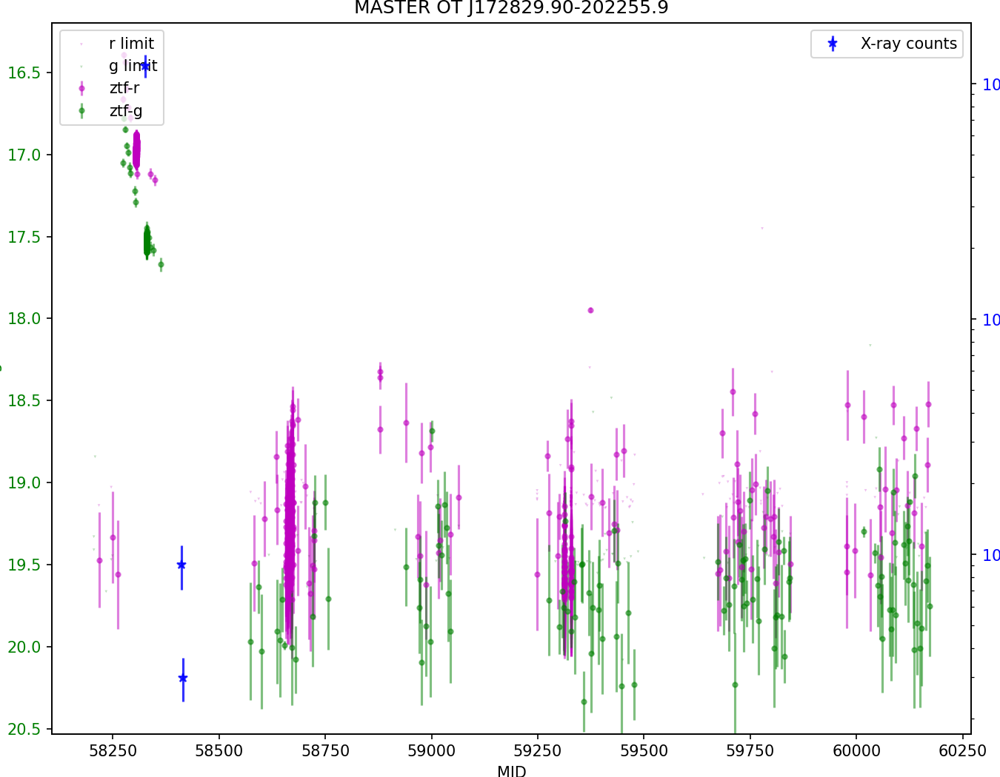

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=262.12466%2C+-20.3823&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


In [285]:
single_plot("253914", "MASTER OT J172829.90-202255.9", 29, 262.12466, -20.3823, include_bat=False, include_maxi=False)

<IPython.core.display.Javascript object>


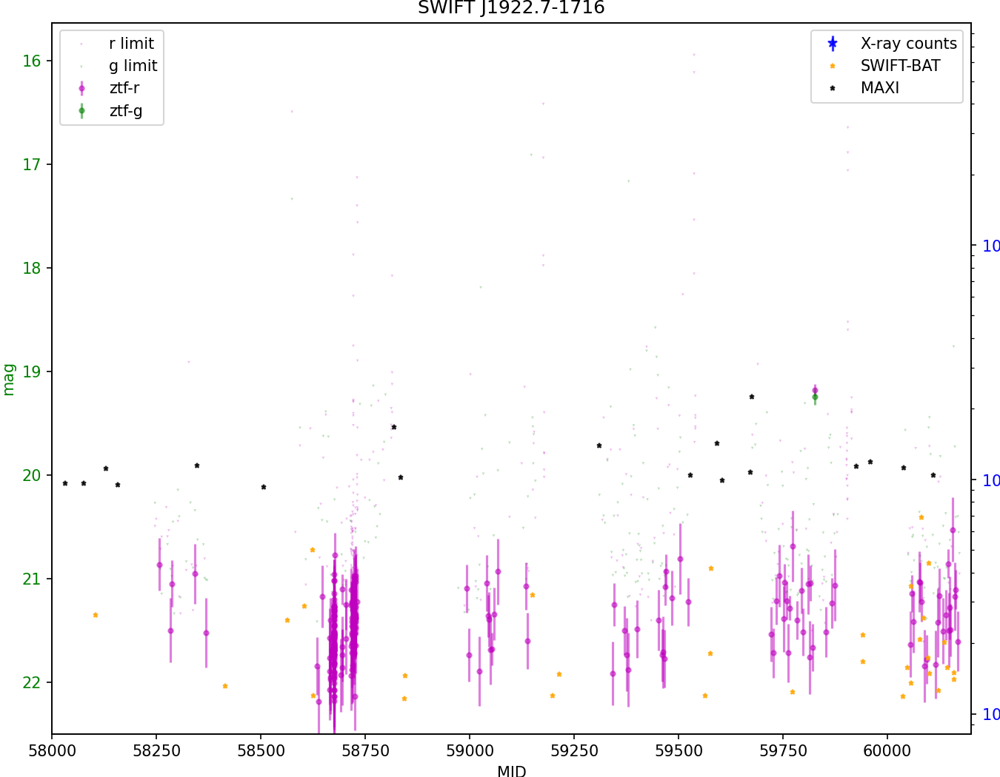

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=290.6542%2C+-17.2842&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=


In [288]:
single_plot("254162", "SWIFT J1922.7-1716", 30, 290.6542, -17.2842)

### All object

In [77]:
DATA_DIR = 'catalog_data/'

<IPython.core.display.Javascript object>


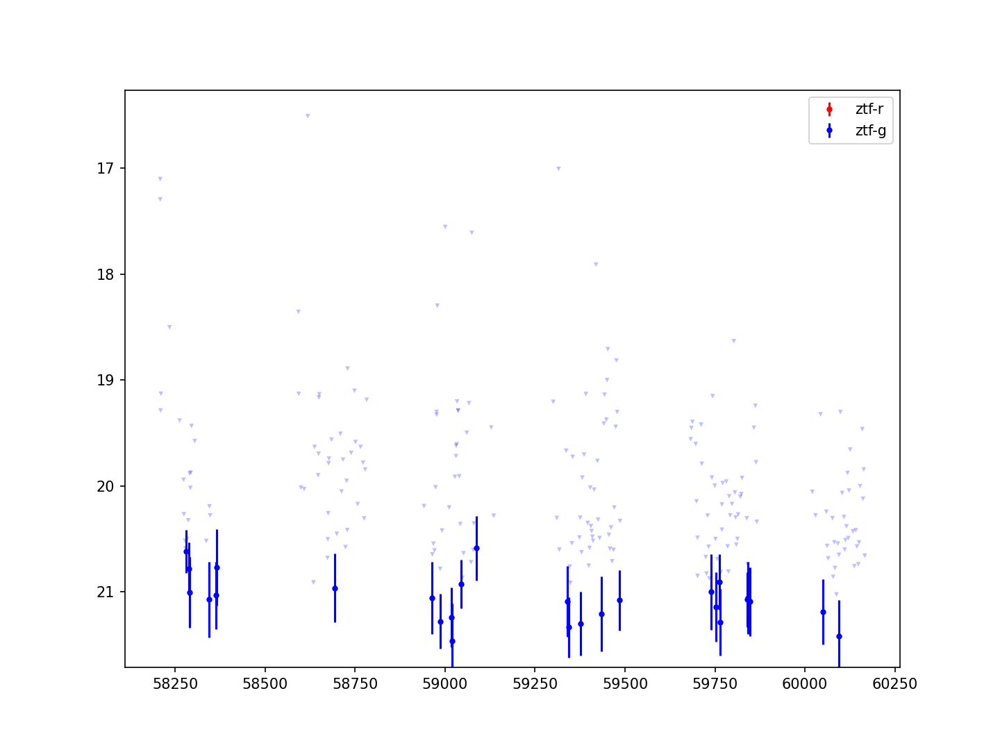

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=273.629583333333%2C+-17.1572222222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253652


<IPython.core.display.Javascript object>


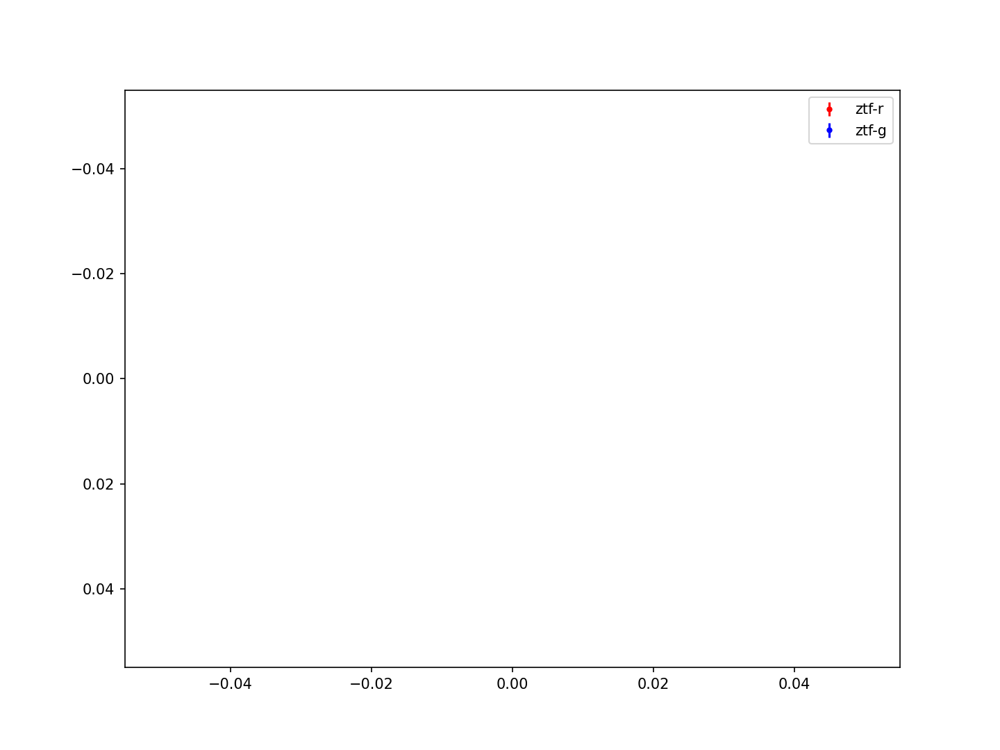

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=270.301666666667%2C+-25.7433333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253653


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


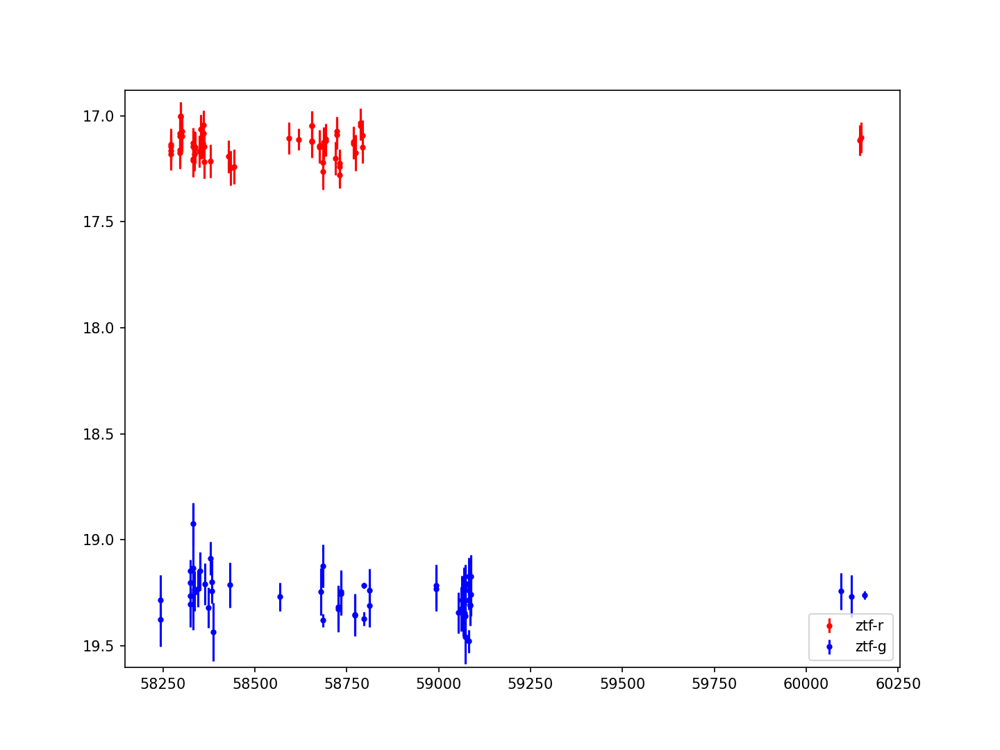

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=306.015833333333%2C+33.8675&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253655


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


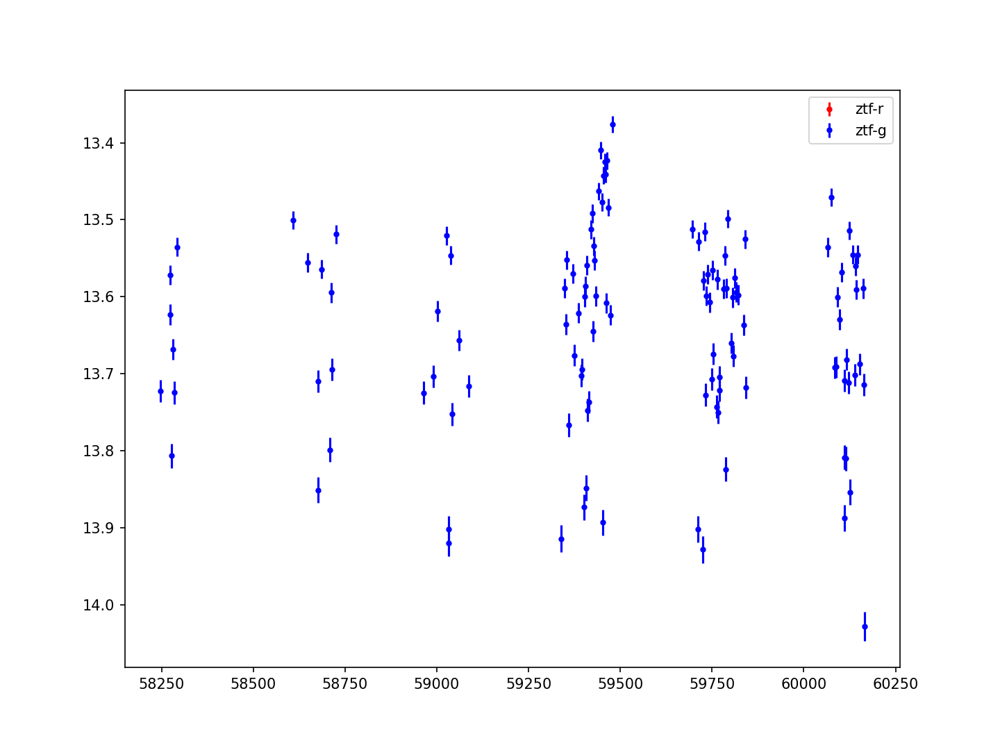

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.84%2C+-25.4069444444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253658


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


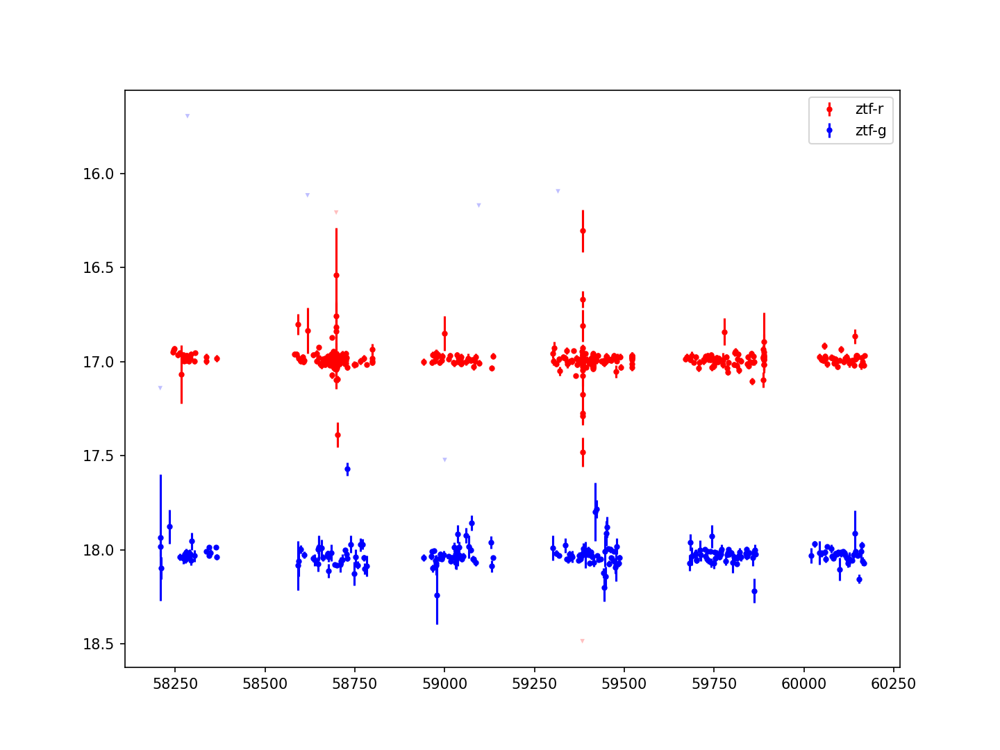

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.005833333333%2C+-14.0363888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253659


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


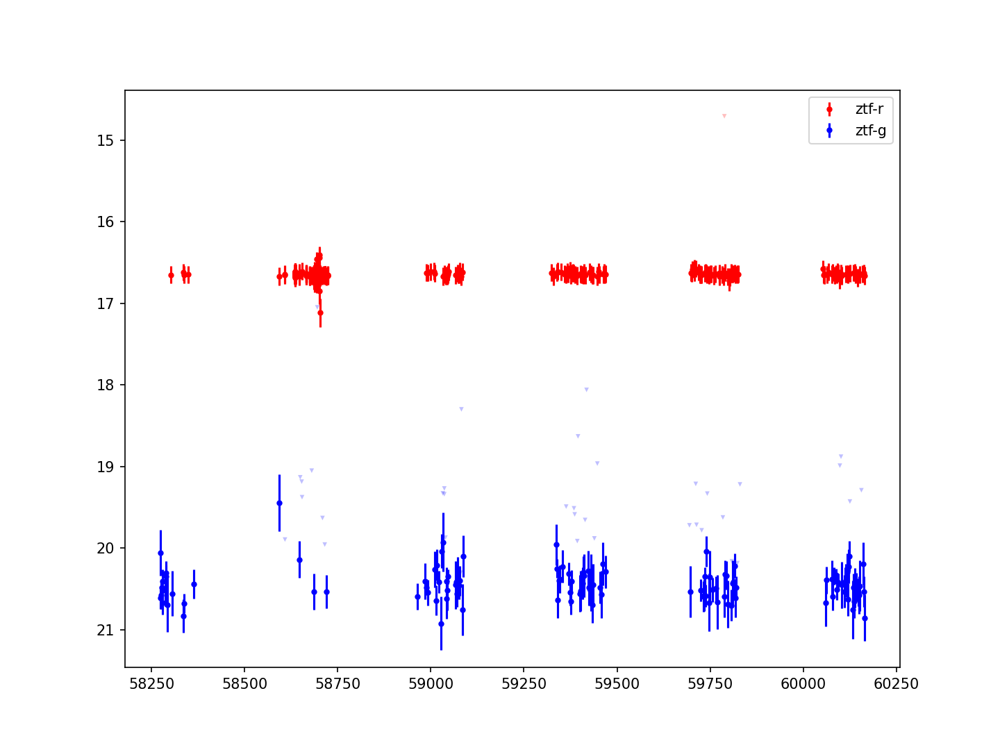

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.02%2C+-24.7802777777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253663


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


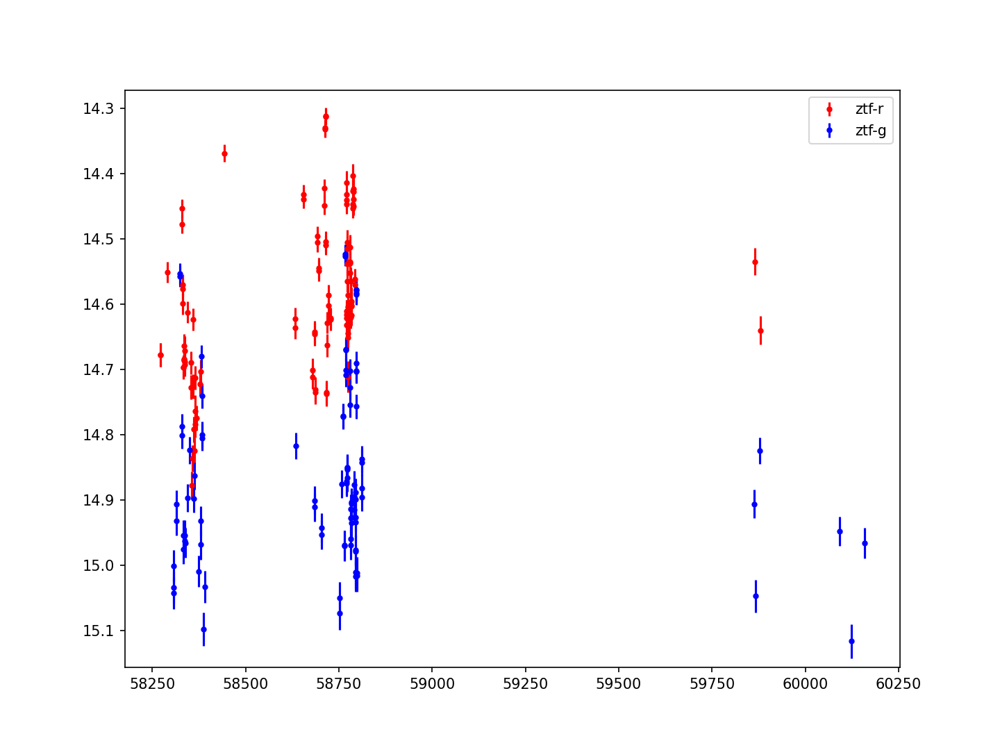

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=326.17125%2C+38.3216666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253664


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


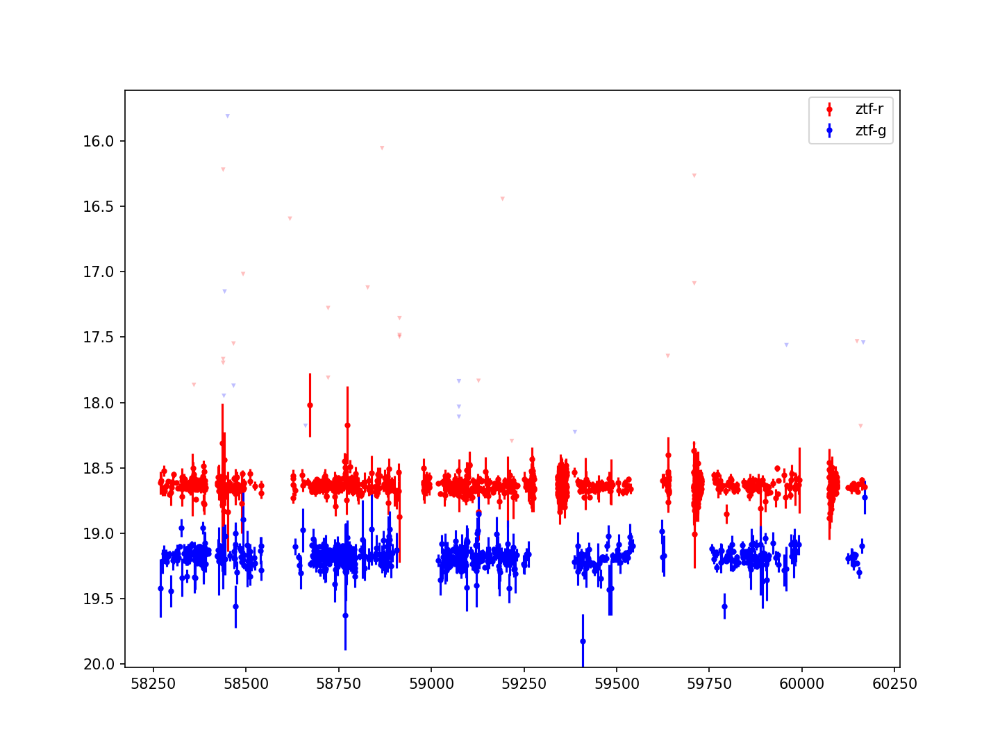

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=11.2033333333333%2C+33.0091666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253666


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


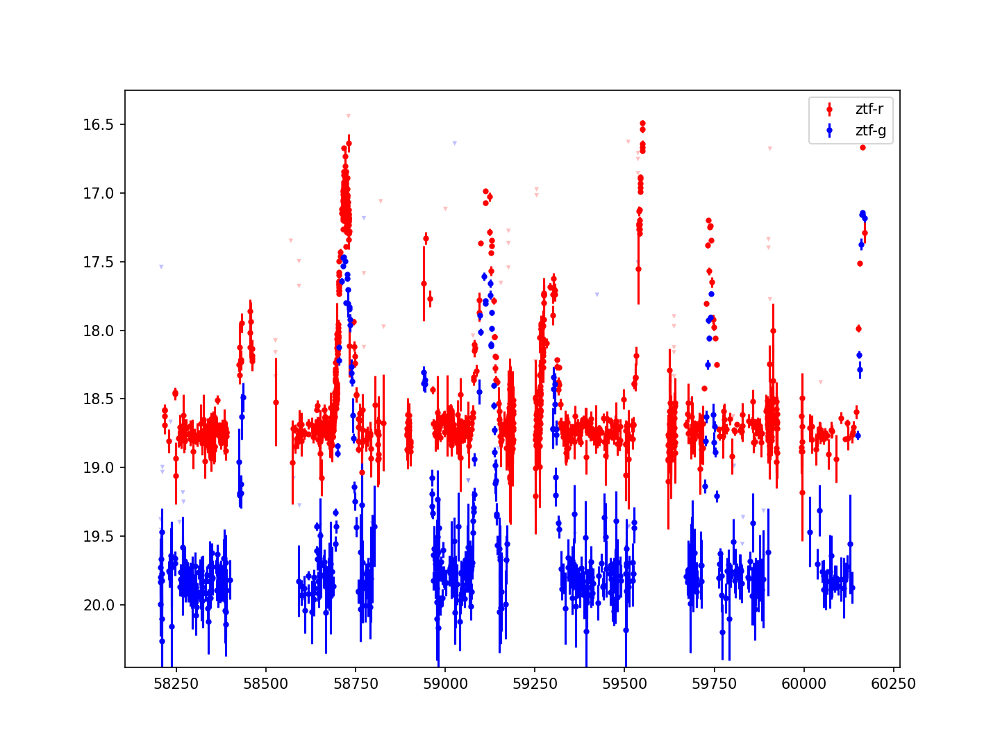

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=287.81625%2C+0.585&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253670


<IPython.core.display.Javascript object>


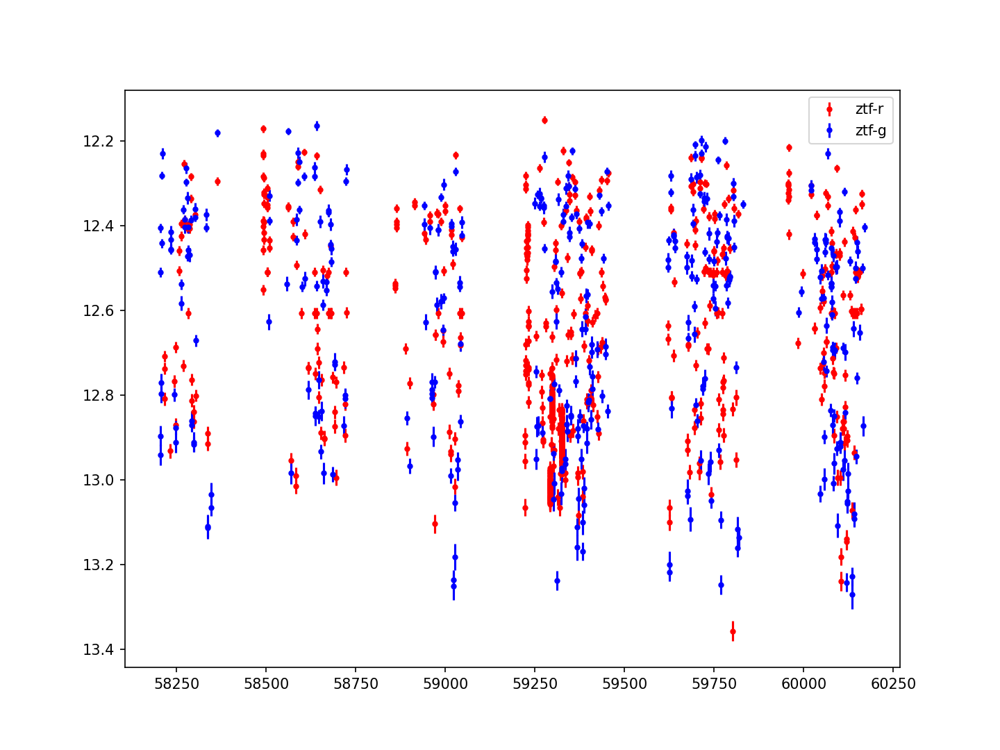

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=244.979166666667%2C+-15.6402777777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253673


<IPython.core.display.Javascript object>


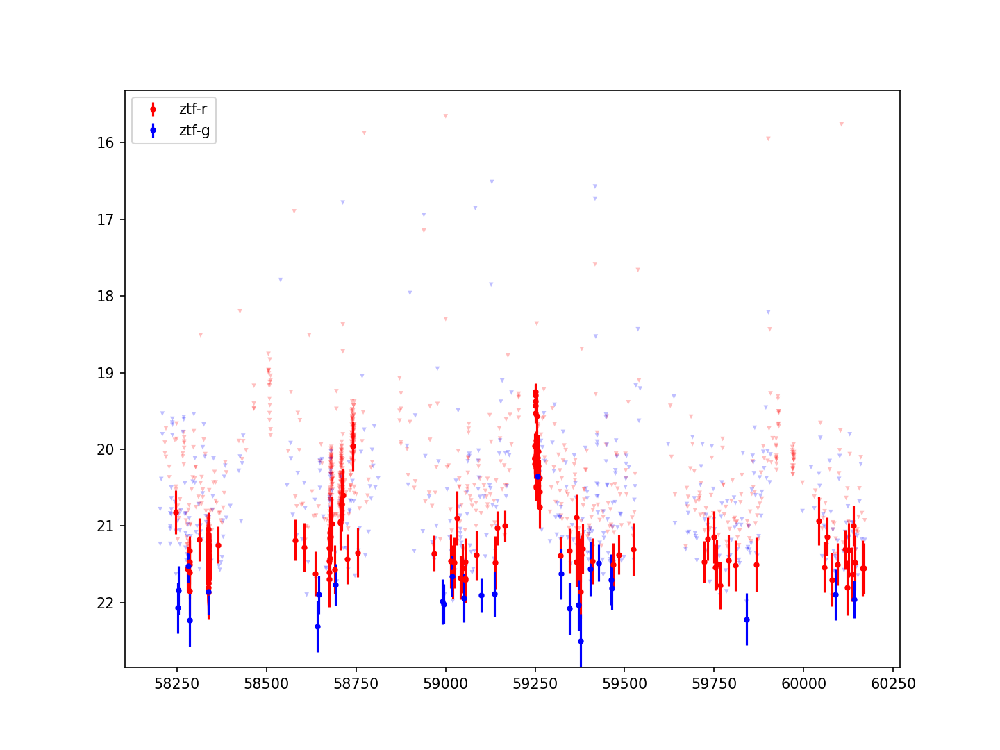

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=284.67375%2C+22.6583333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253679


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


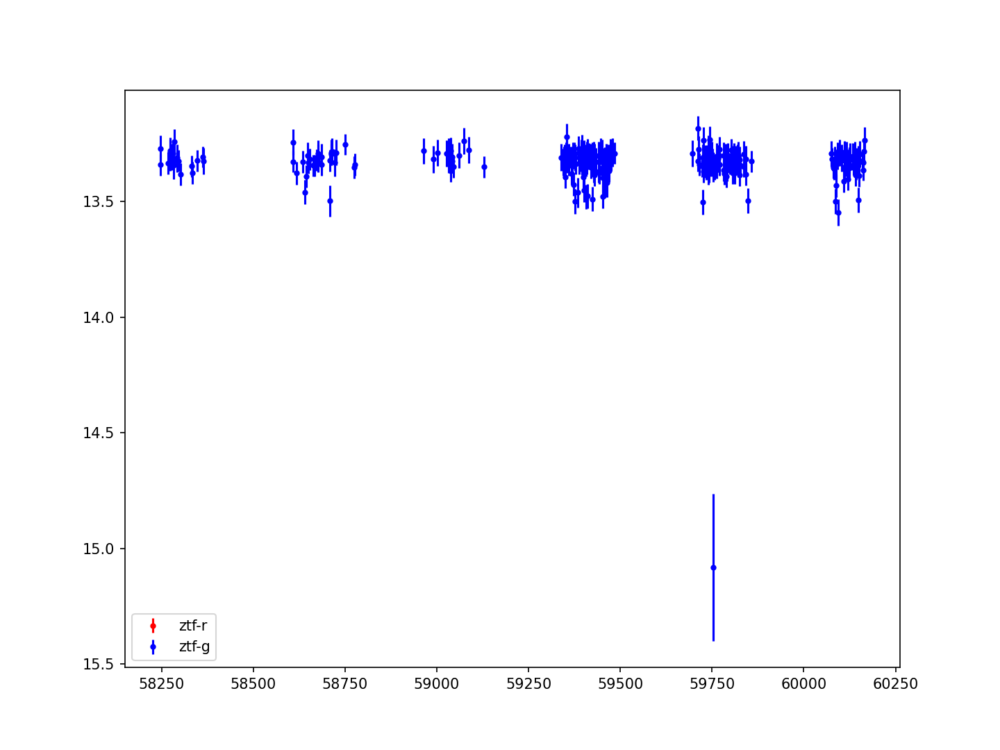

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.135416666667%2C+-24.8688888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253680


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


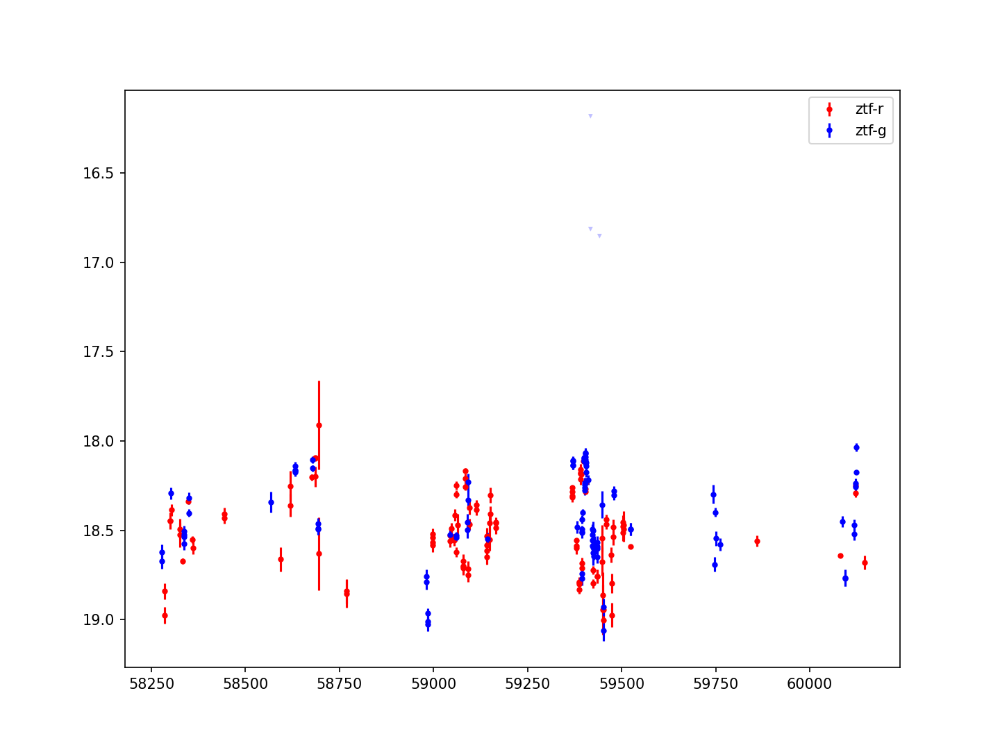

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=299.85%2C+11.7083333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253684


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


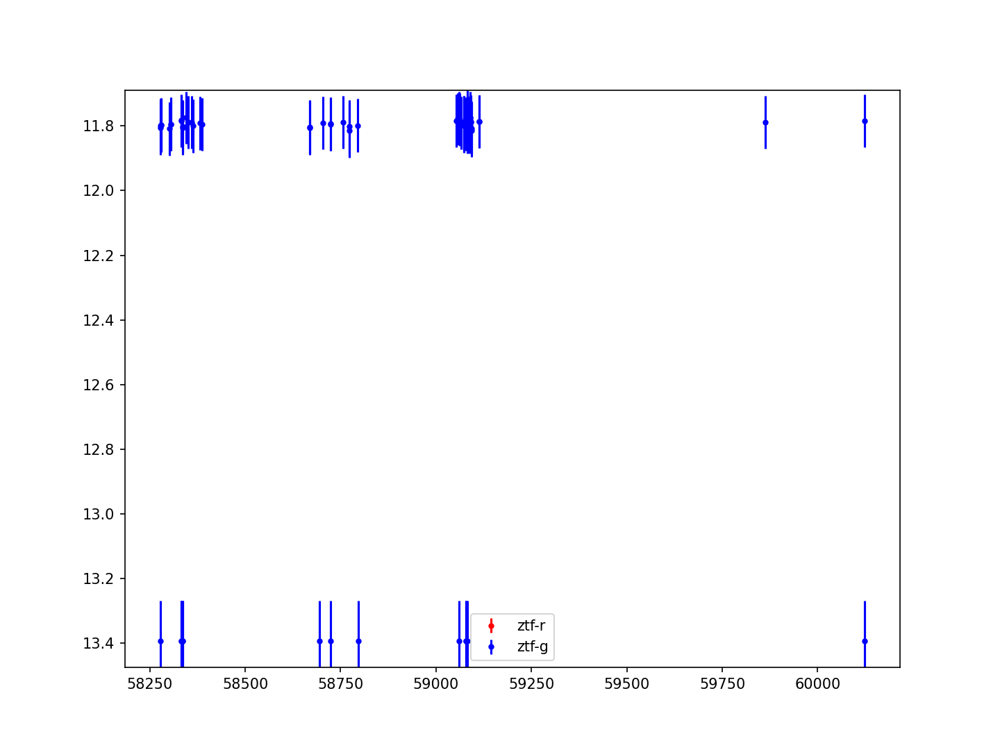

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=322.492916666667%2C+12.1675&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253686


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


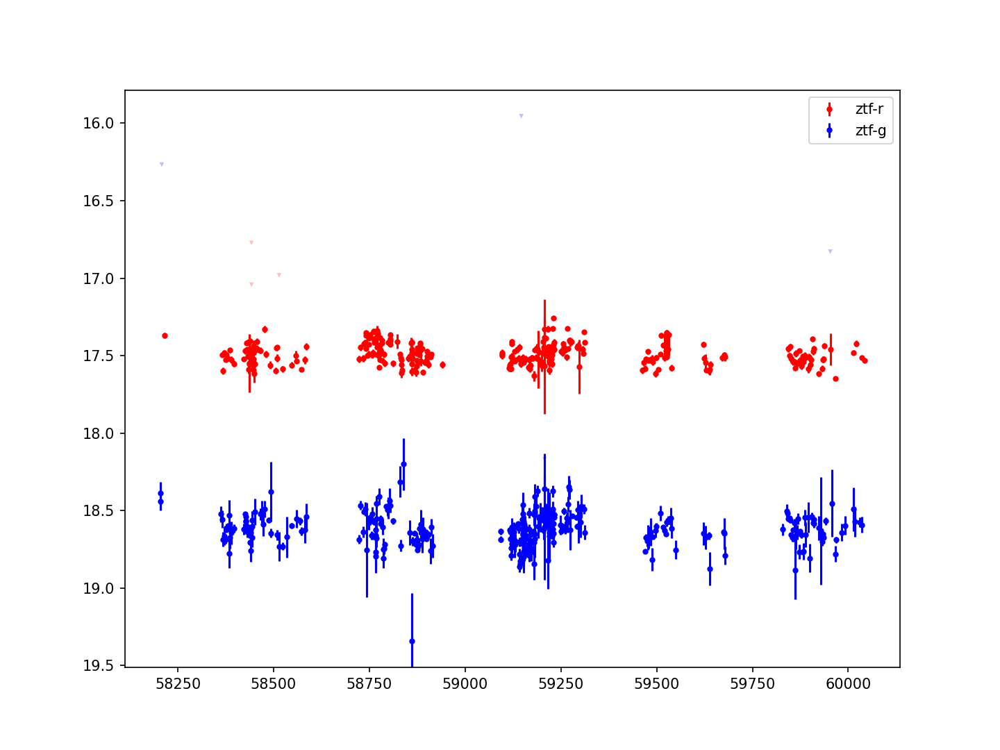

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=95.685%2C+-0.345833333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253687


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


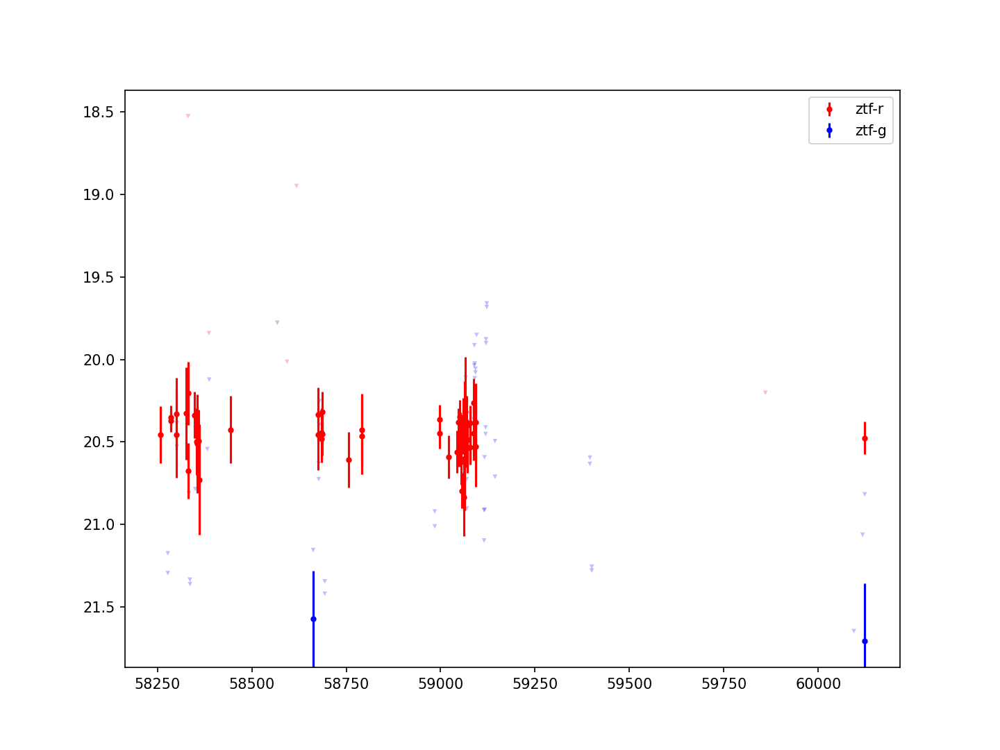

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=300.705833333333%2C+25.2363888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253688


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


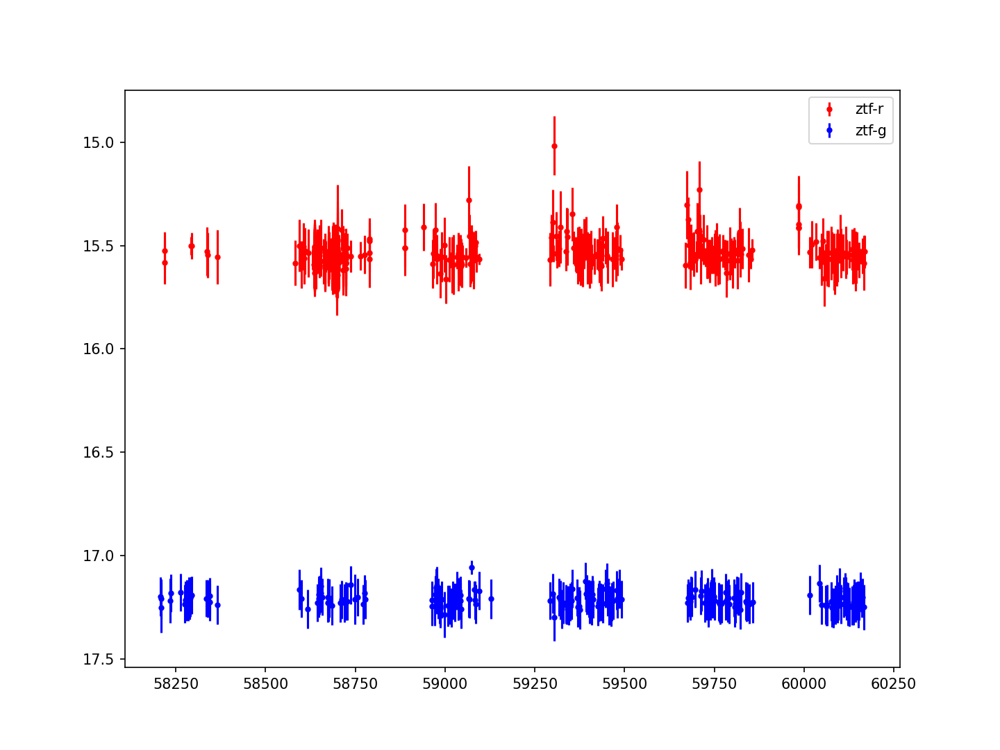

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.2175%2C+-20.3588888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253690


<IPython.core.display.Javascript object>


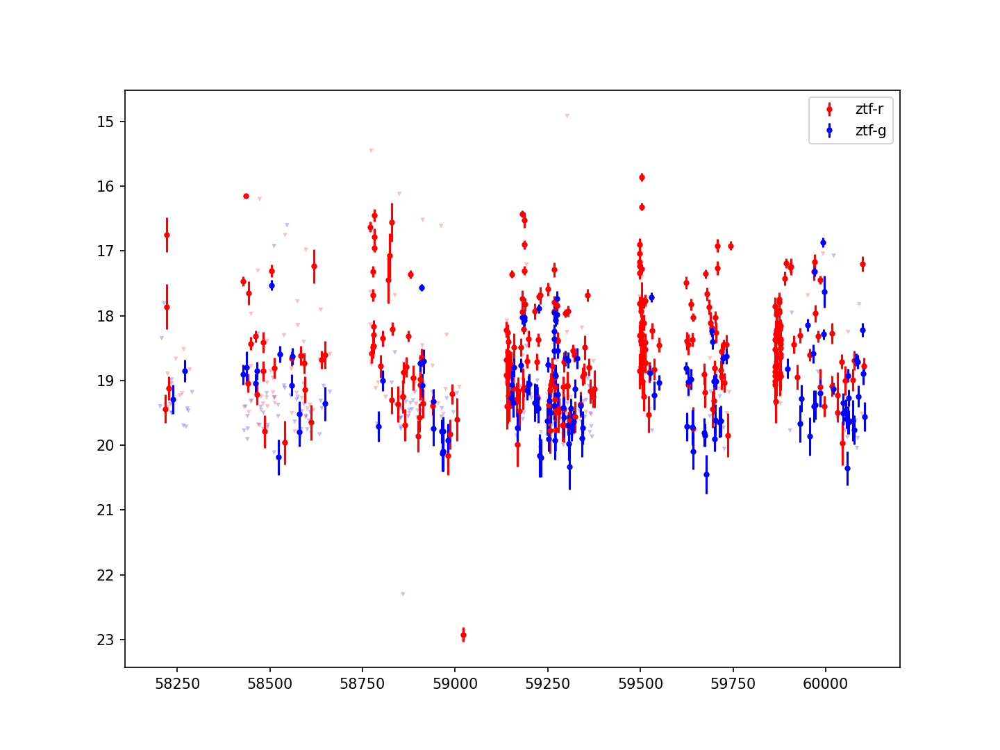

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=161.958333333333%2C+12.5825&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253693


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


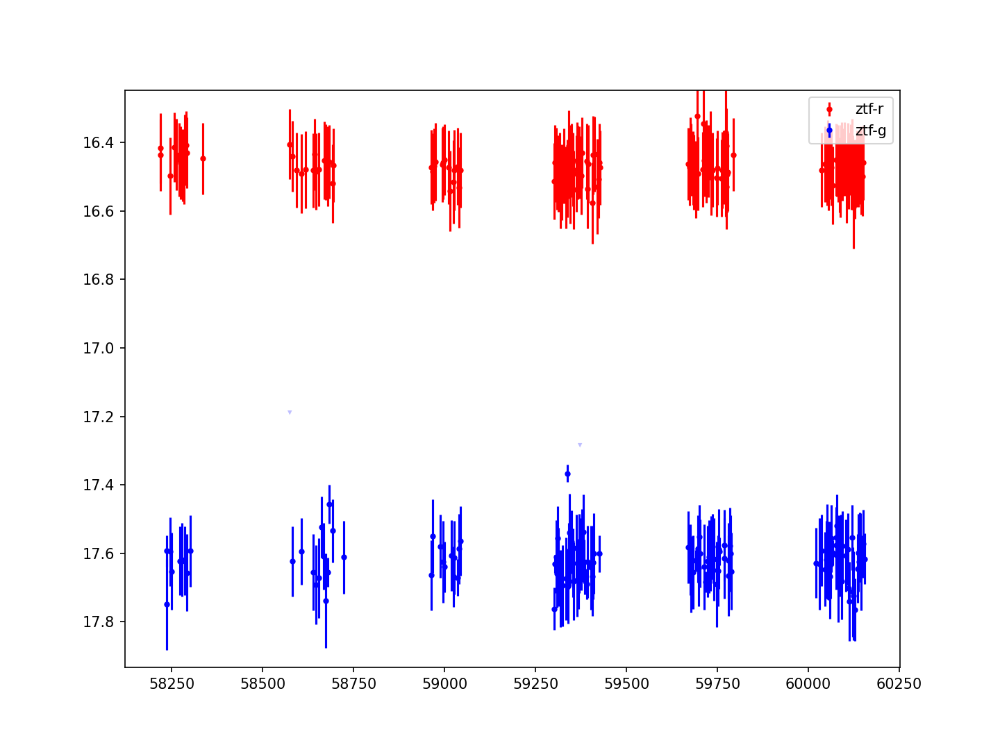

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=245.892083333333%2C+-26.5263888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253695


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


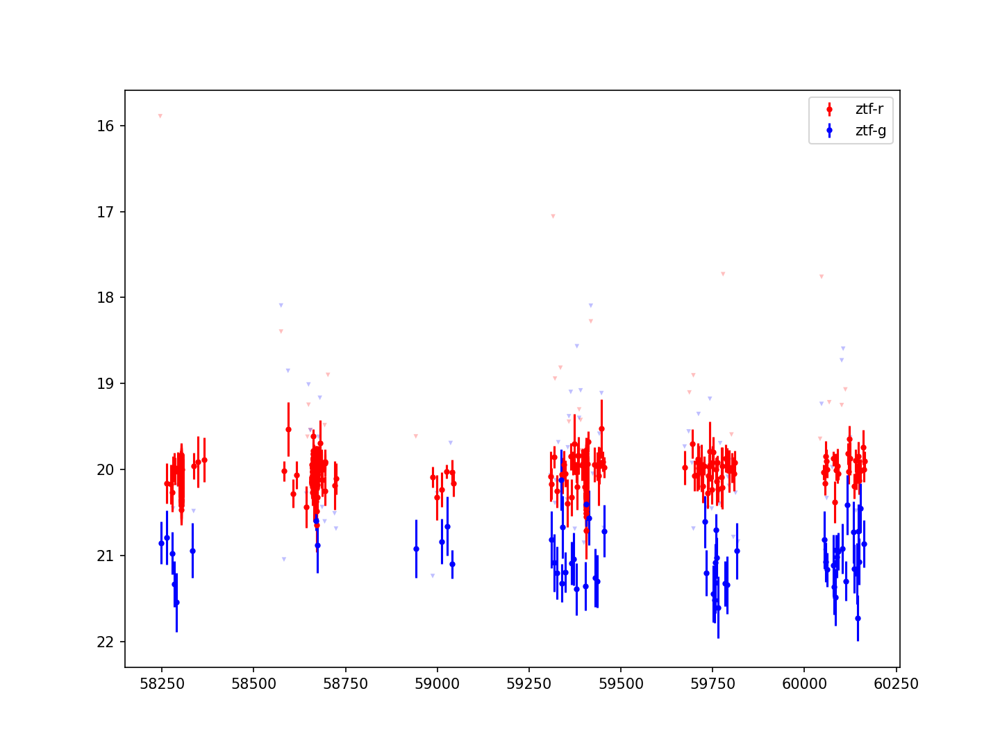

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=257.060416666667%2C+-25.0916666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253698


C:\Users\allis\AppData\Local\Temp\ipykernel_8164\1031086840.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(9.6,7.2))


<IPython.core.display.Javascript object>


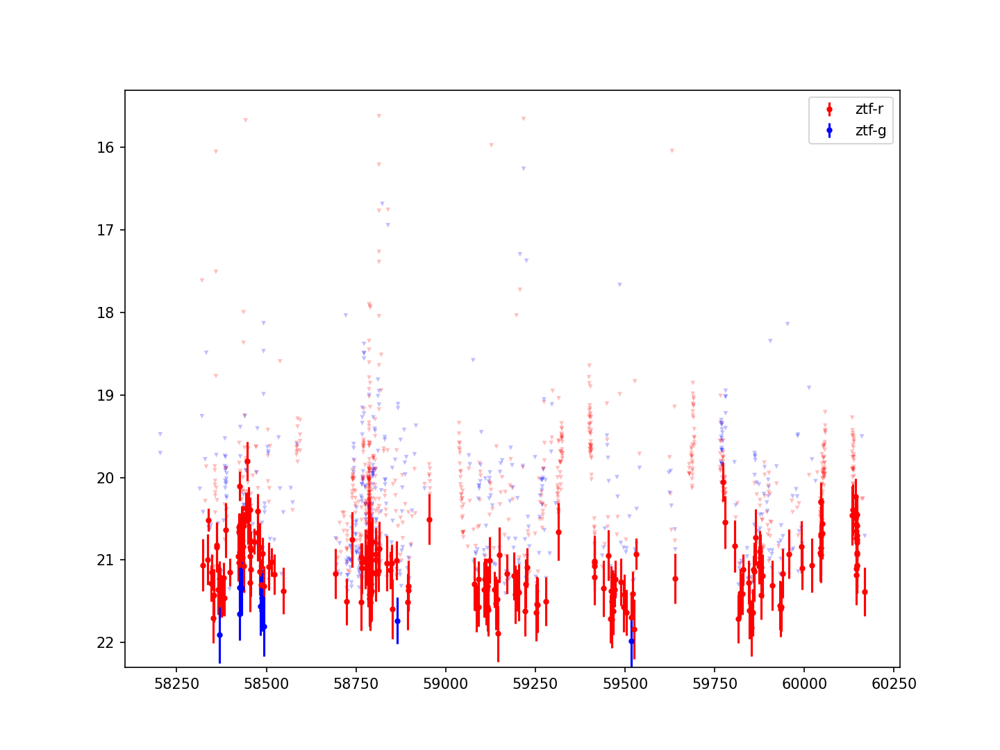

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=65.4283333333333%2C+32.9075&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253699


<IPython.core.display.Javascript object>


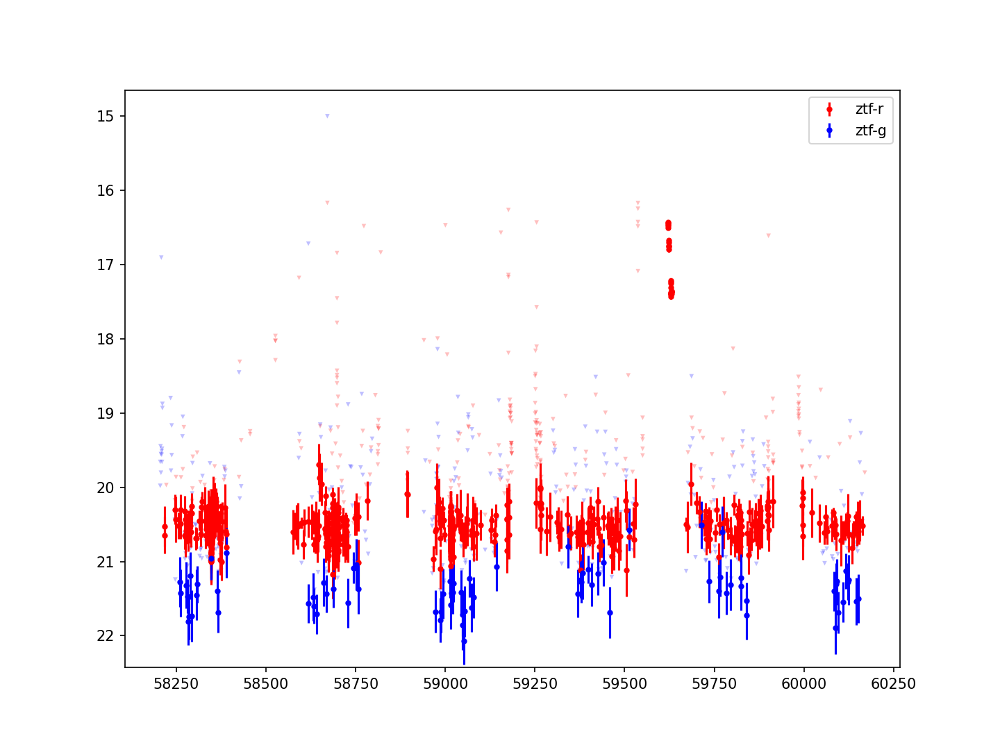

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=287.595%2C+-5.79888888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253702


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


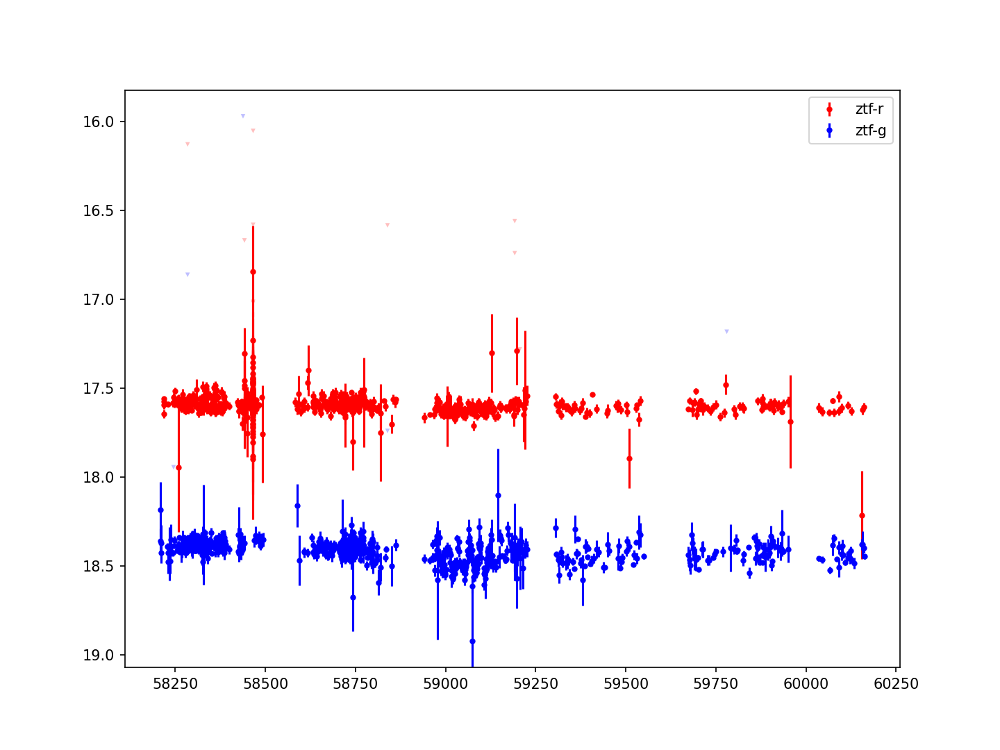

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=322.859166666667%2C+47.2902777777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253703


<IPython.core.display.Javascript object>


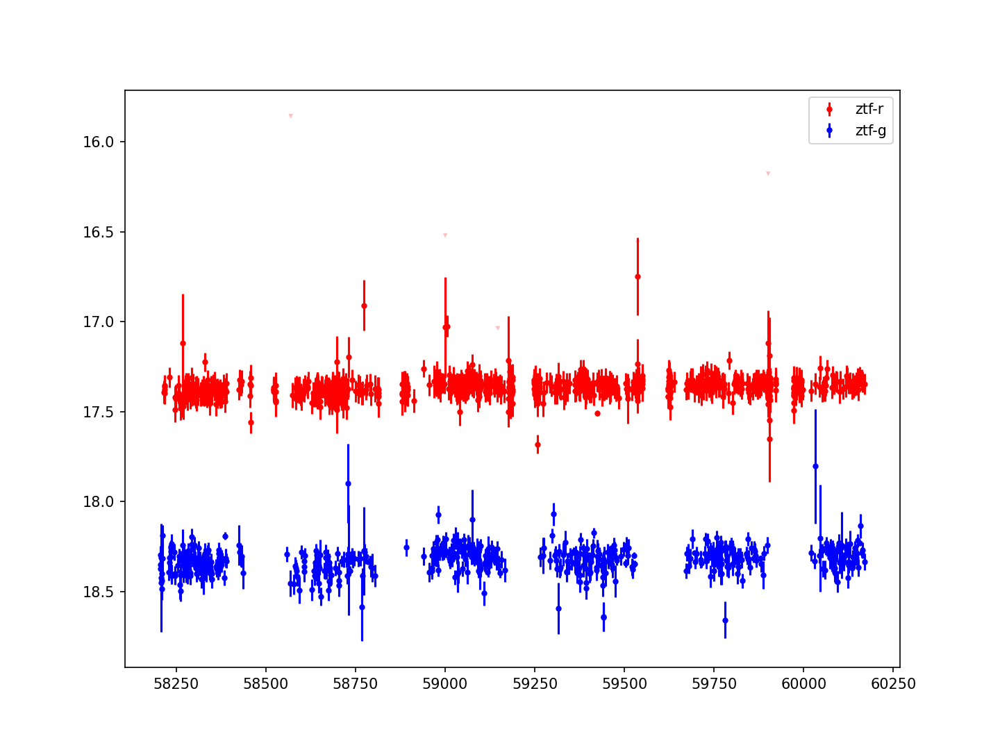

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=279.99%2C+5.03611111111111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253709


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


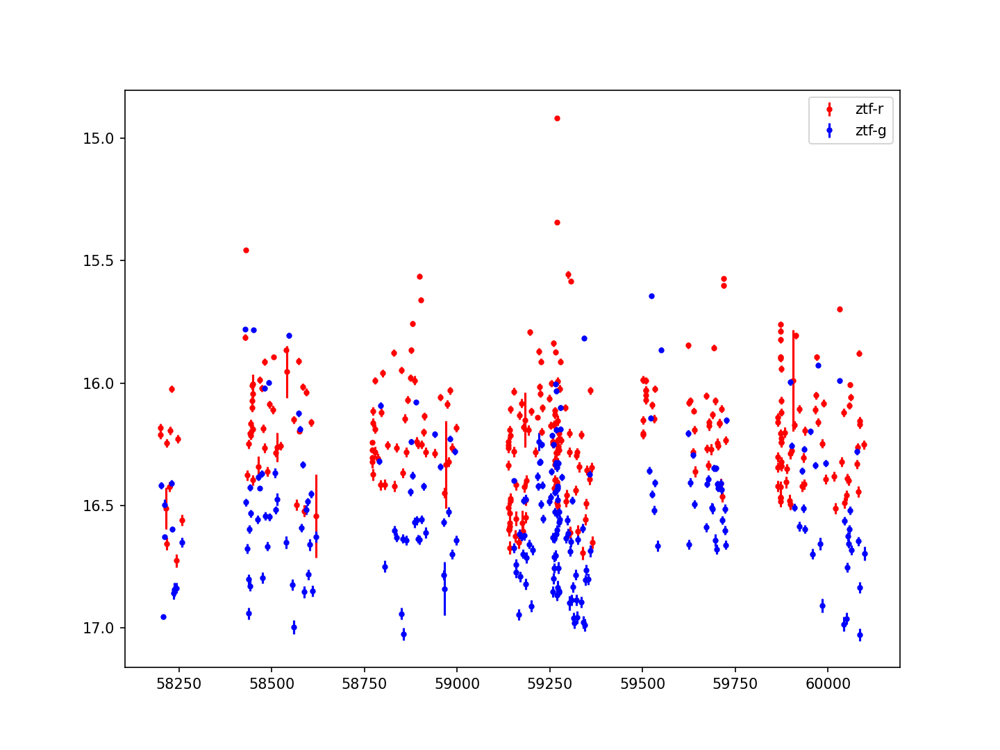

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=155.94875%2C+0.644722222222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253710


<IPython.core.display.Javascript object>


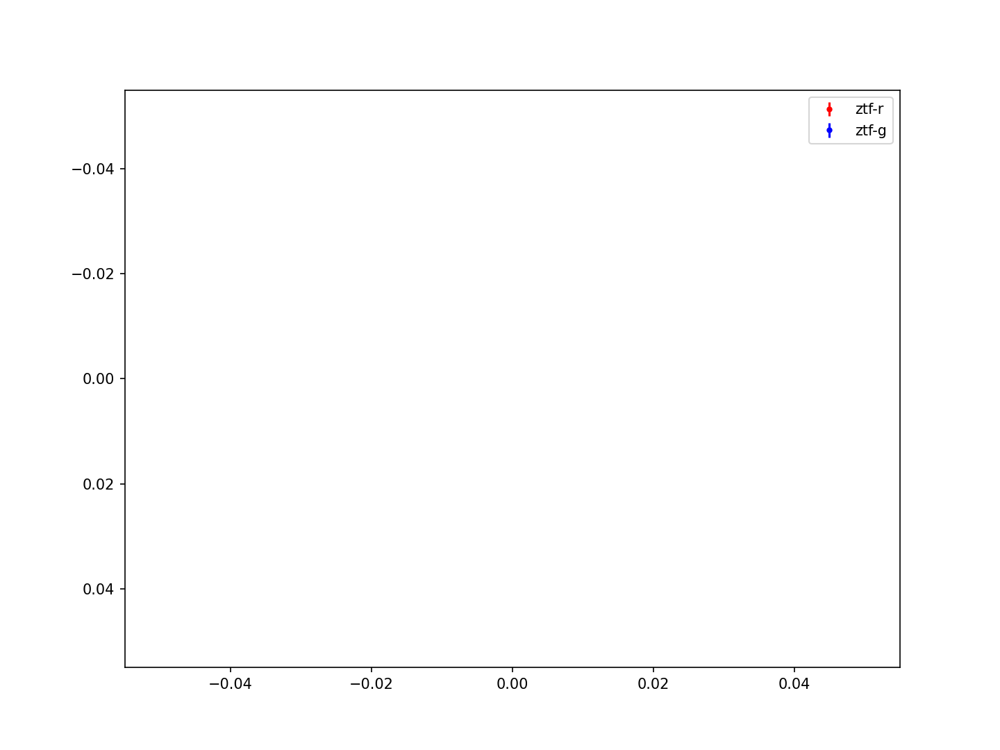

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=285.03625%2C+-24.9205555555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253713


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


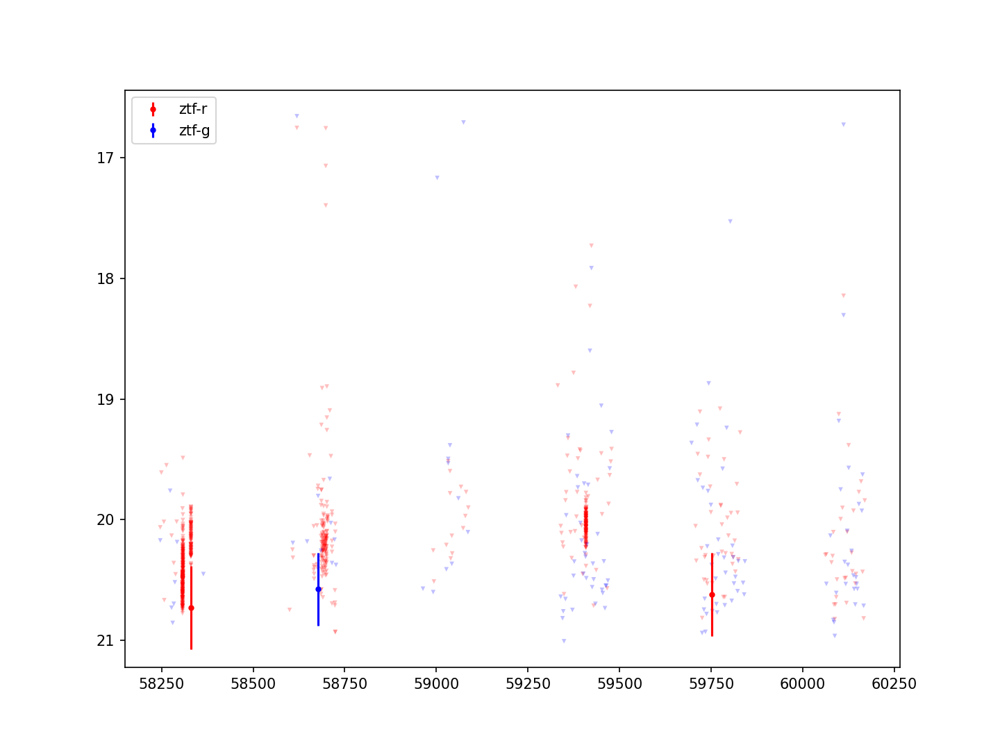

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=269.238333333333%2C+-25.1077777777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253716


<IPython.core.display.Javascript object>


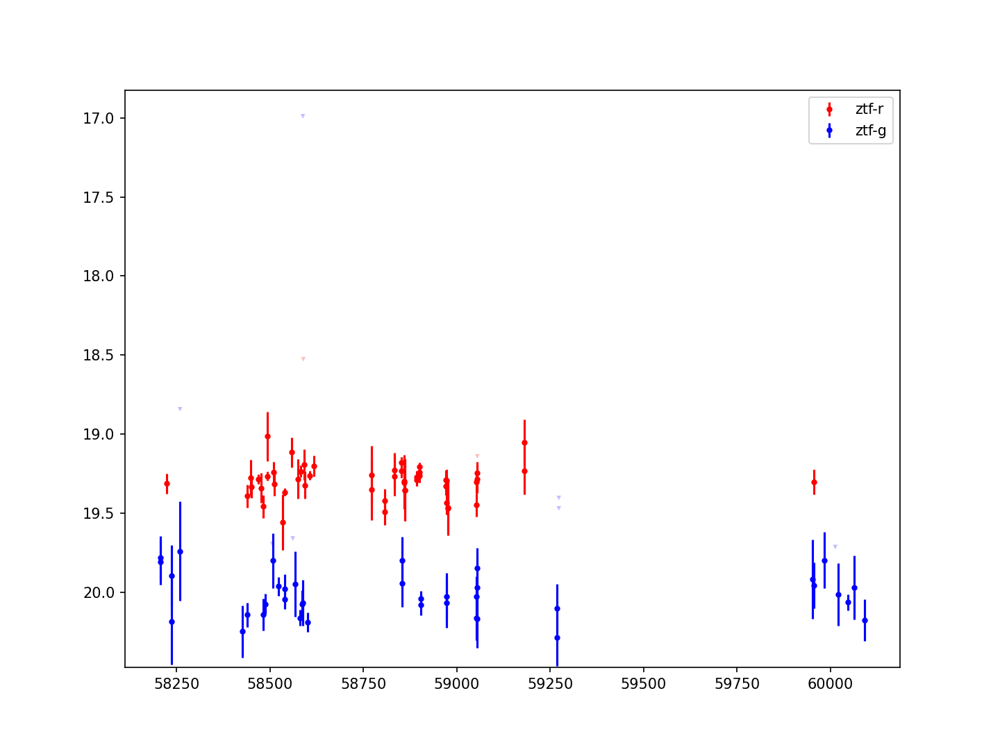

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=169.545416666667%2C+48.0369444444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253717


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


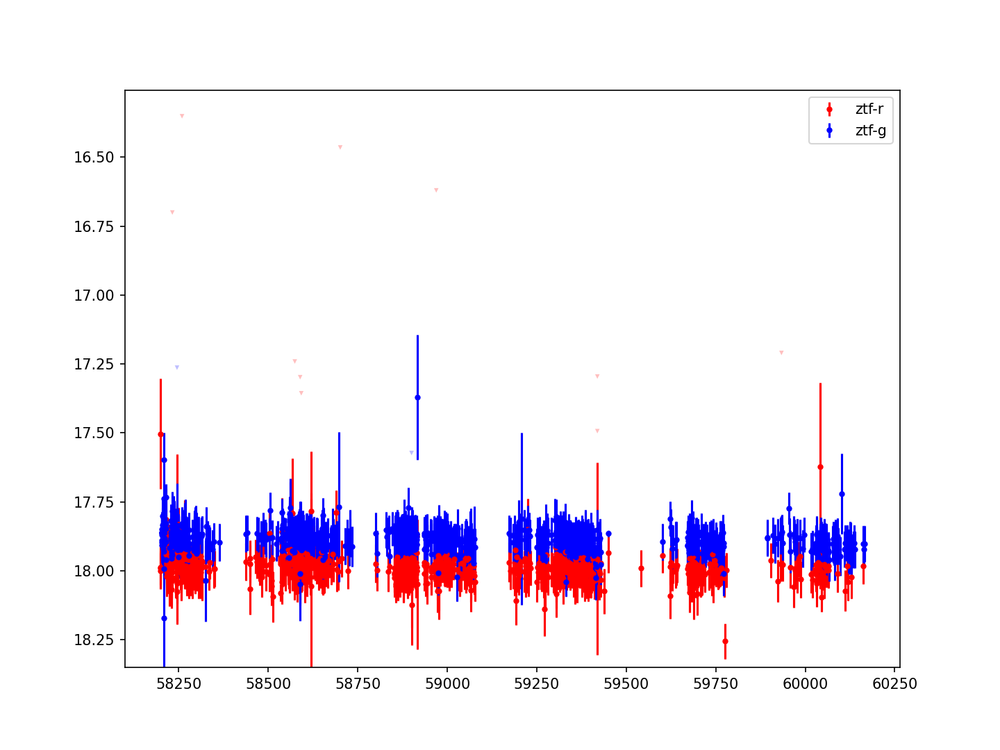

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=202.504166666667%2C+47.2288888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253718


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


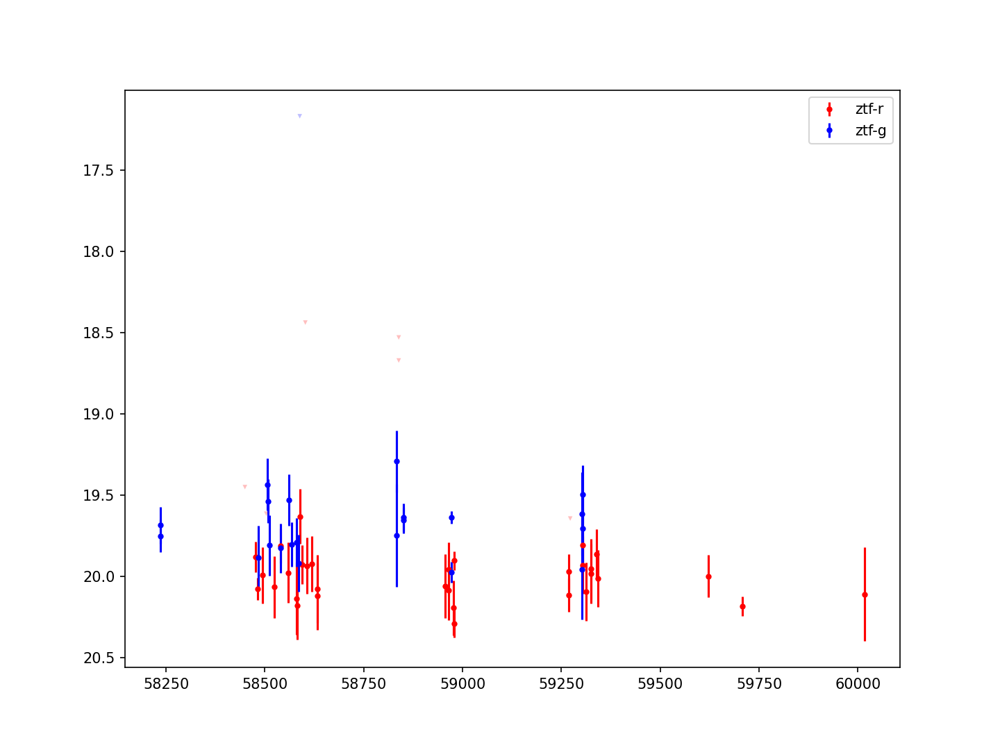

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=190.567083333333%2C+32.5472222222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253721


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


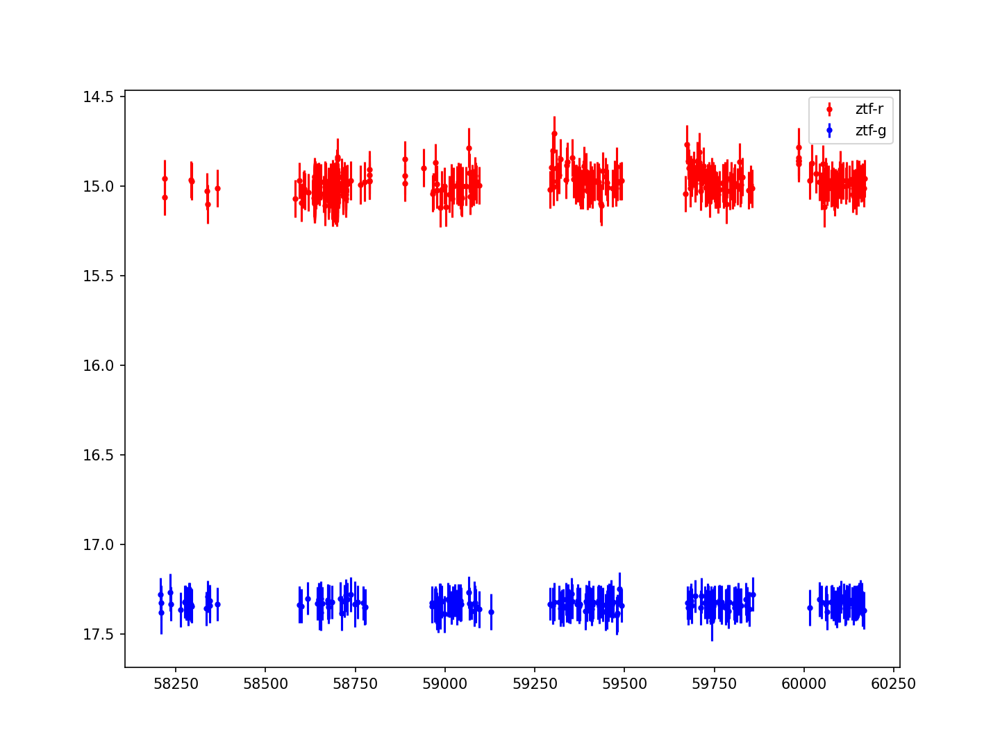

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.22%2C+-20.3566666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253723


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


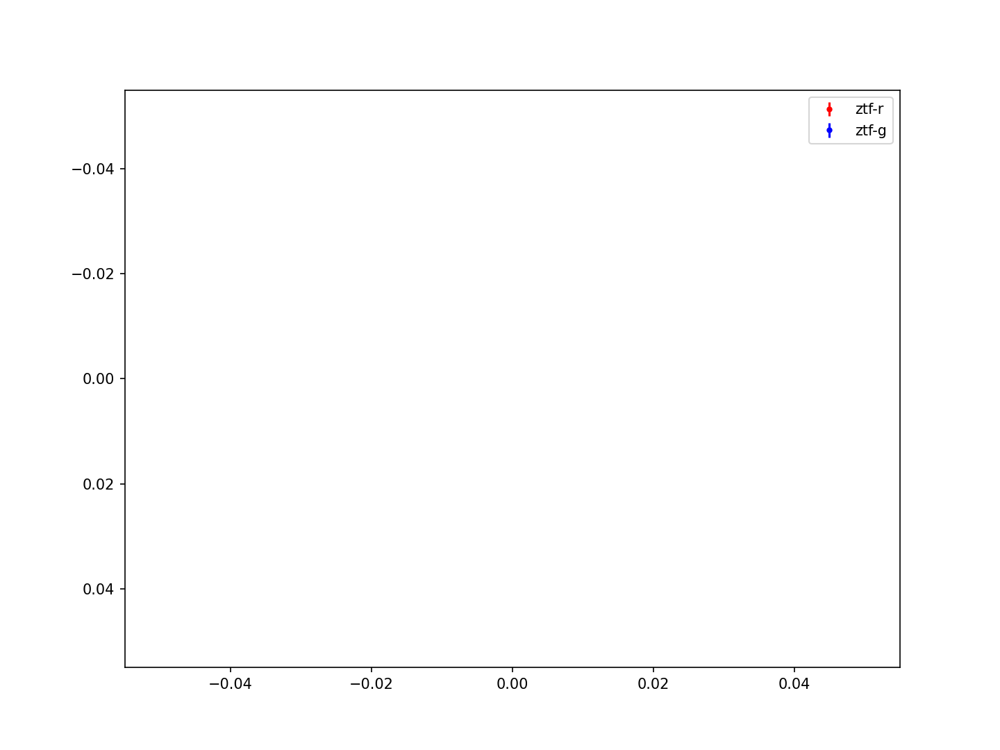

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=262.93375%2C+-16.9613888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253724


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


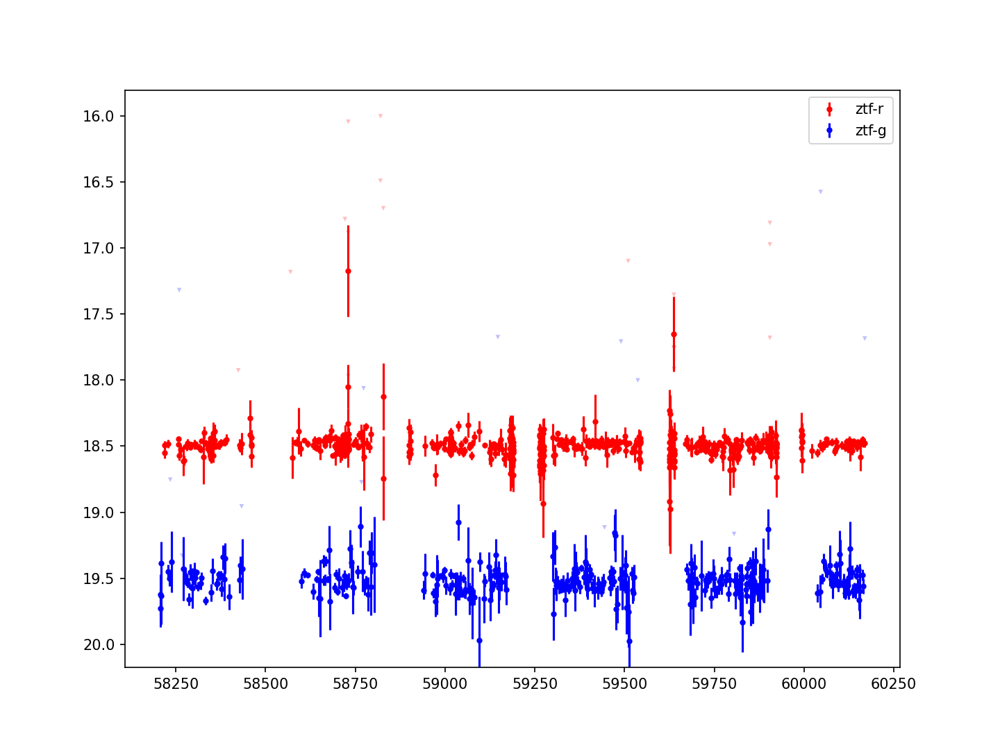

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=289.699166666667%2C+-5.23805555555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253728


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


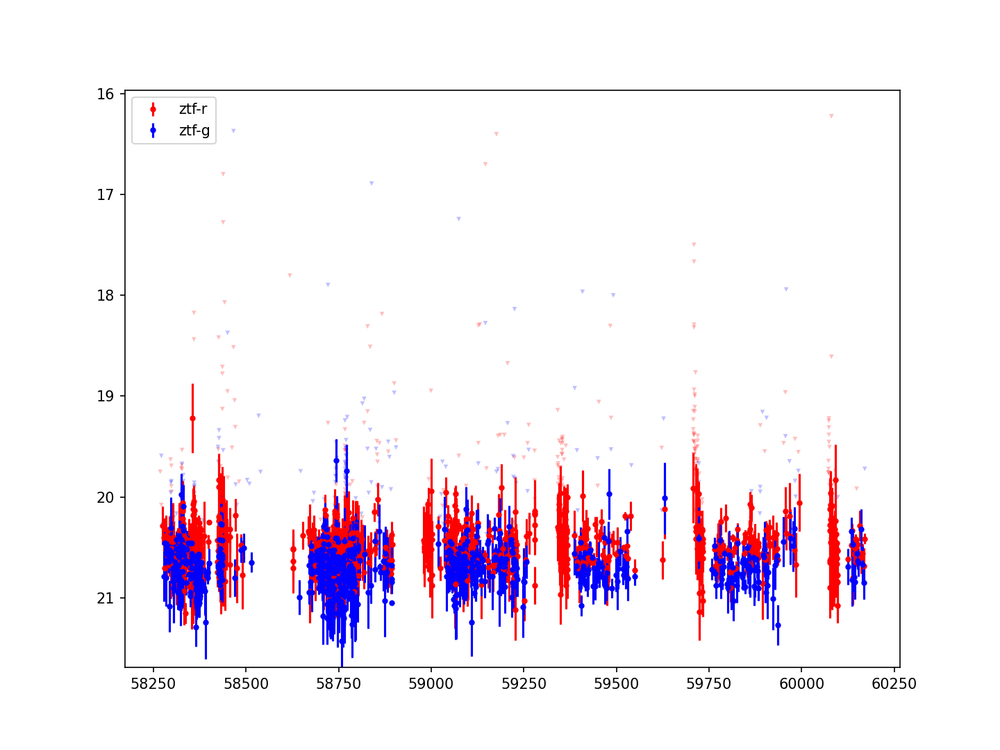

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=10.5320833333333%2C+41.3044444444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253729


<IPython.core.display.Javascript object>


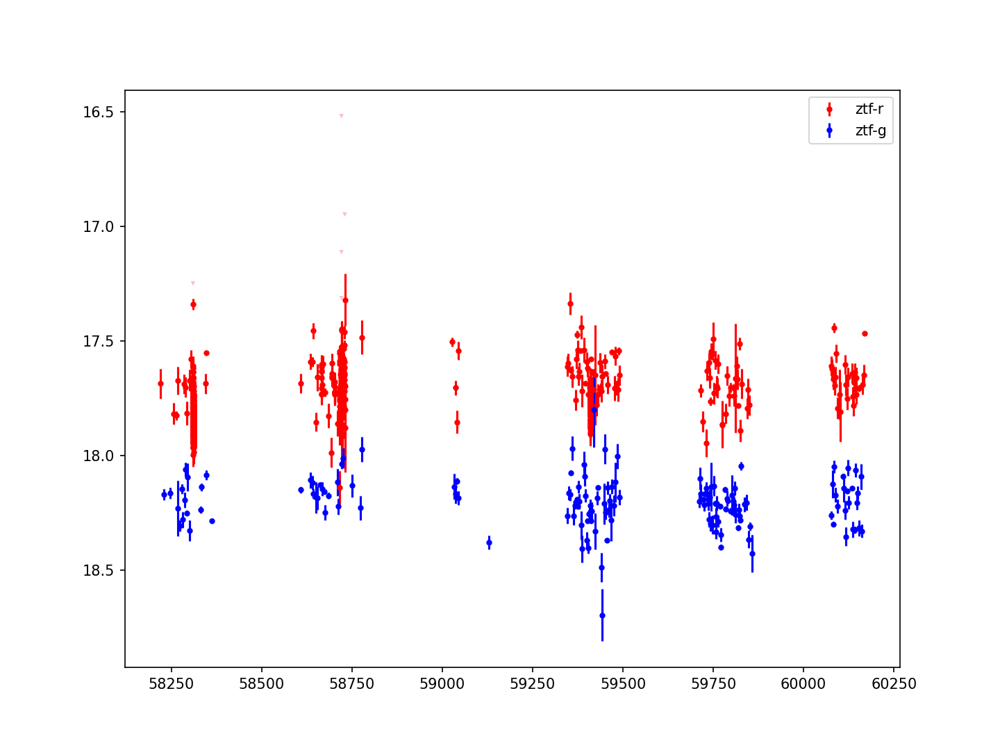

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=277.3675%2C+-23.7969444444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253730


<IPython.core.display.Javascript object>


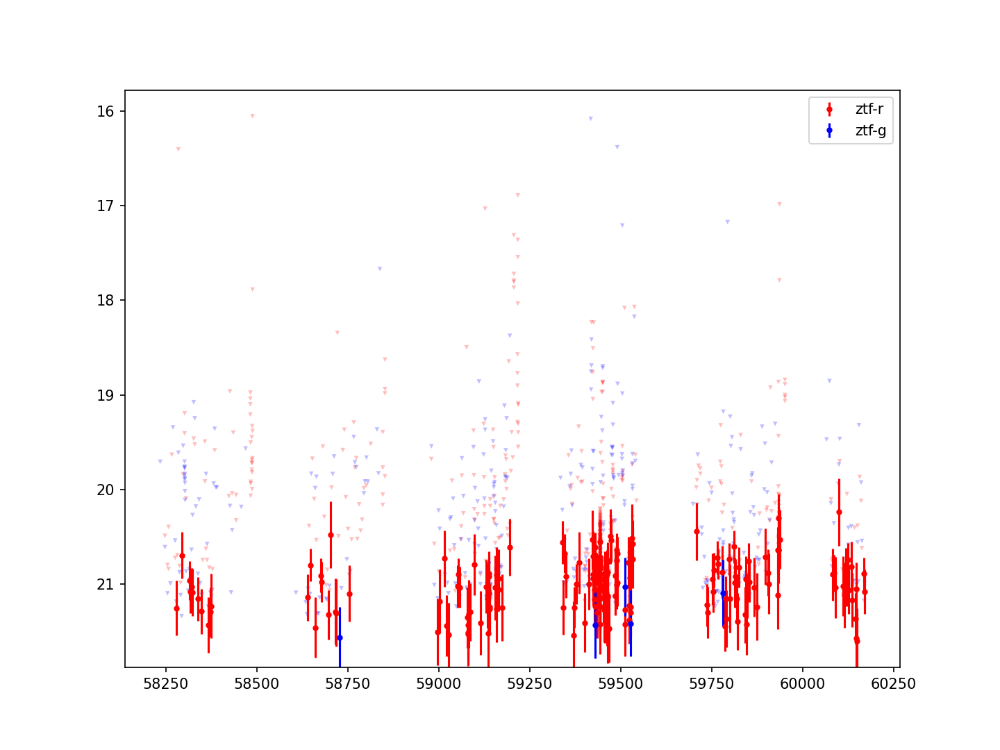

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=320.810416666667%2C+-5.79805555555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253732


<IPython.core.display.Javascript object>


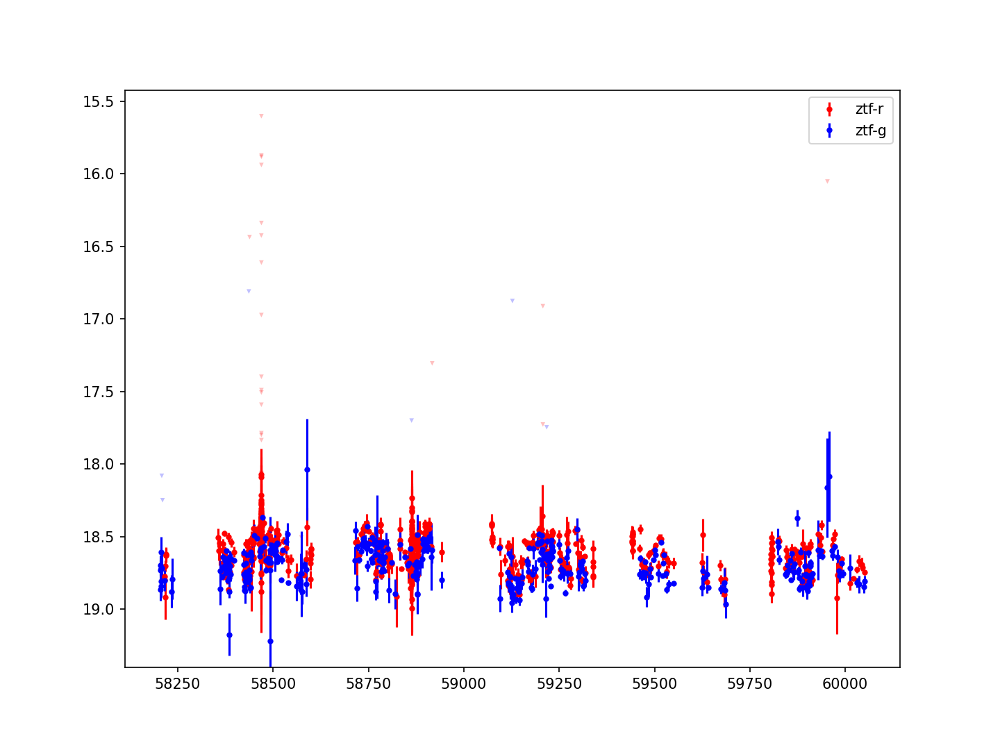

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=94.2804166666667%2C+9.13694444444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253733


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


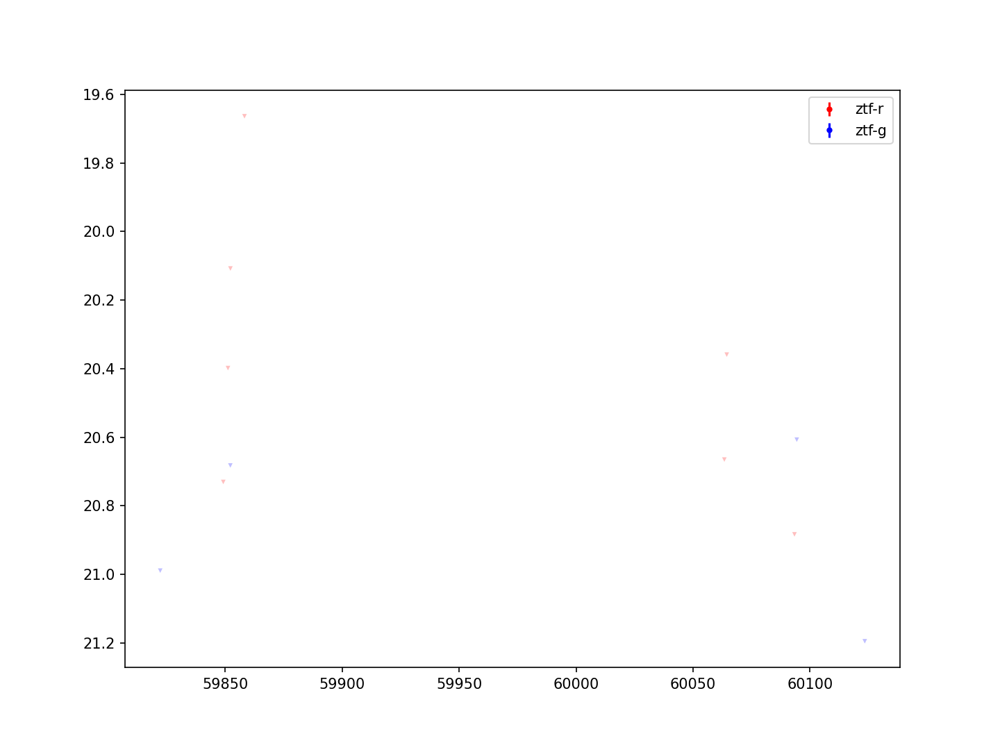

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=268.367916666667%2C+-1.61833333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253734


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


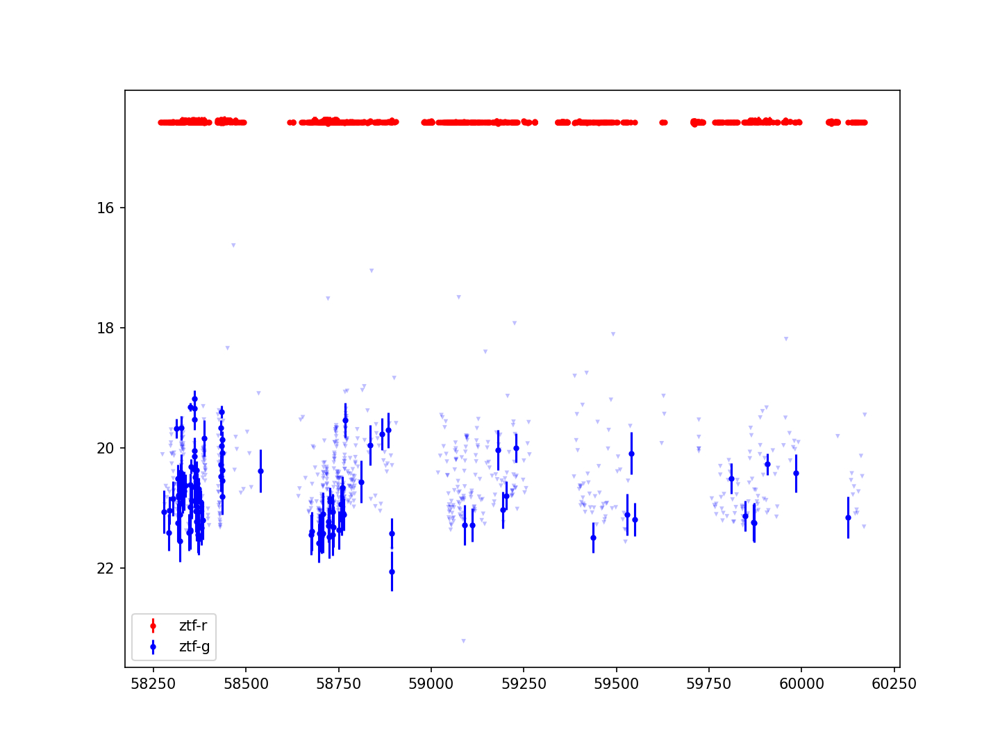

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=10.81%2C+41.1238888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253735


<IPython.core.display.Javascript object>


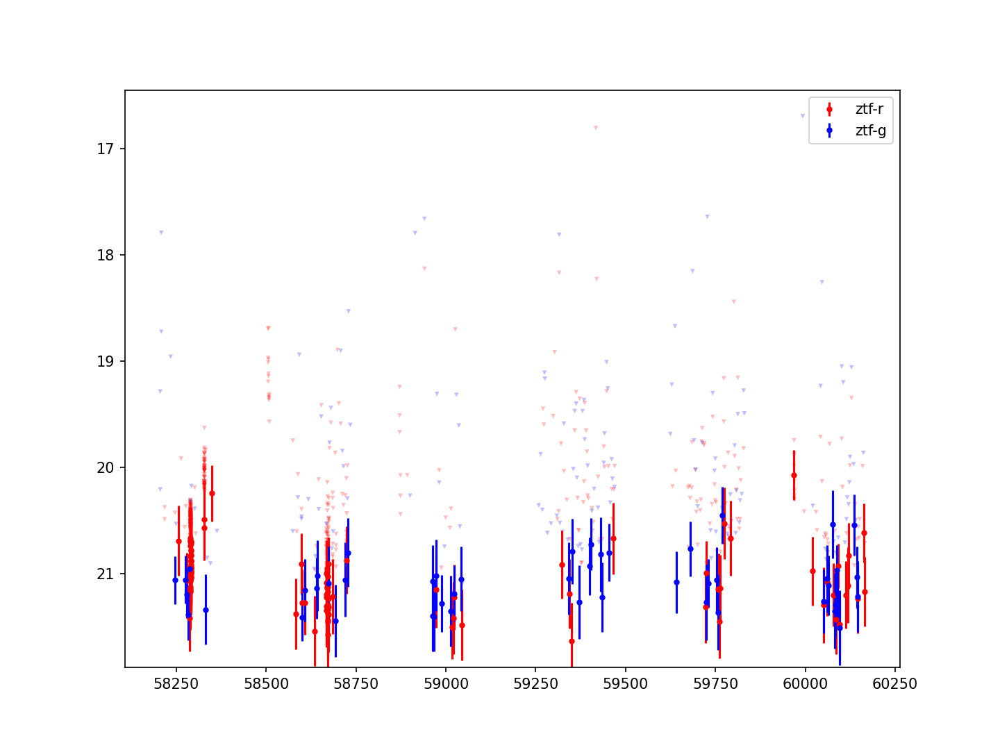

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=254.757083333333%2C+-15.2580555555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253738


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


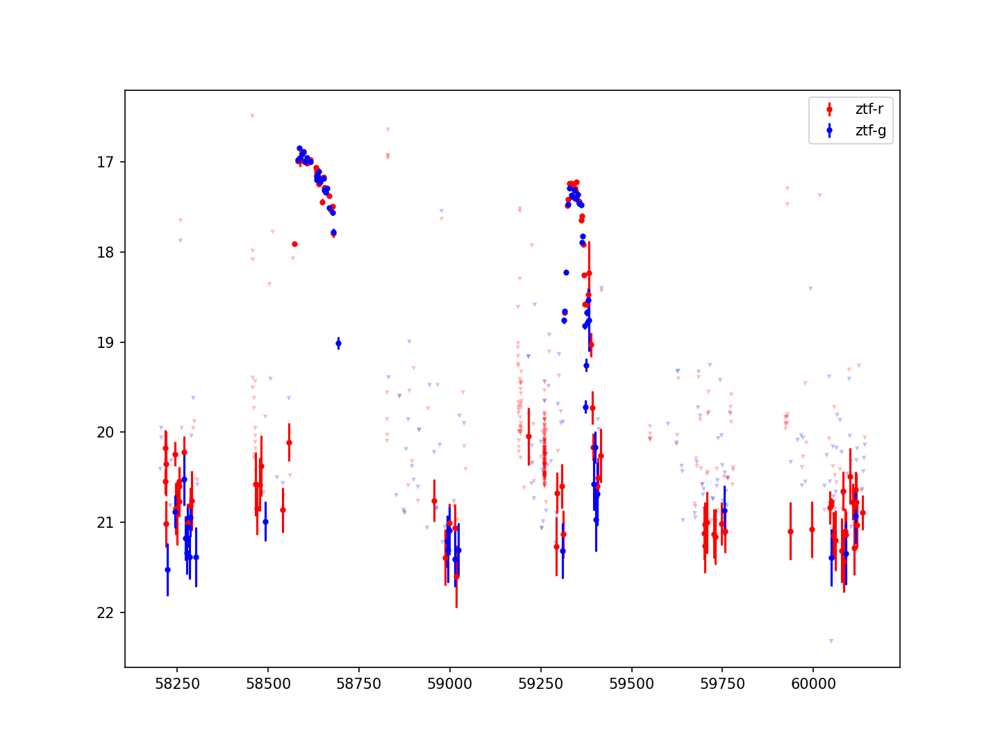

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=209.32%2C+-9.54416666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253740


<IPython.core.display.Javascript object>


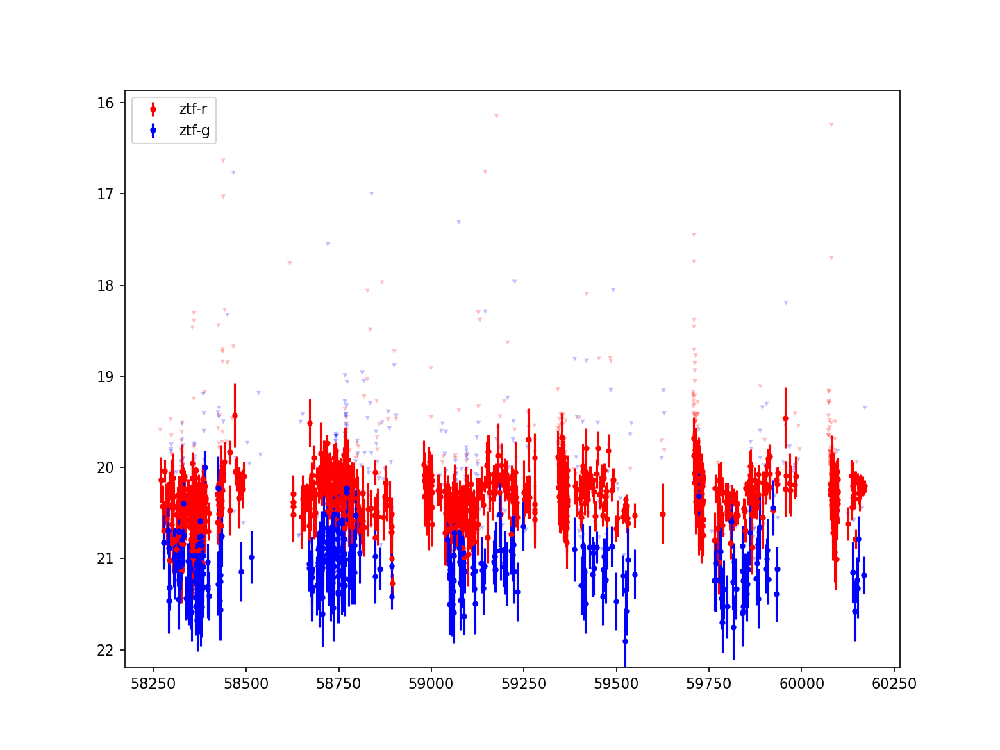

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=10.78625%2C+41.2133333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253742


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


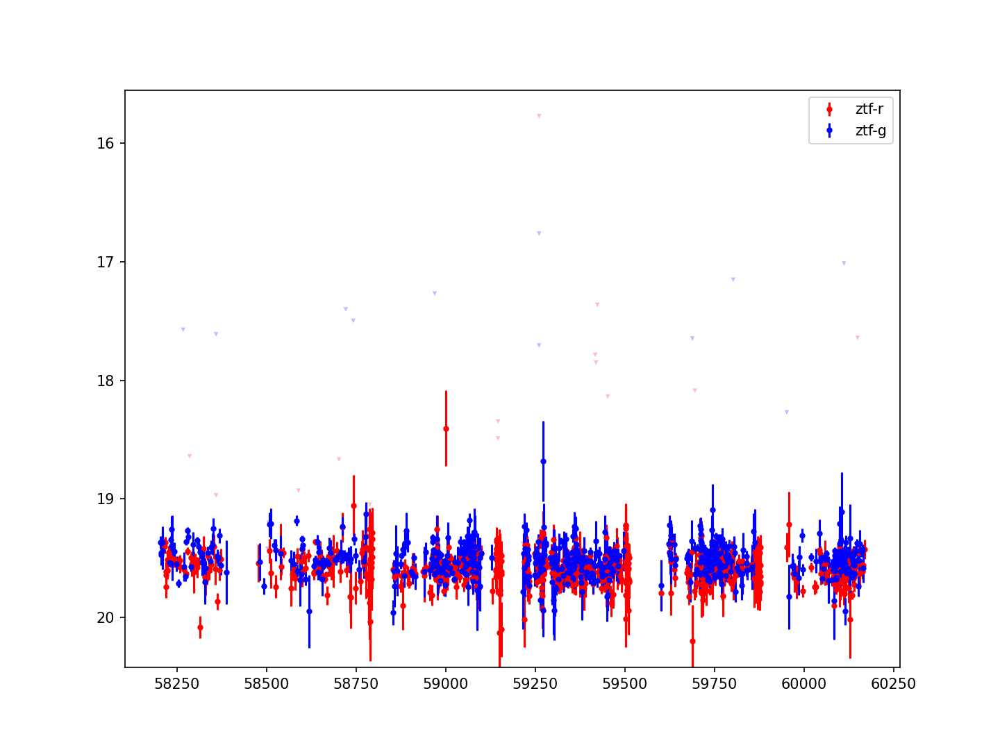

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=241.440416666667%2C+25.8625&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253743


<IPython.core.display.Javascript object>


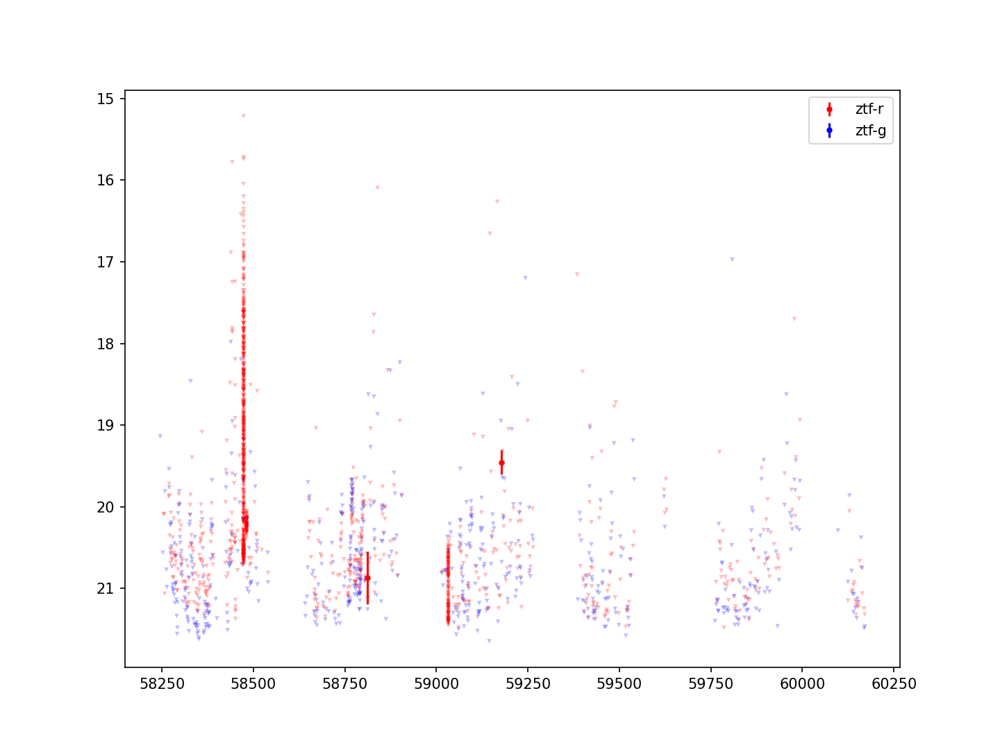

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=7.26291666666667%2C+59.5719444444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253746


<IPython.core.display.Javascript object>


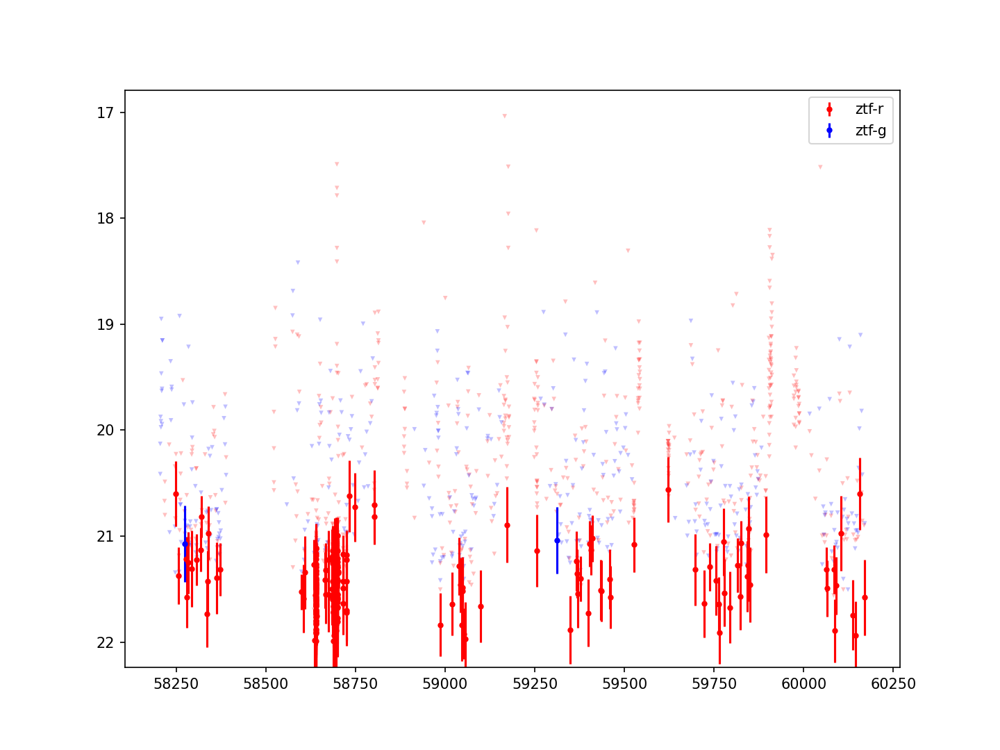

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.341666666667%2C+-0.0122222222222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253748


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


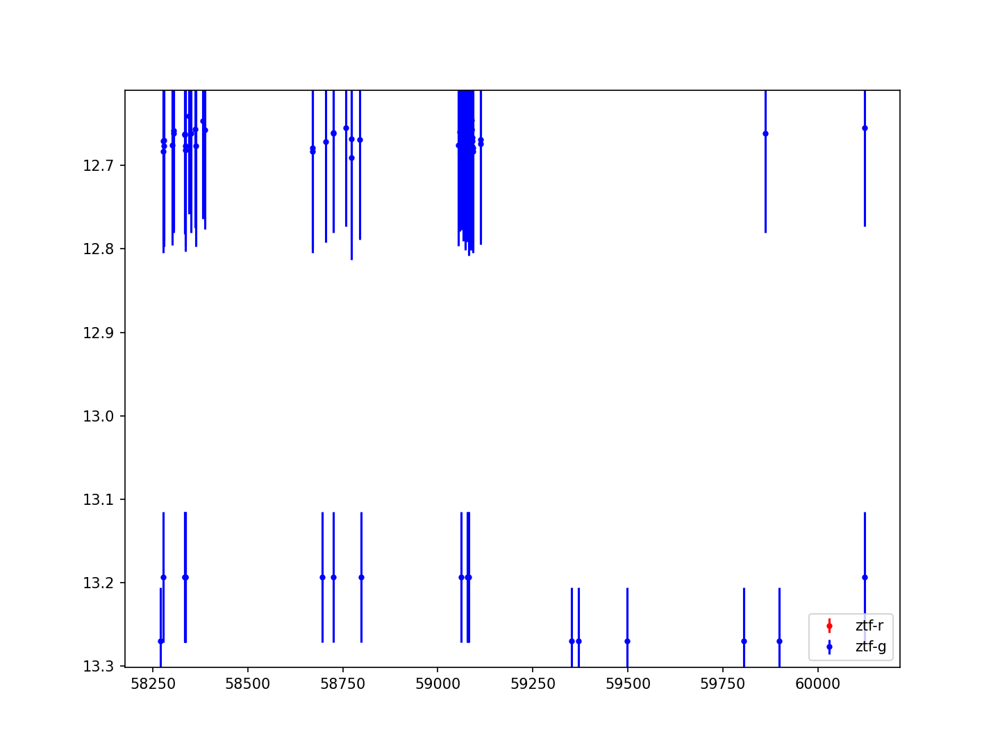

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=322.492083333333%2C+12.1675&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253751


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


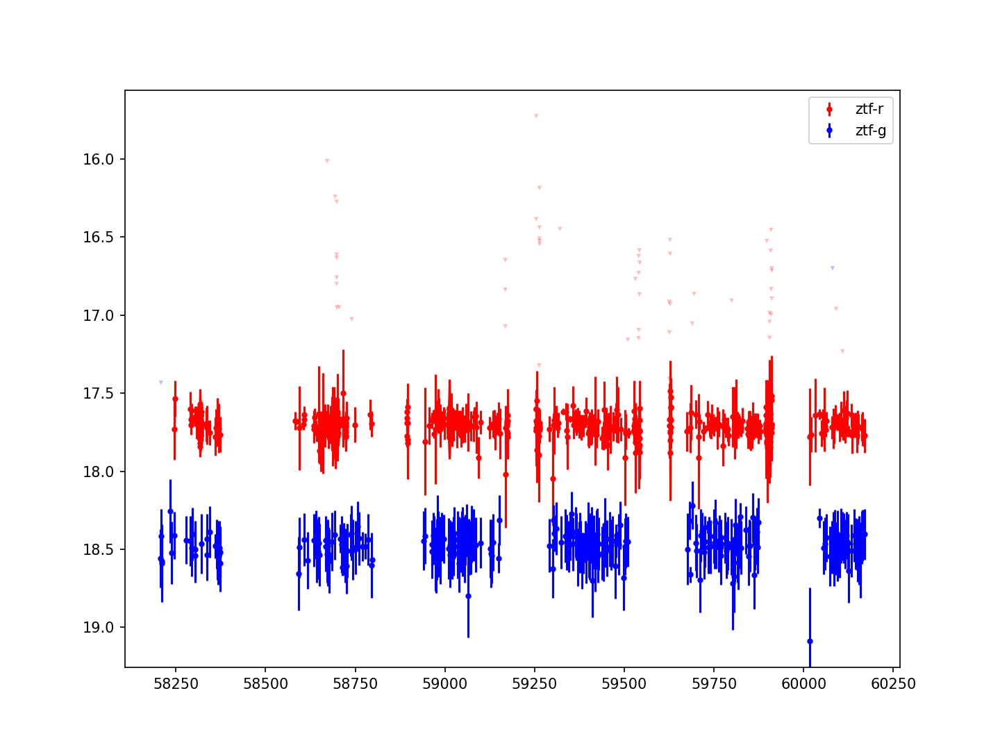

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=283.27%2C+-8.70555555555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253754


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


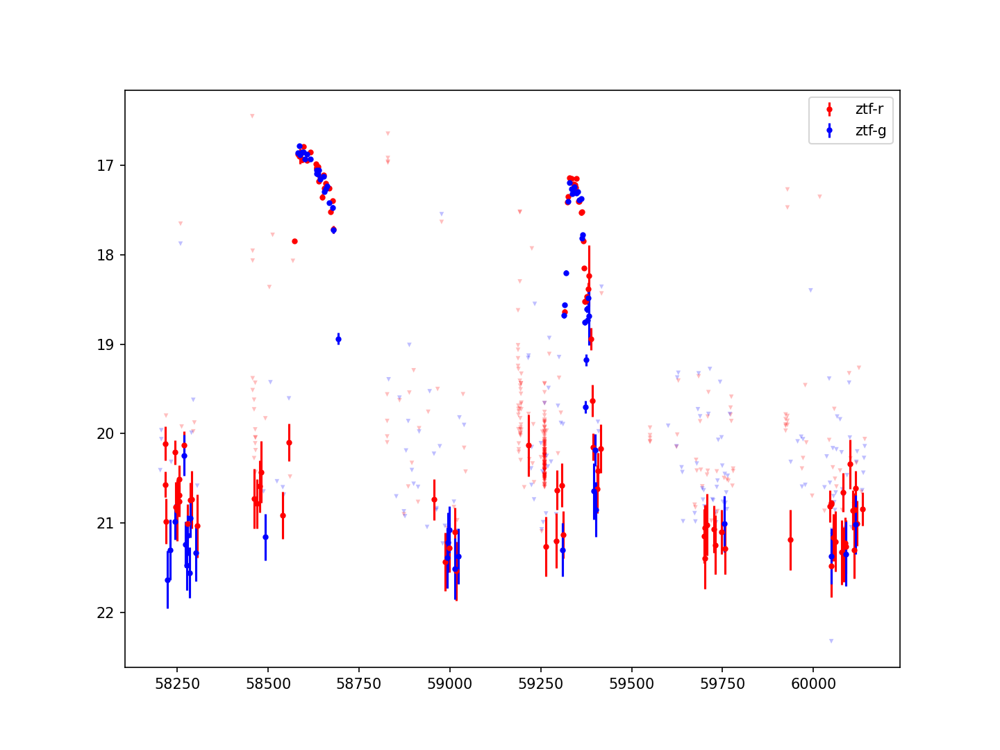

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=209.32014907917%2C+-9.54411013542&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253773


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


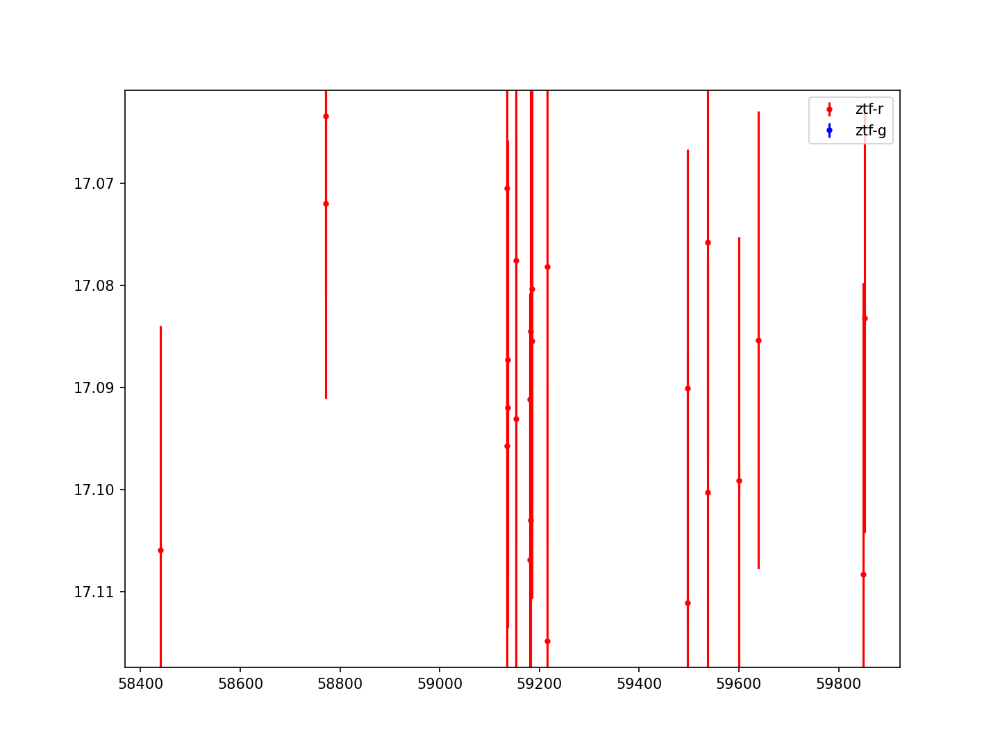

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=108.84116666667%2C+-19.26805555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253781


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


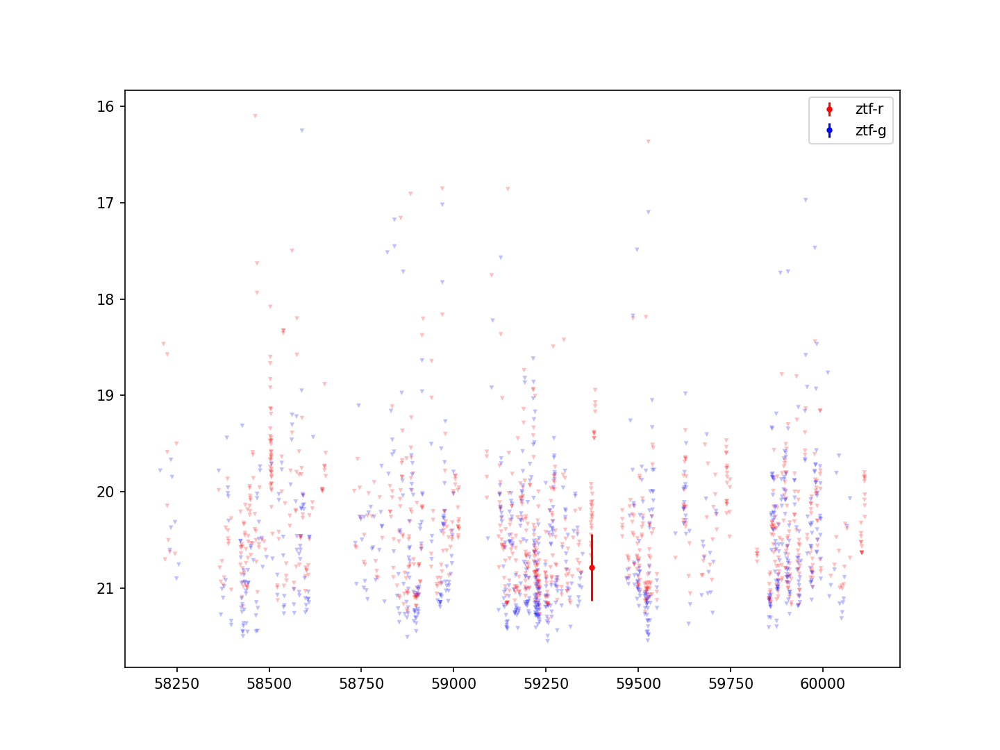

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=128.98333333333%2C+51.31&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253784


<IPython.core.display.Javascript object>


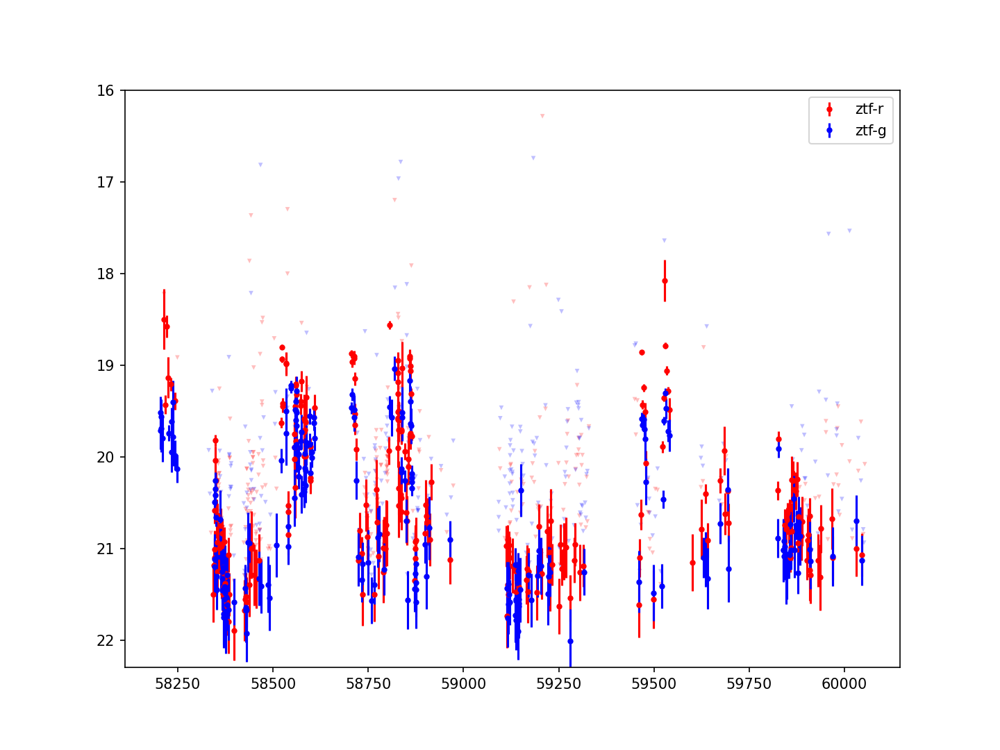

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=93.09427917906%2C+70.21198234664&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253788


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


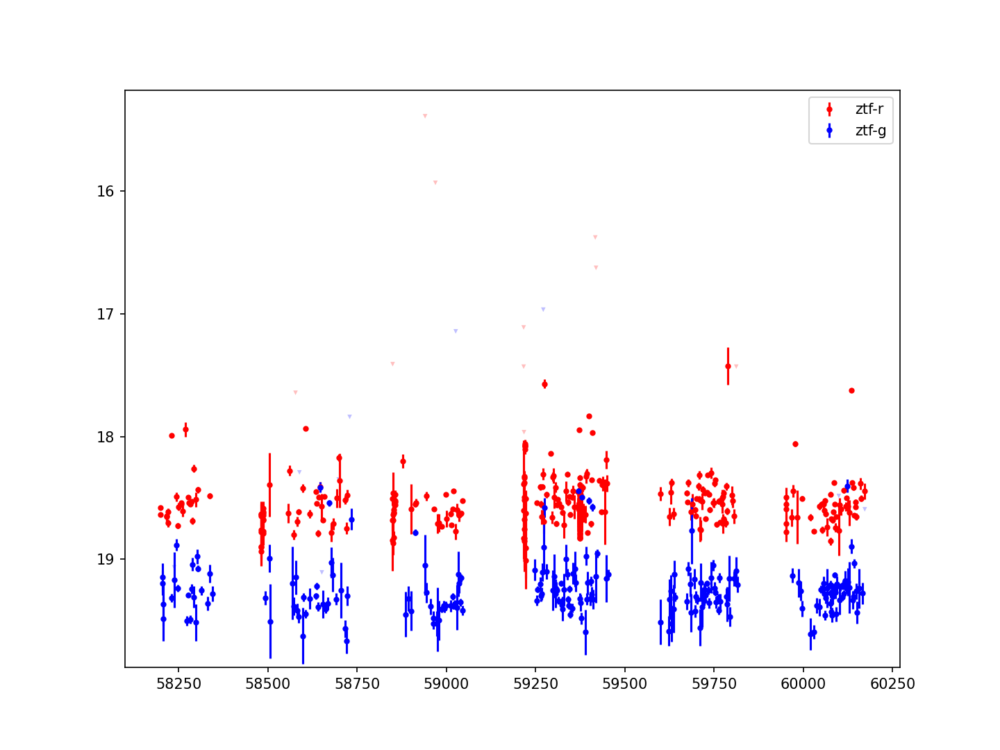

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=236.16412031889%2C+-11.4680221947&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253790


<IPython.core.display.Javascript object>


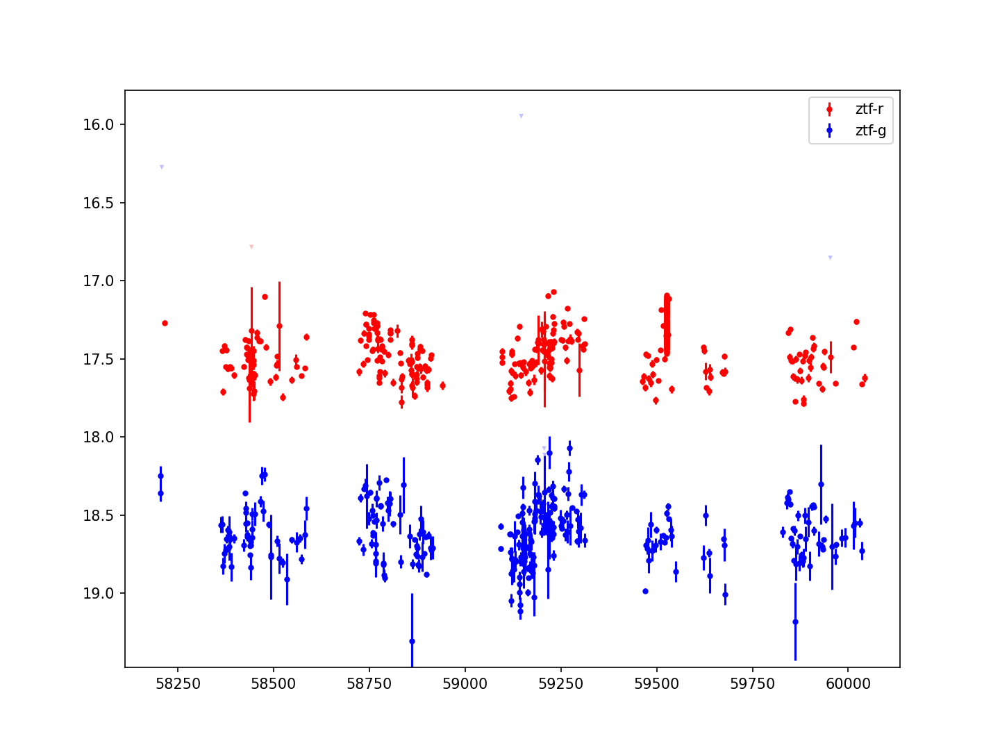

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=95.68559132136%2C+-0.34565907289&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253792


<IPython.core.display.Javascript object>


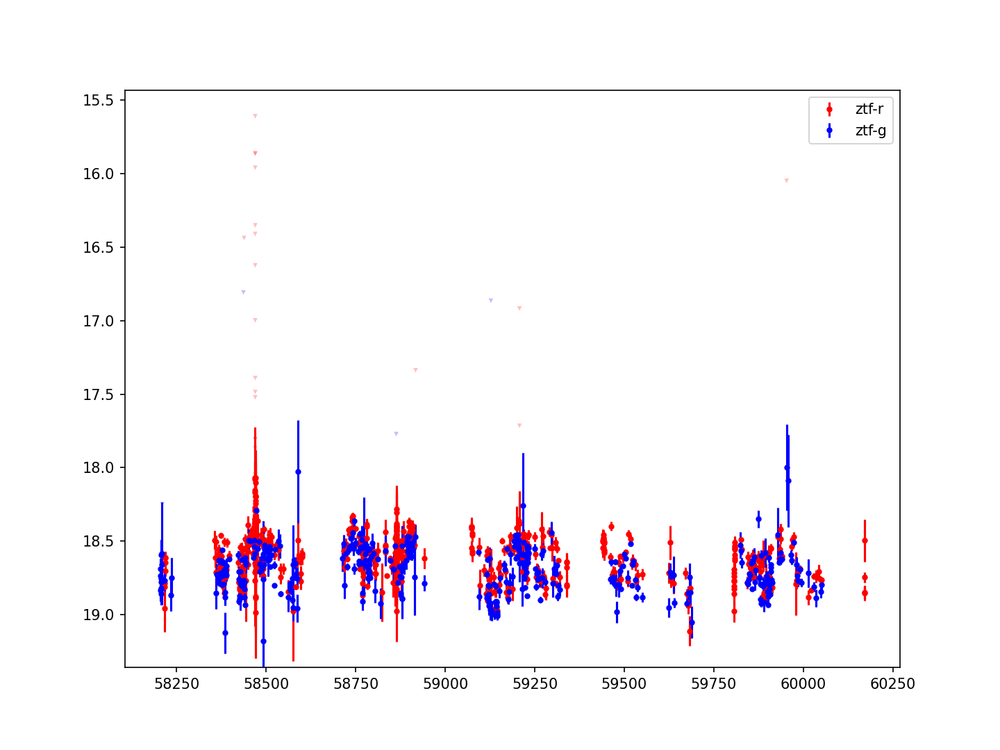

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=94.28065827225%2C+9.13707817366&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253794


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


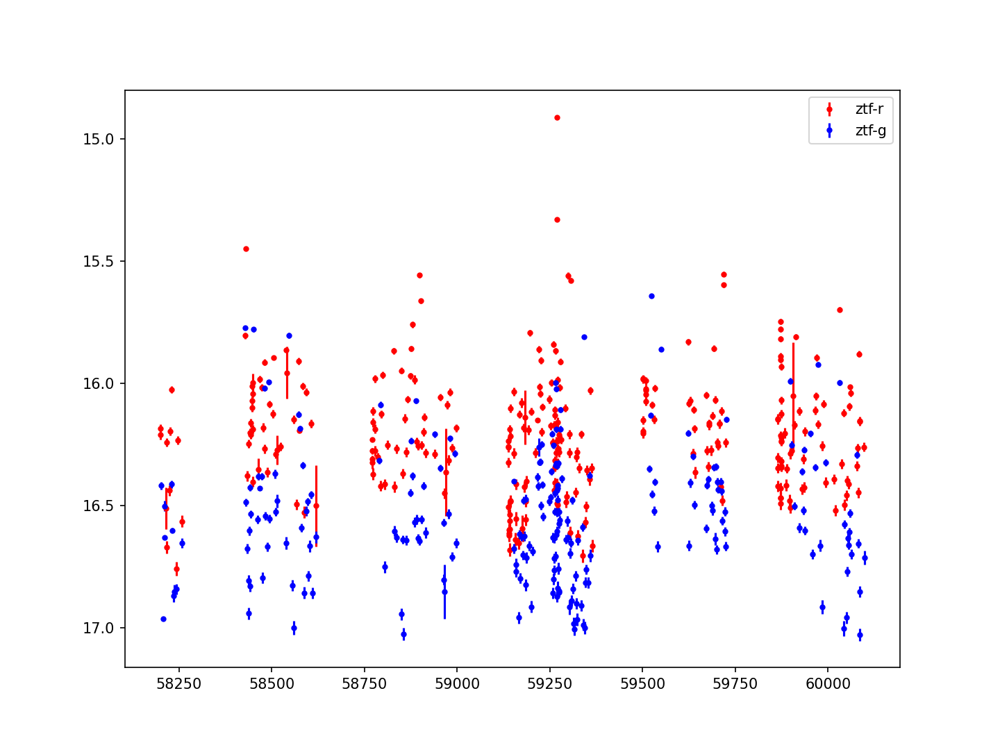

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=155.94870458335%2C+0.64464705475&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253800


<IPython.core.display.Javascript object>


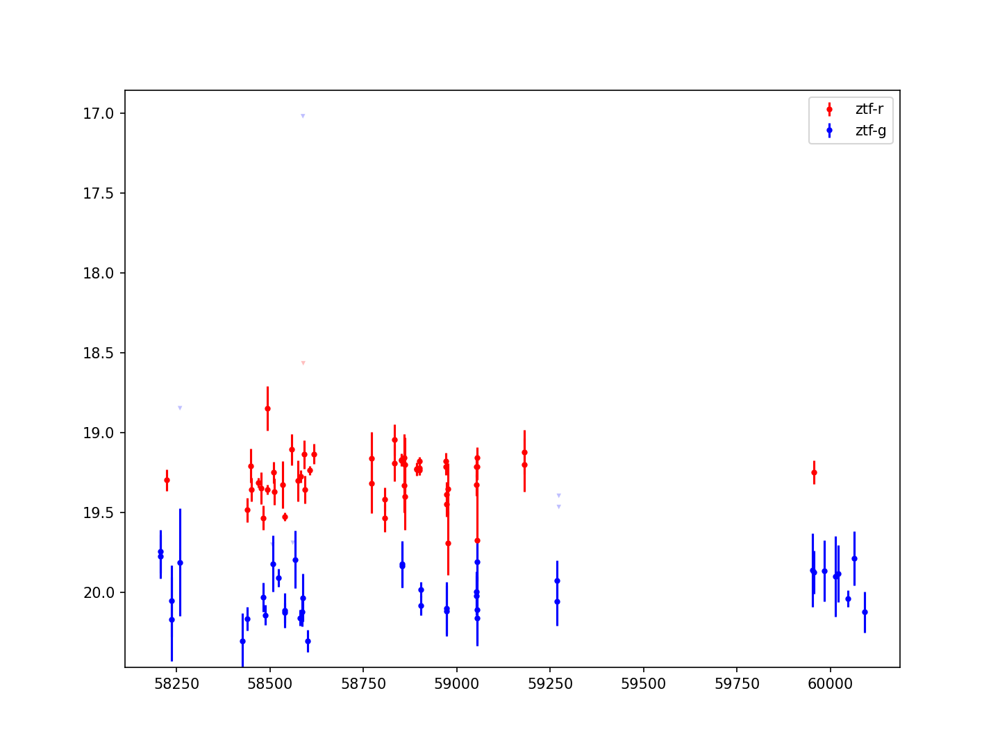

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=169.5448506692%2C+48.03672437092&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253801


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


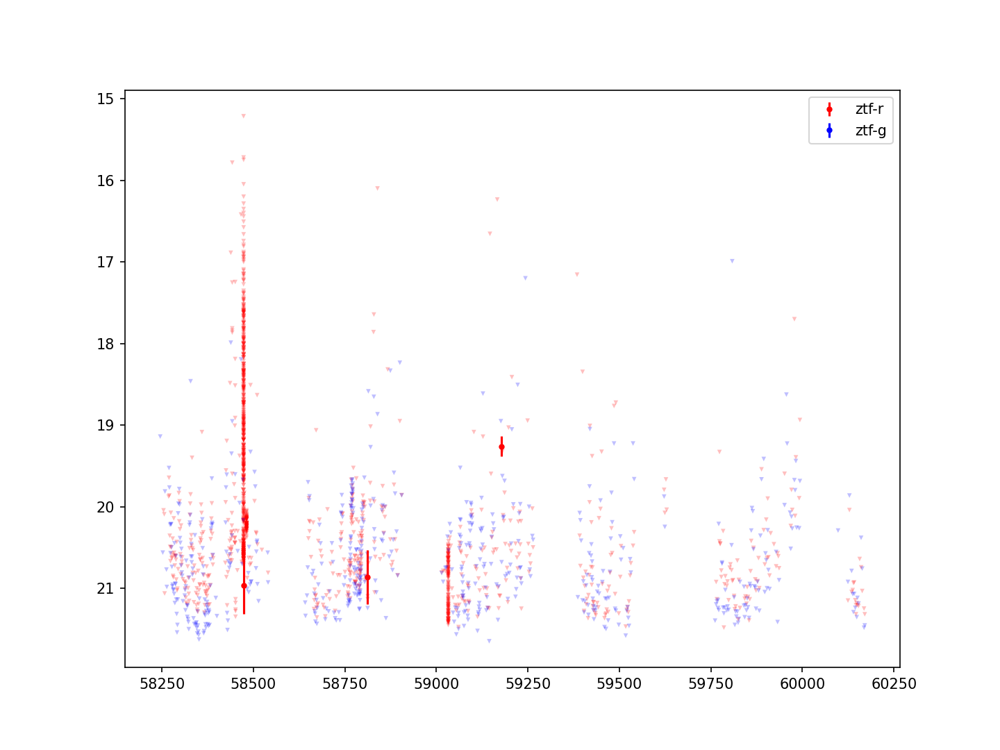

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=7.2626752%2C+59.5719451&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253802


<IPython.core.display.Javascript object>


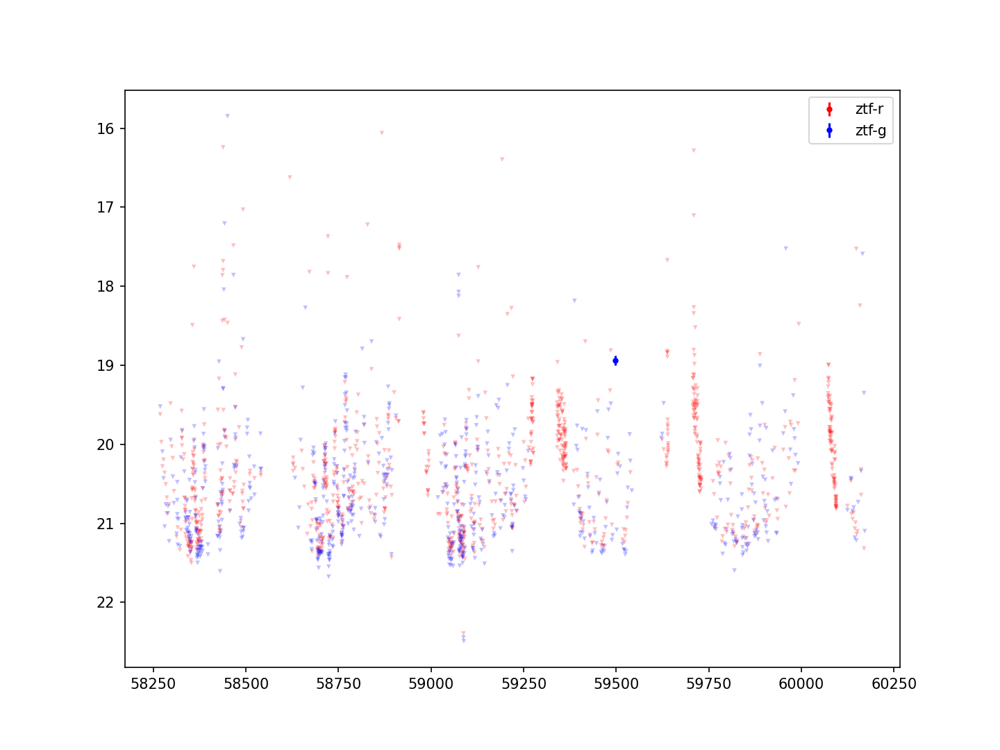

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=11.2104943%2C+33.0192232&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253811


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


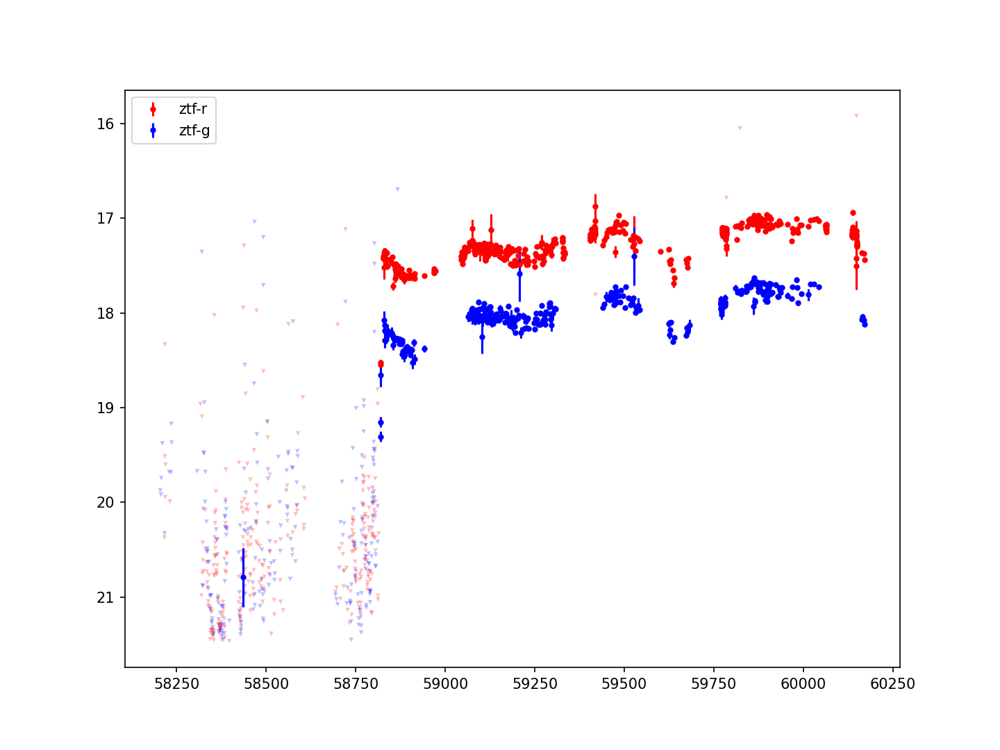

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=68.847%2C+55.37618055556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253819


<IPython.core.display.Javascript object>


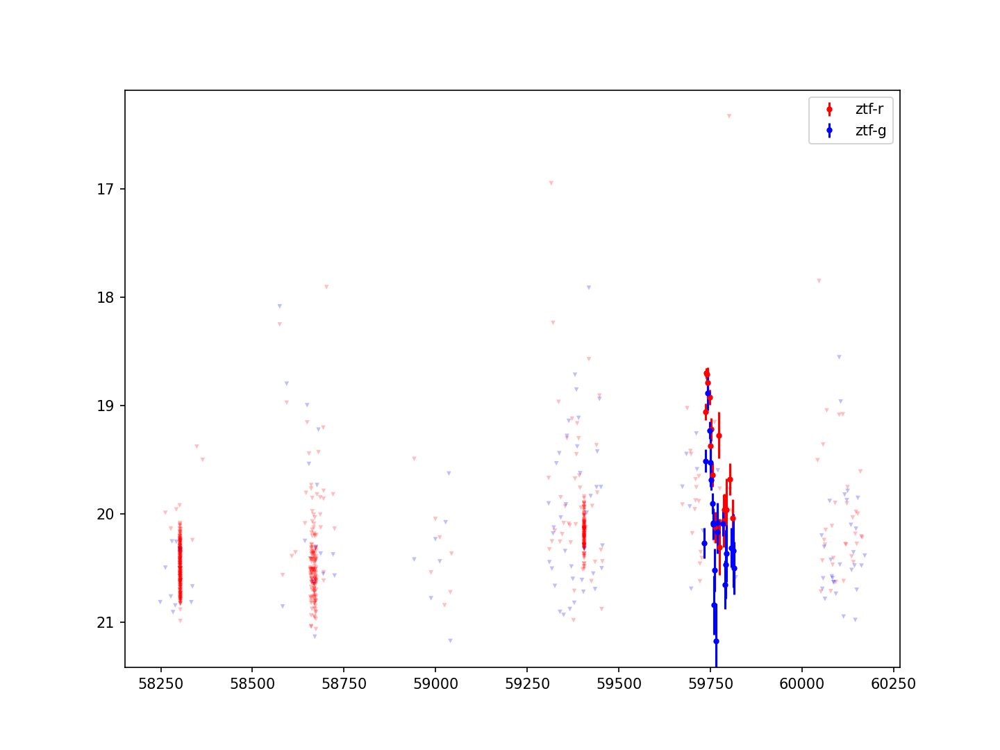

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=257.37656393515%2C+-26.65562501854&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253823


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


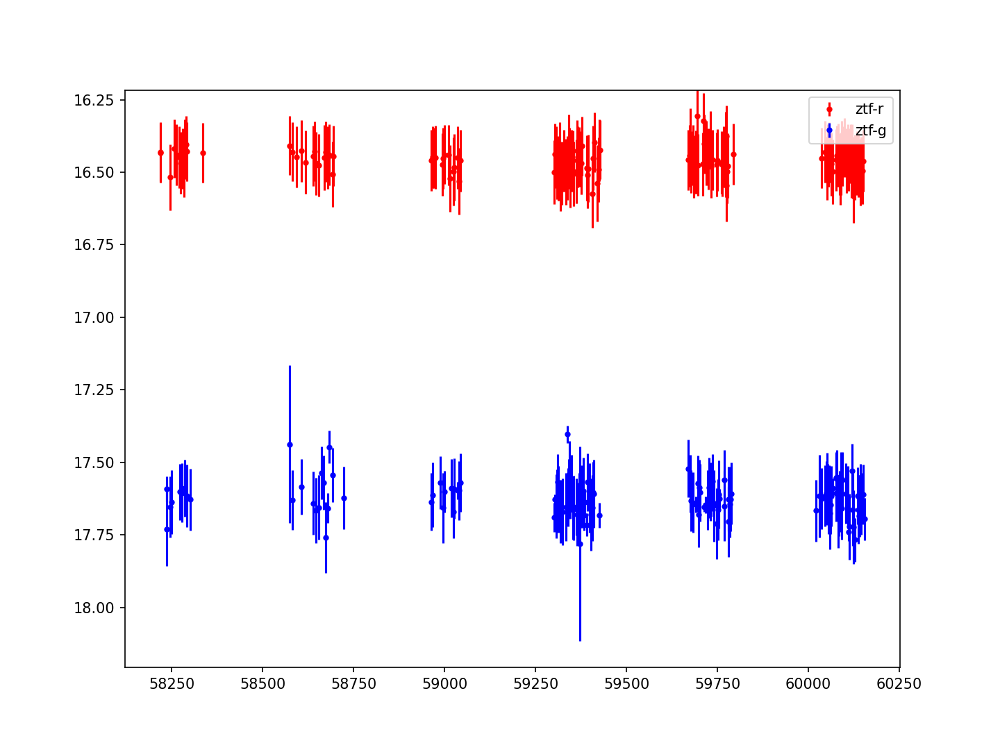

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=245.8921168912%2C+-26.52598812115&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253829


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


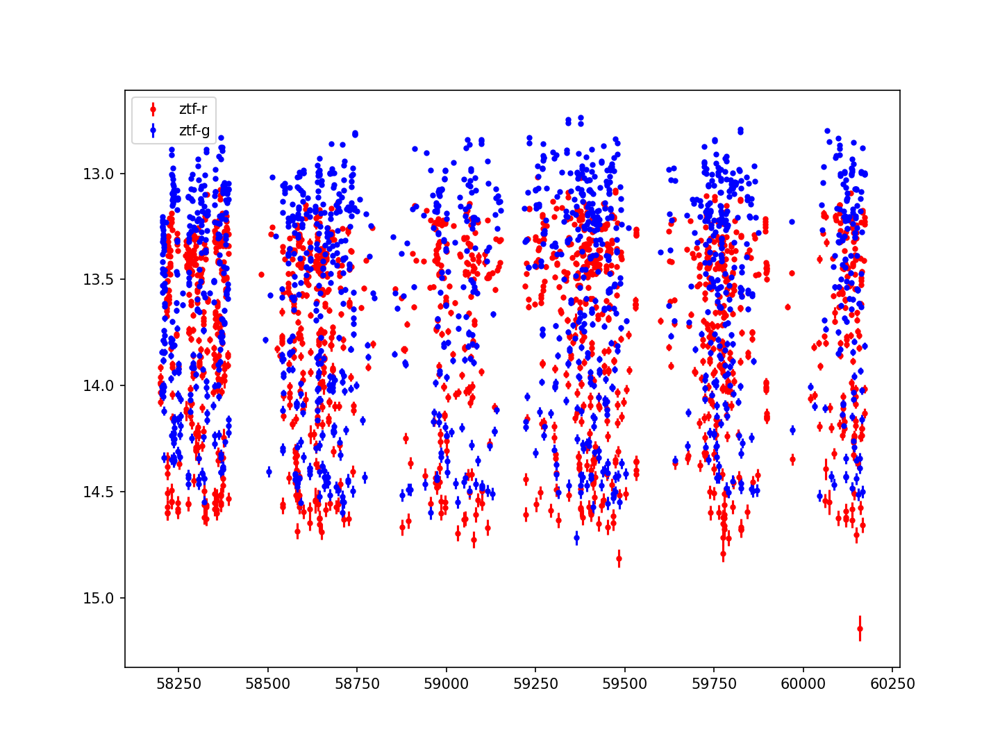

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=254.45753928275%2C+35.34232246072&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253832


<IPython.core.display.Javascript object>


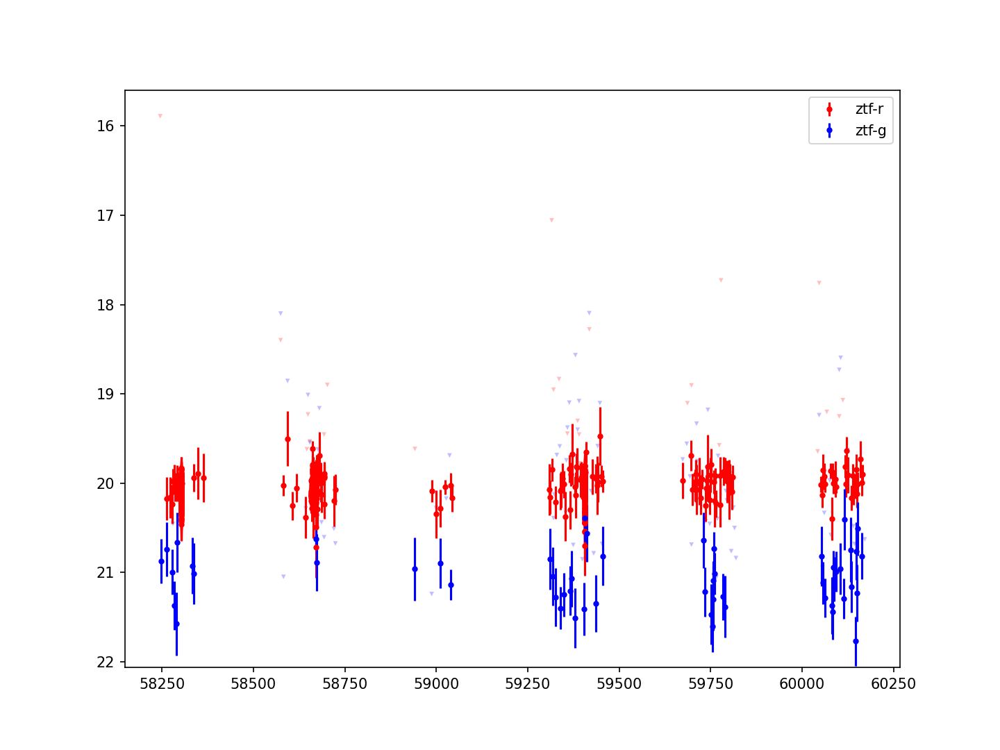

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=257.06041818995%2C+-25.09174883948&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253833


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


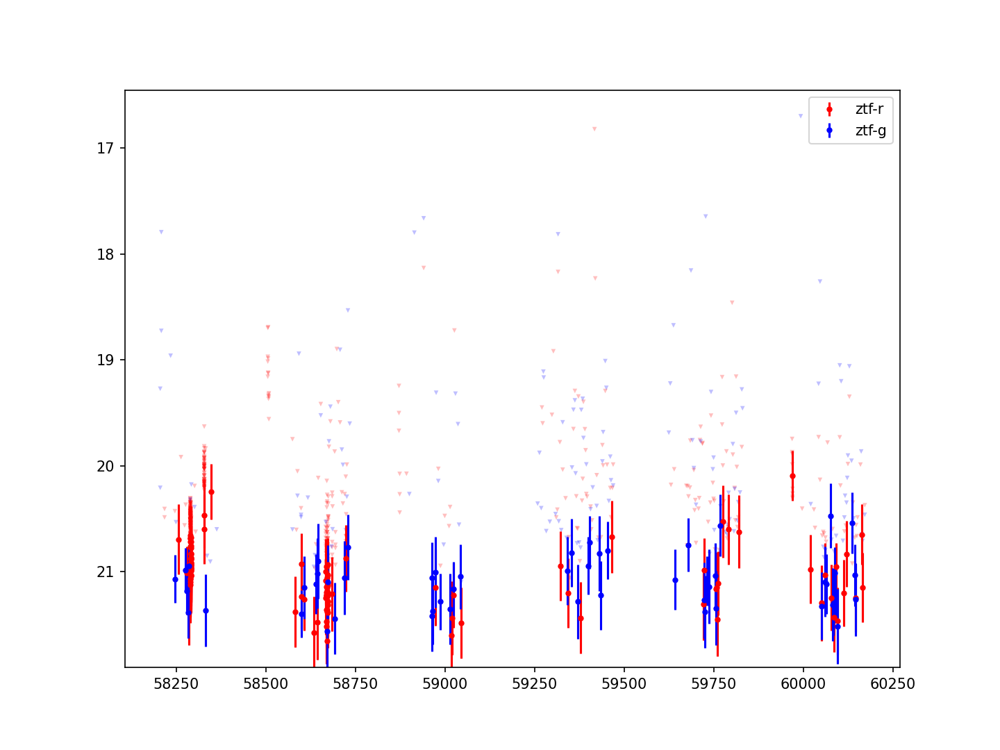

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=254.7571178%2C+-15.2580364&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253836


<IPython.core.display.Javascript object>


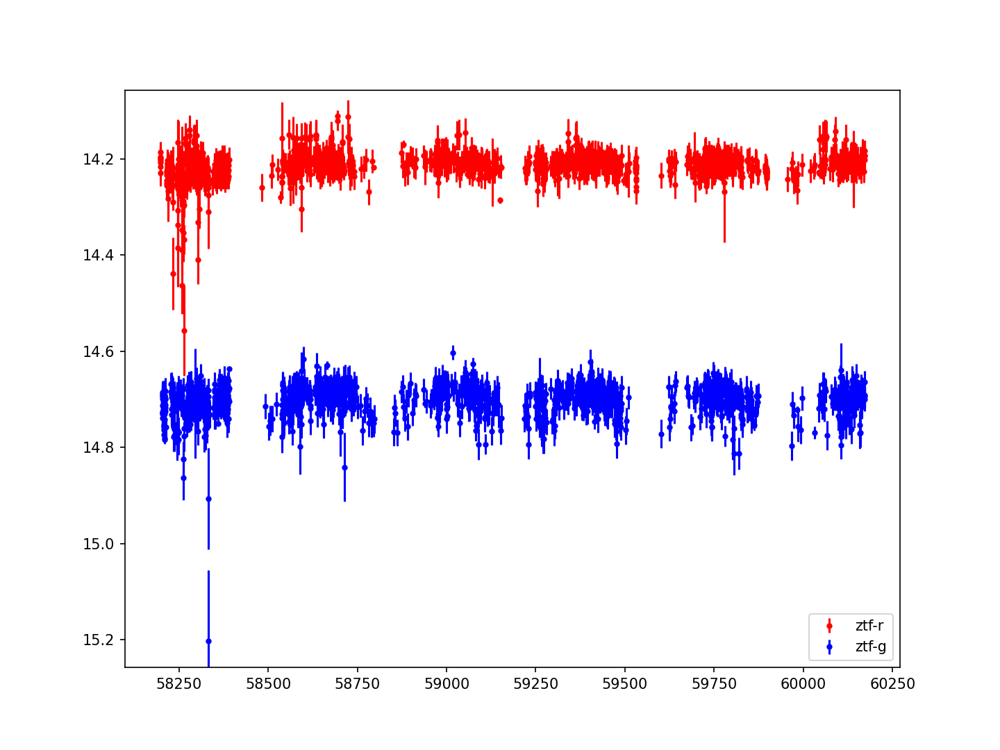

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=250.4318%2C+36.4663&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253849


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


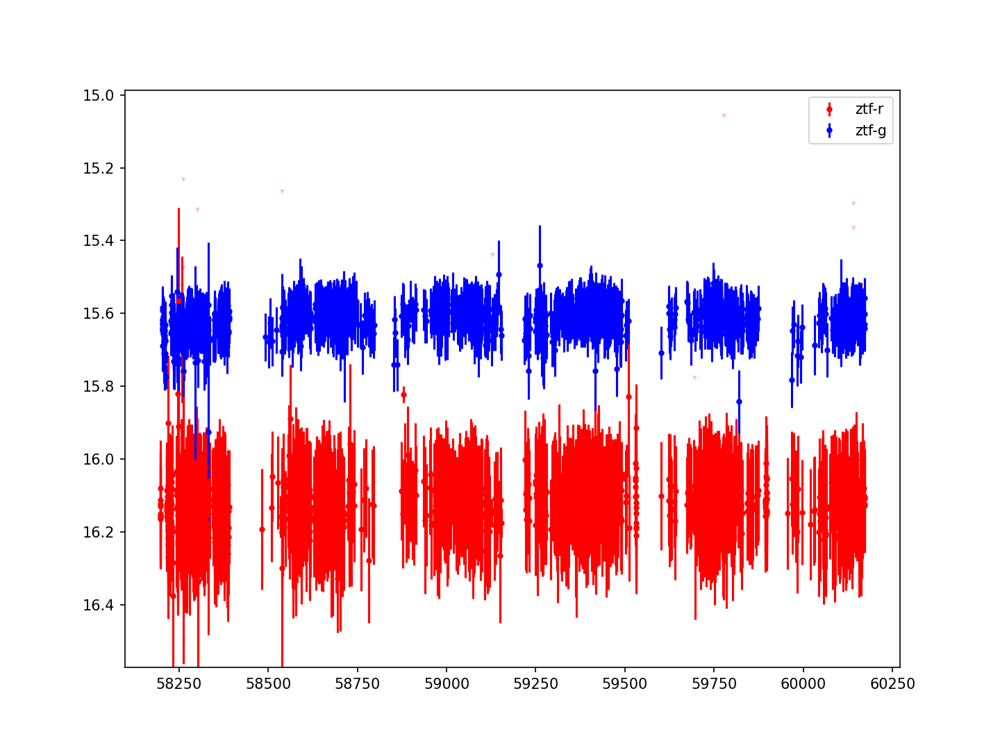

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=250.4323464%2C+36.4661125&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253851


<IPython.core.display.Javascript object>


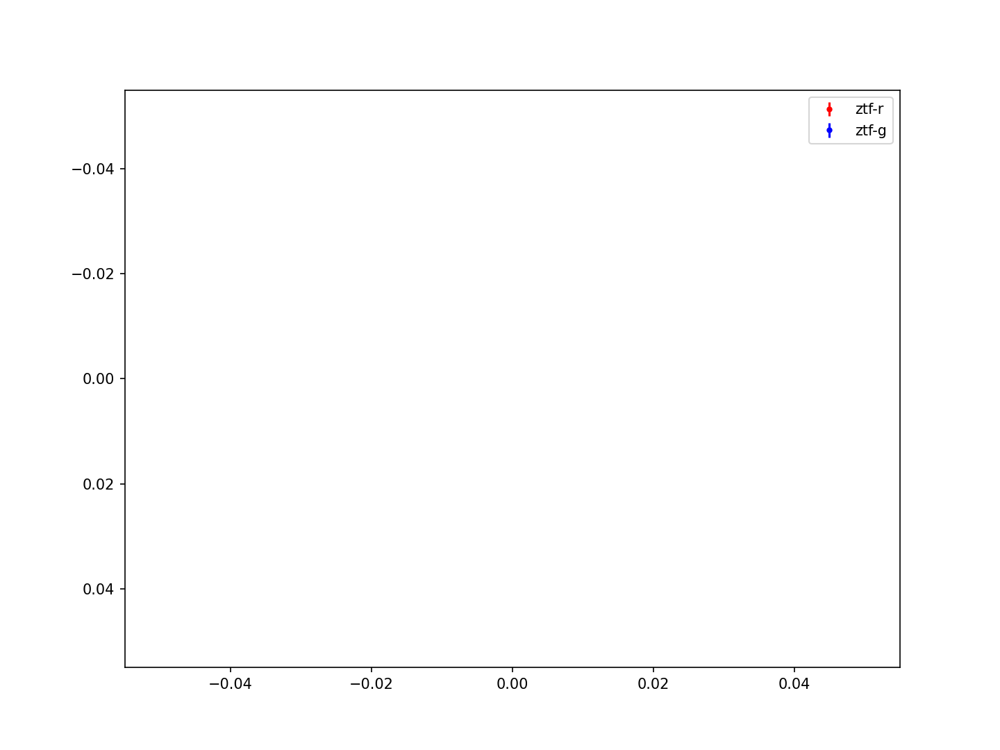

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=256.64376094254%2C+23.97181951625&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253868


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


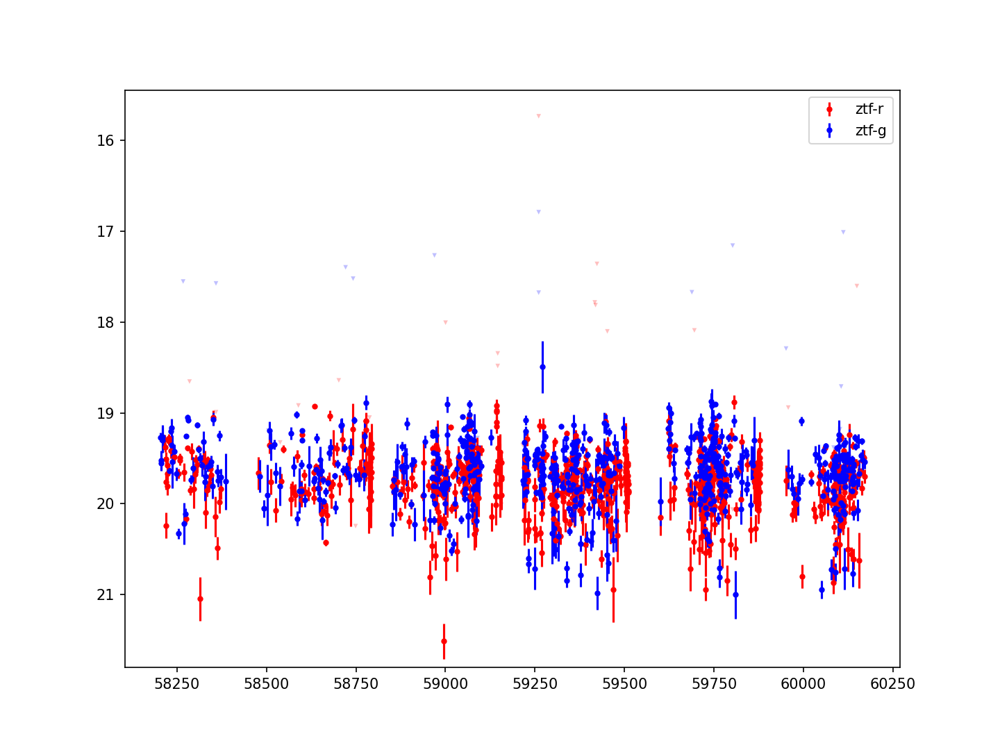

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=241.44116531191%2C+25.86253902932&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253871


<IPython.core.display.Javascript object>


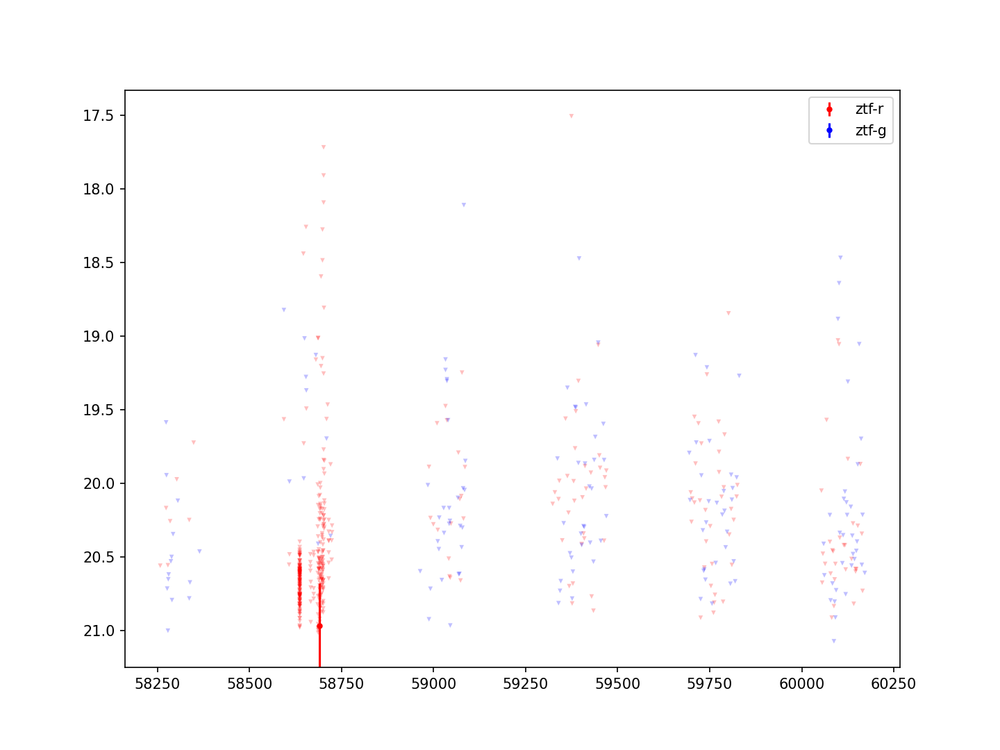

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=264.00833333333%2C+-27.42805555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253878


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


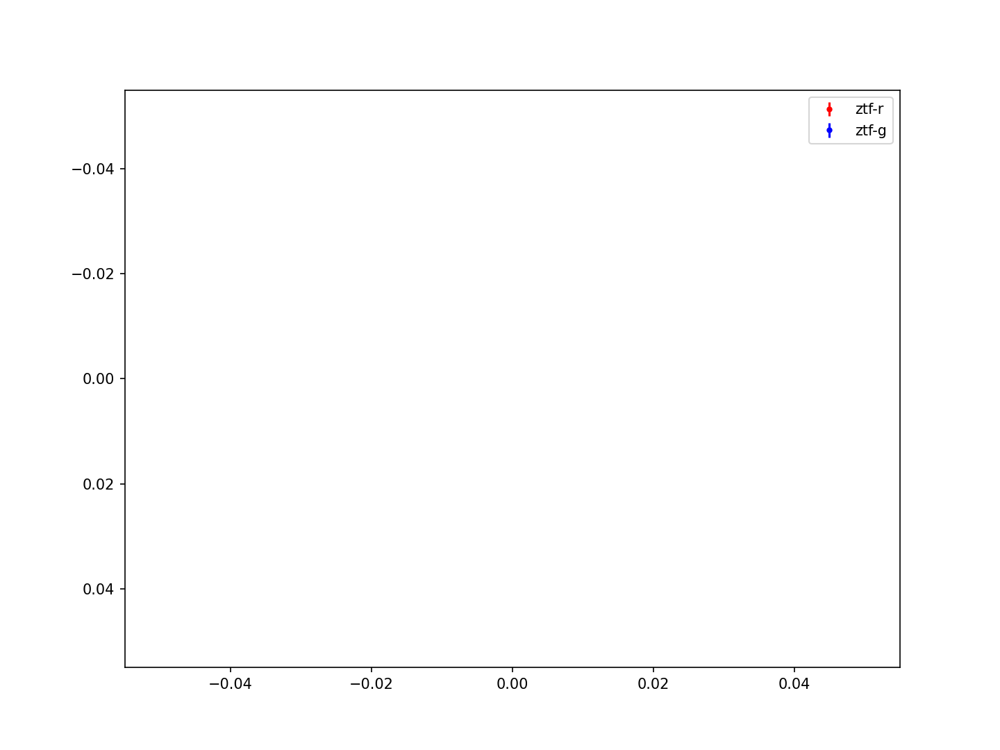

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=265.15879166667%2C+-27.62002777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253893


<IPython.core.display.Javascript object>


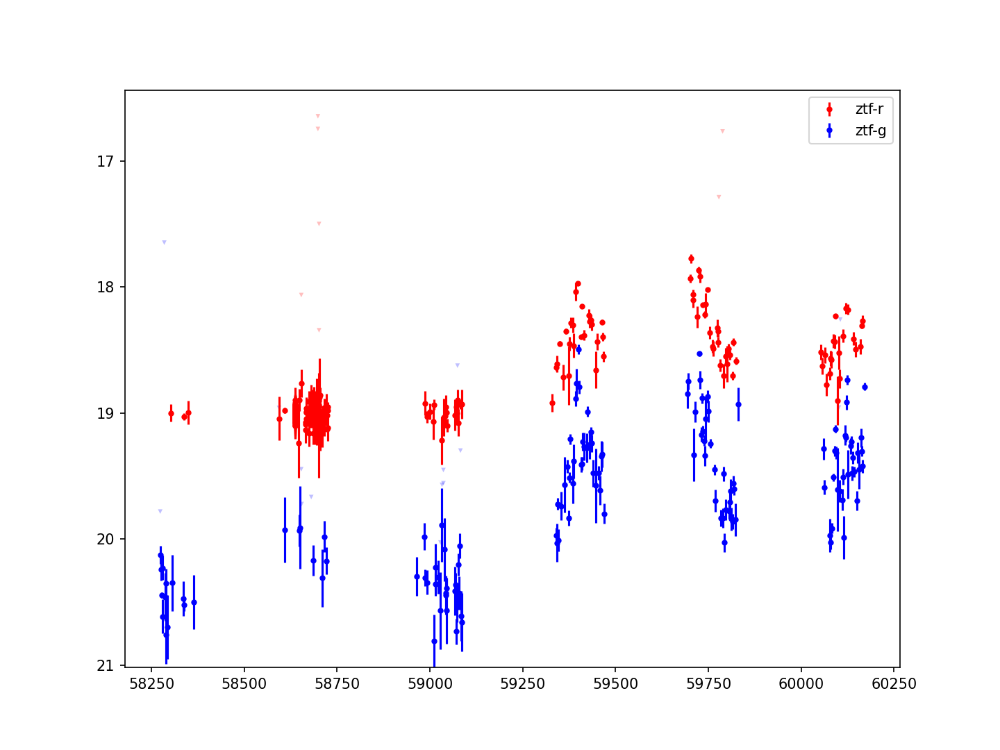

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=263.489875%2C+-22.03230555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253896


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


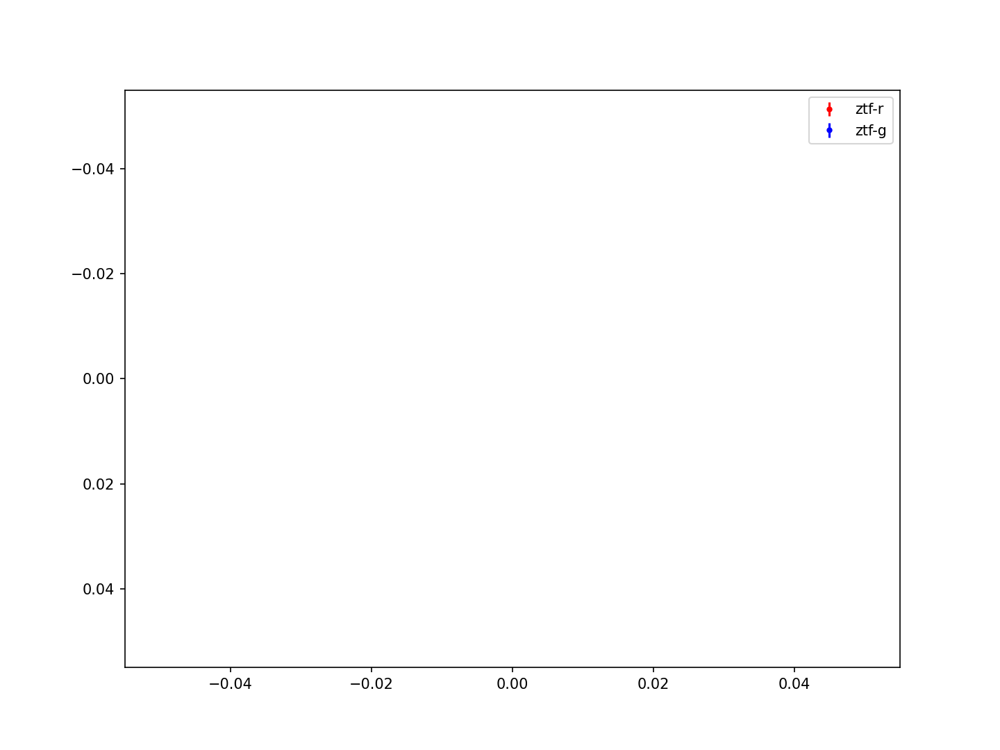

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=263.5560341%2C+-26.0885277&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253899


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


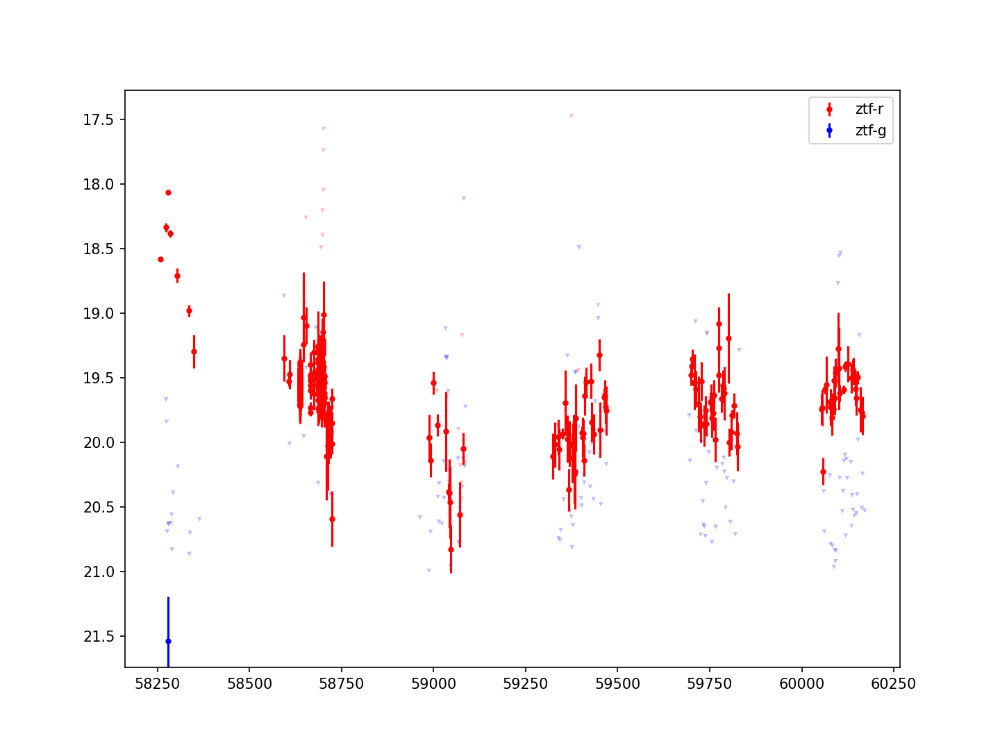

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=263.21111317334%2C+-27.5004381073&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253913


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


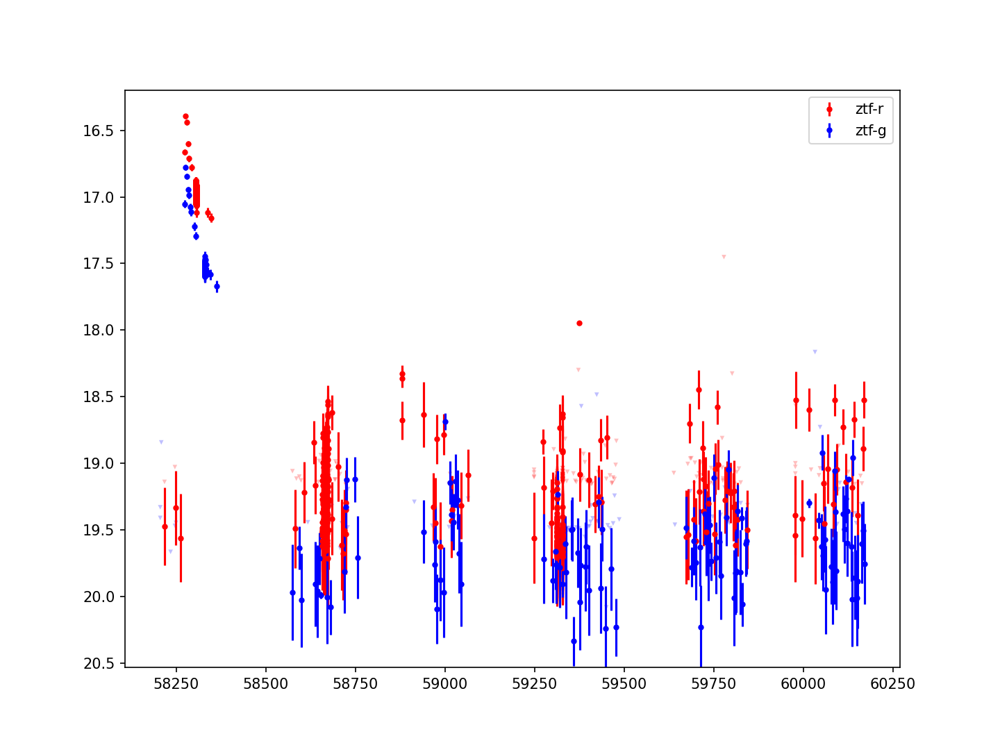

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=262.12466%2C+-20.3823&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253914


<IPython.core.display.Javascript object>


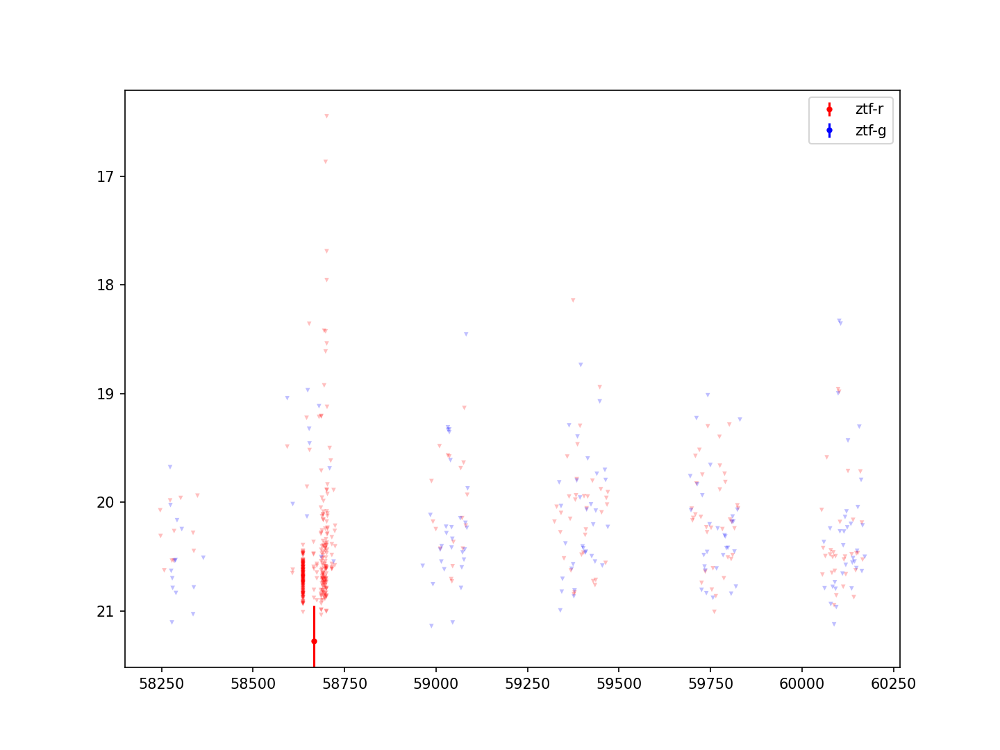

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=264.5711019%2C+-26.9946162&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253915


<IPython.core.display.Javascript object>


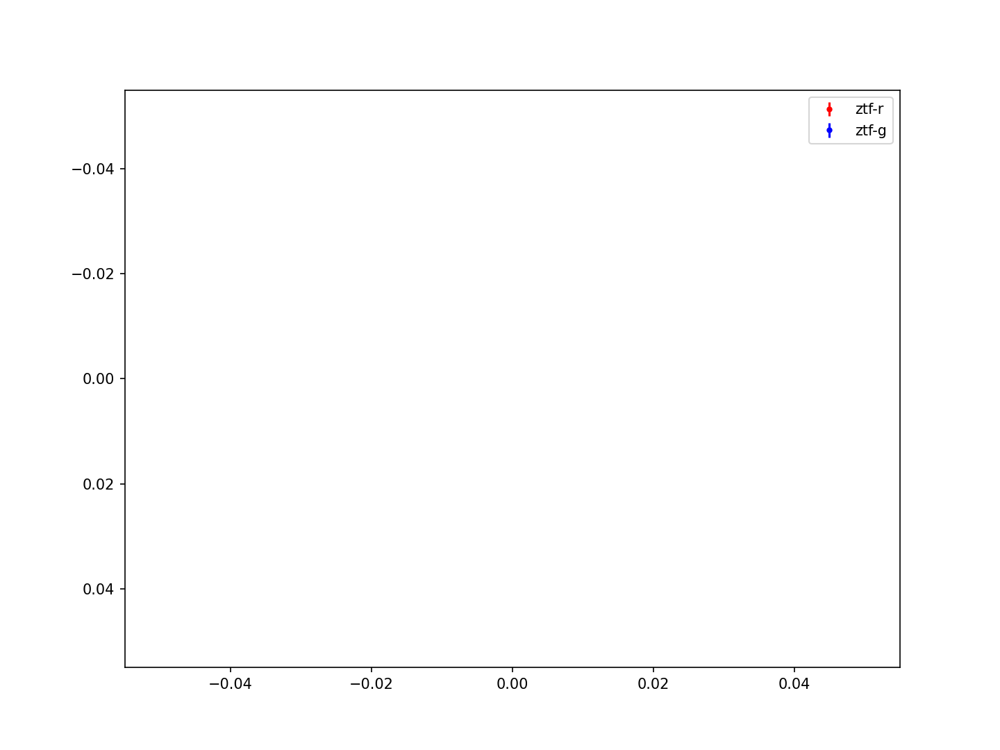

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=262.93426447898%2C+-16.96134809066&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253917


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


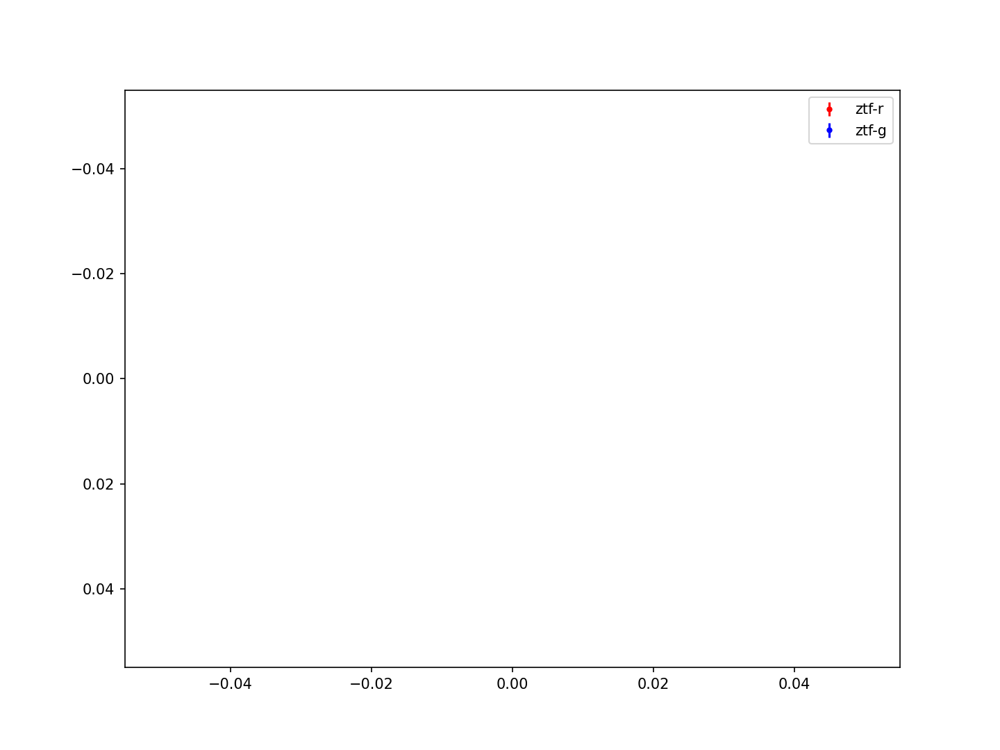

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=263.00895464609%2C+-24.74560029077&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253920


<IPython.core.display.Javascript object>


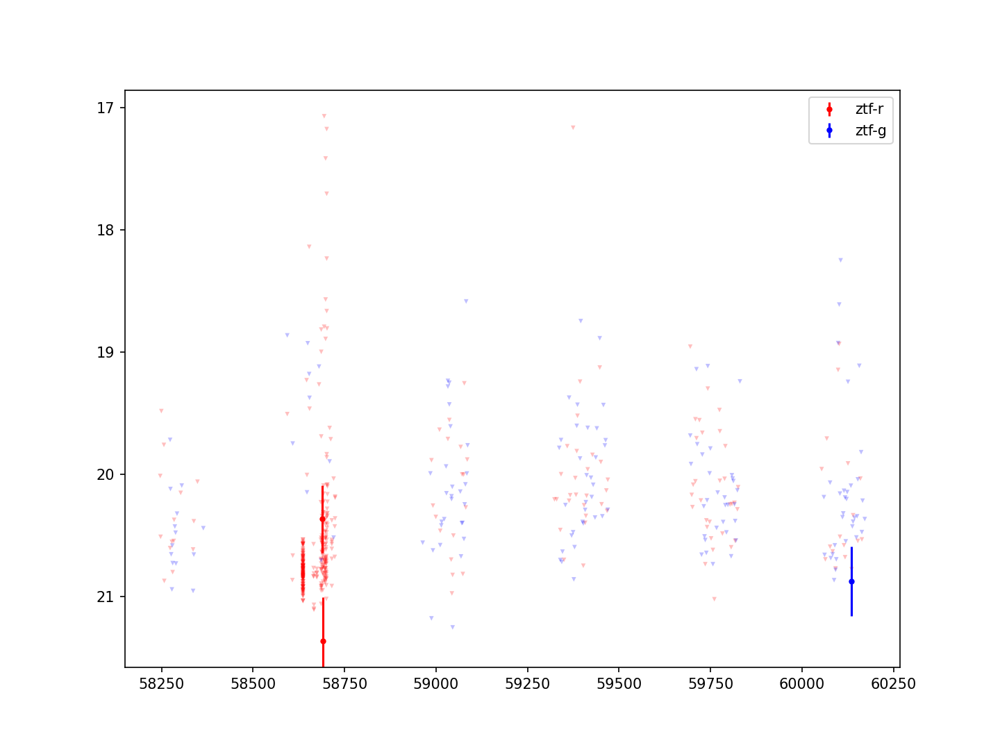

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=265.666522%2C+-27.747992&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253928


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


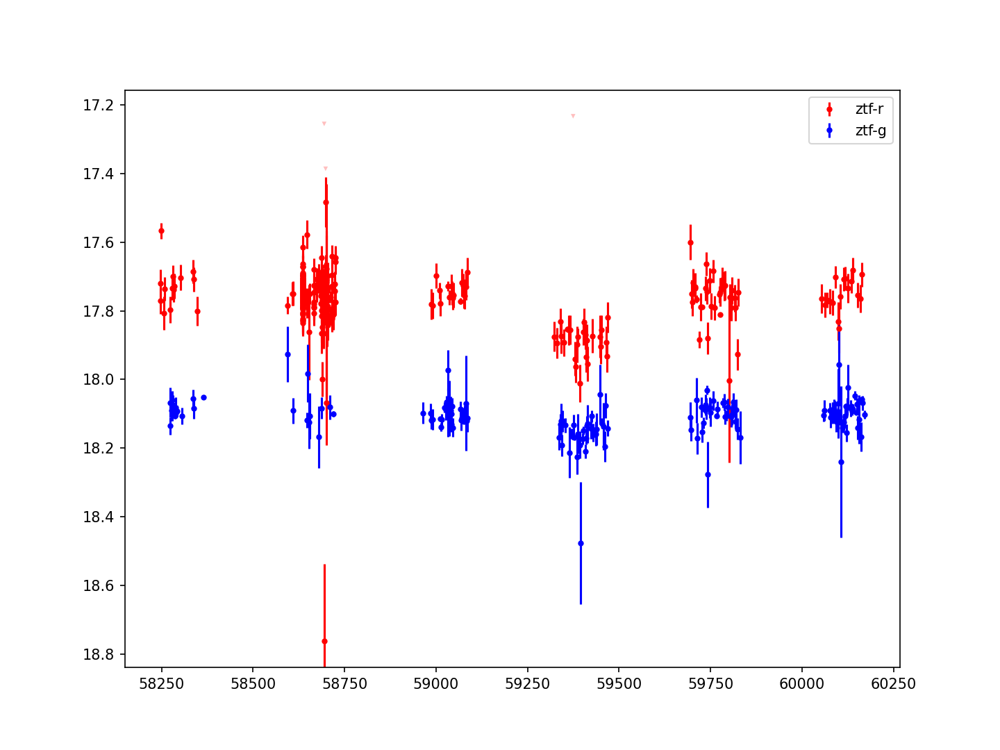

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=265.8189722%2C+-27.7603588&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253929


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


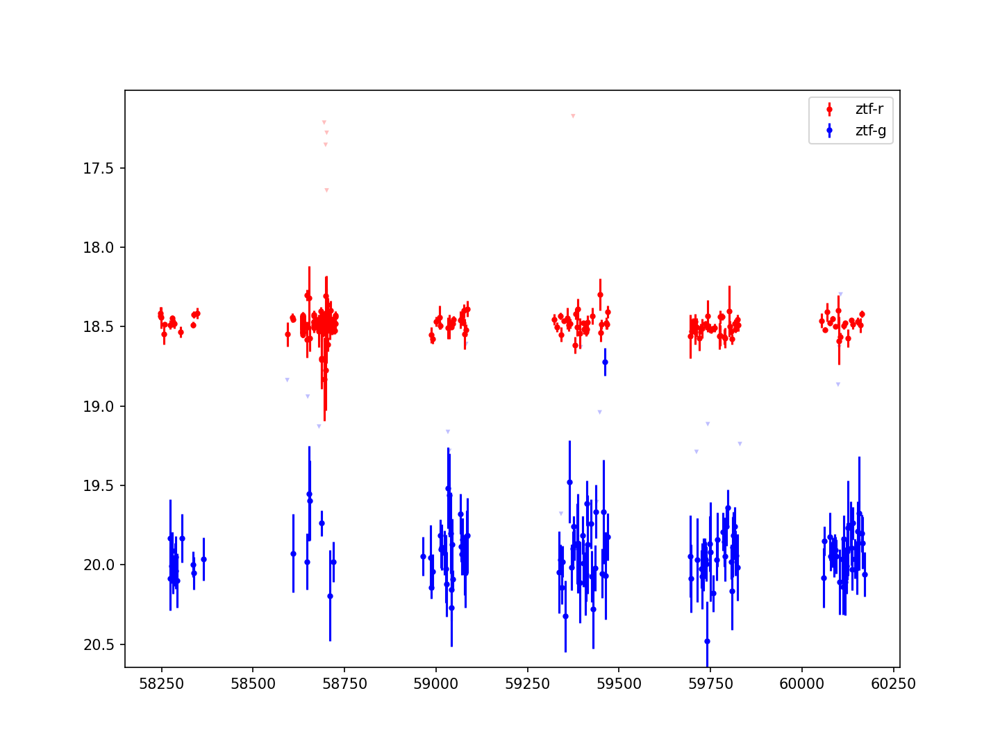

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.12673050062%2C+-27.76681666542&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253937


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


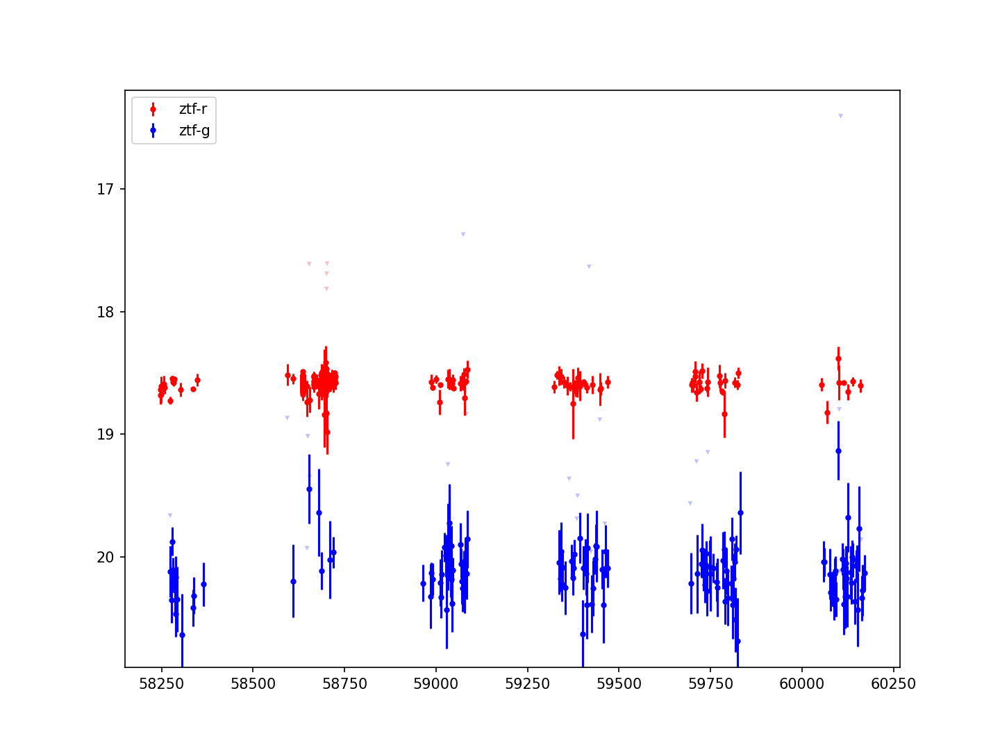

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.29520833333%2C+-26.4035&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253959


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


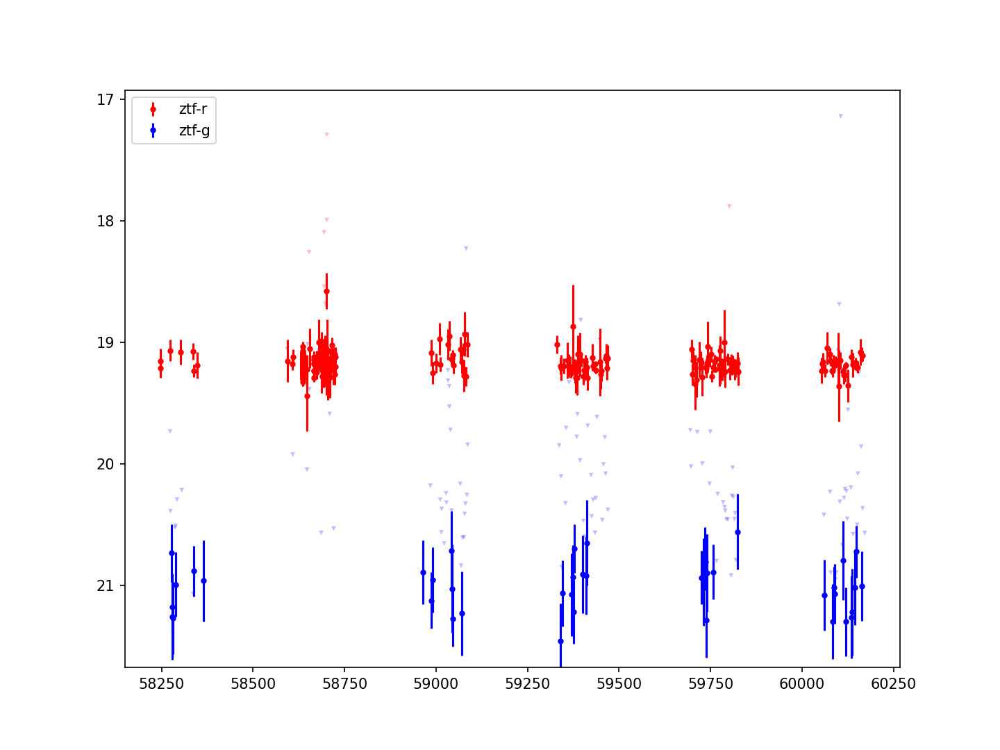

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.0210453%2C+-26.5331624&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253966


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


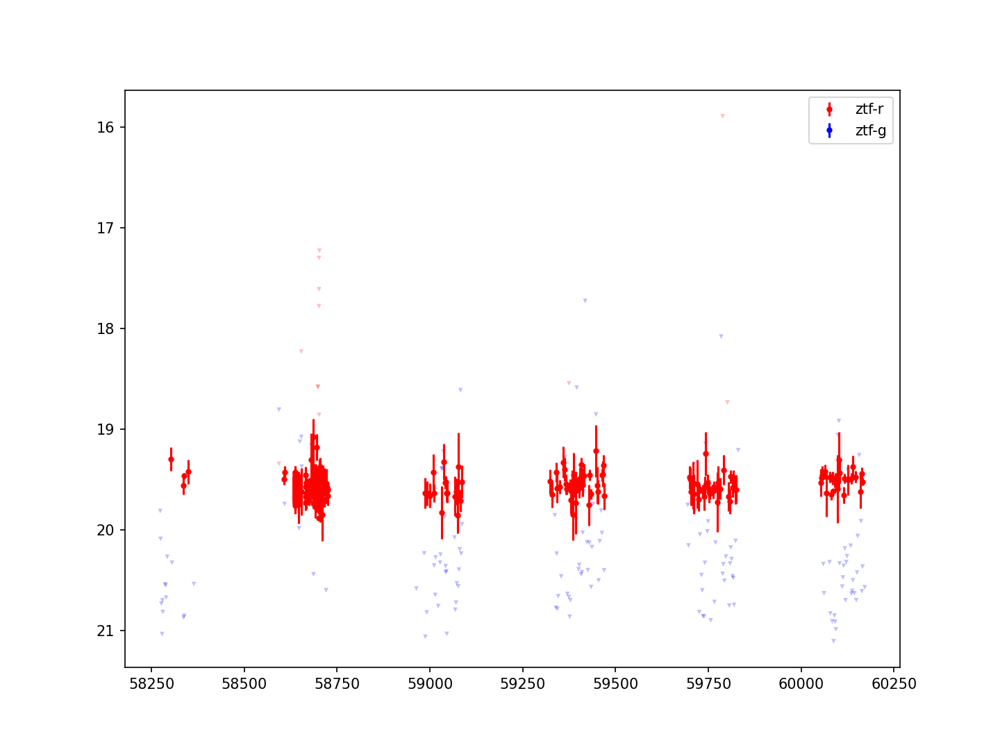

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.6131975%2C+-25.8312215&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253968


<IPython.core.display.Javascript object>


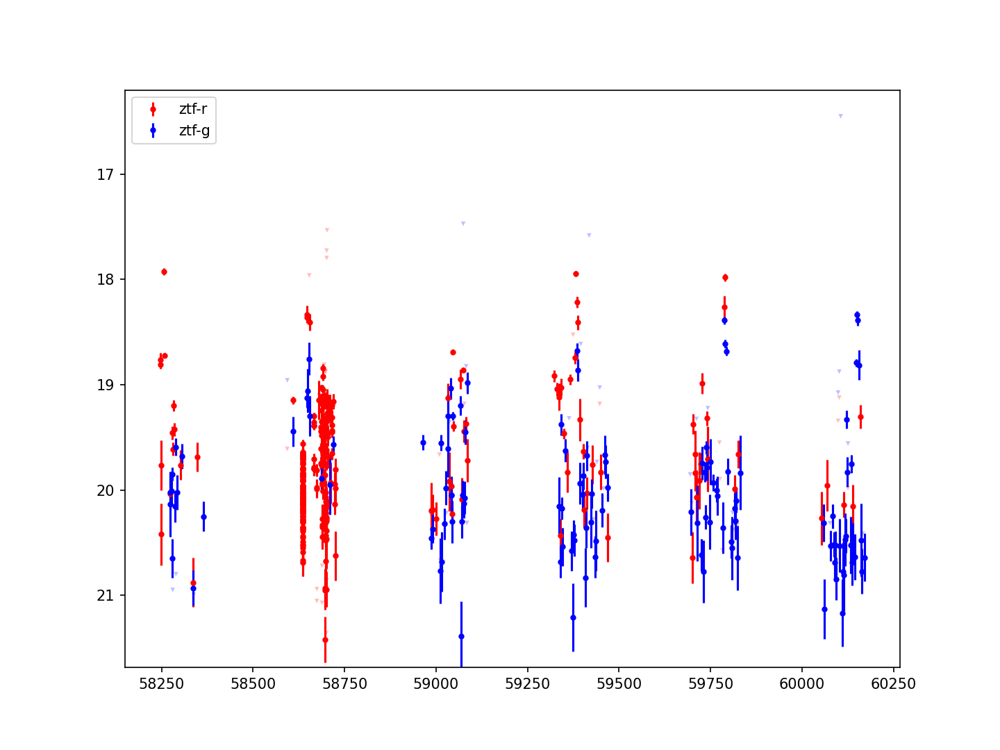

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.63933788595%2C+-26.3872218873&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253975


<IPython.core.display.Javascript object>


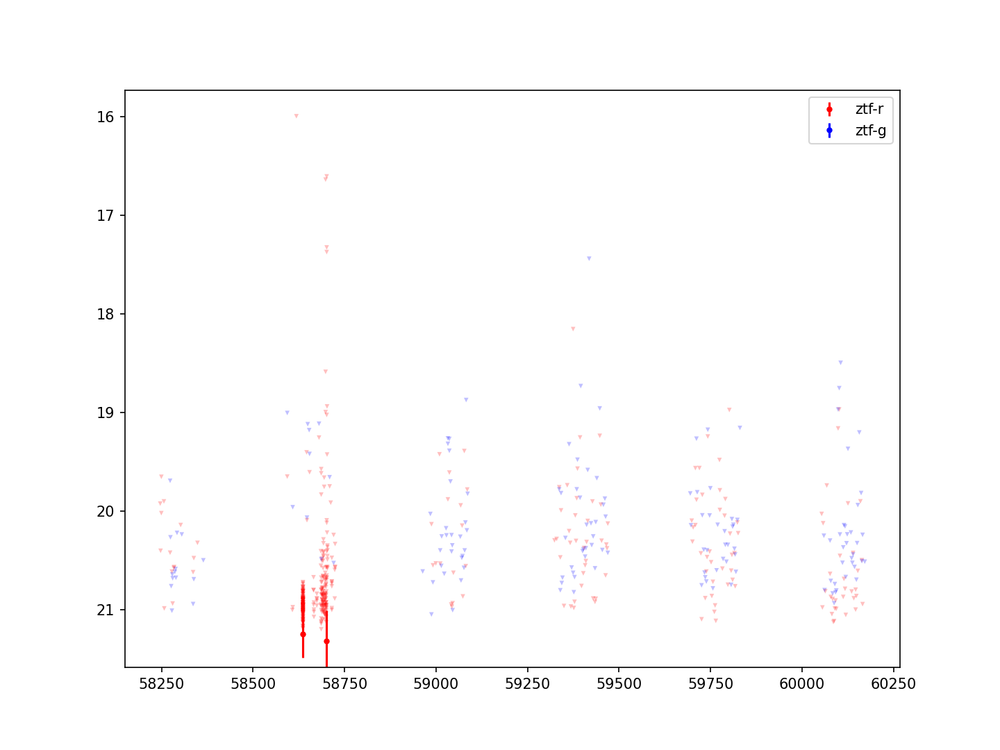

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.8251564%2C+-27.3441521&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253976


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


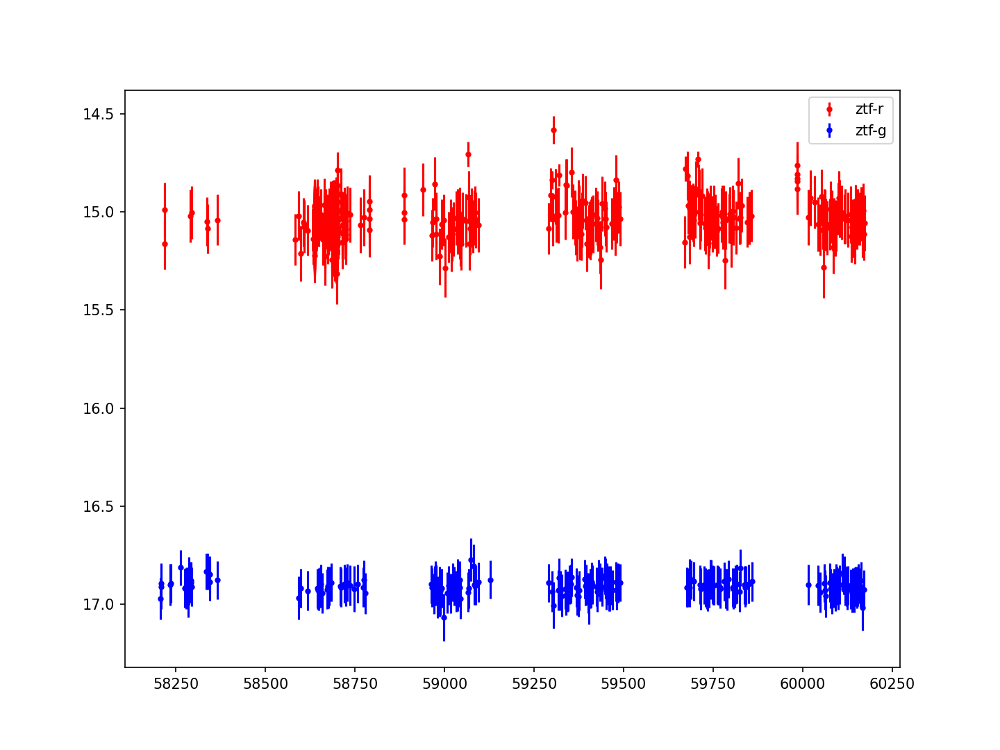

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.2184125%2C+-20.35888888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253982


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


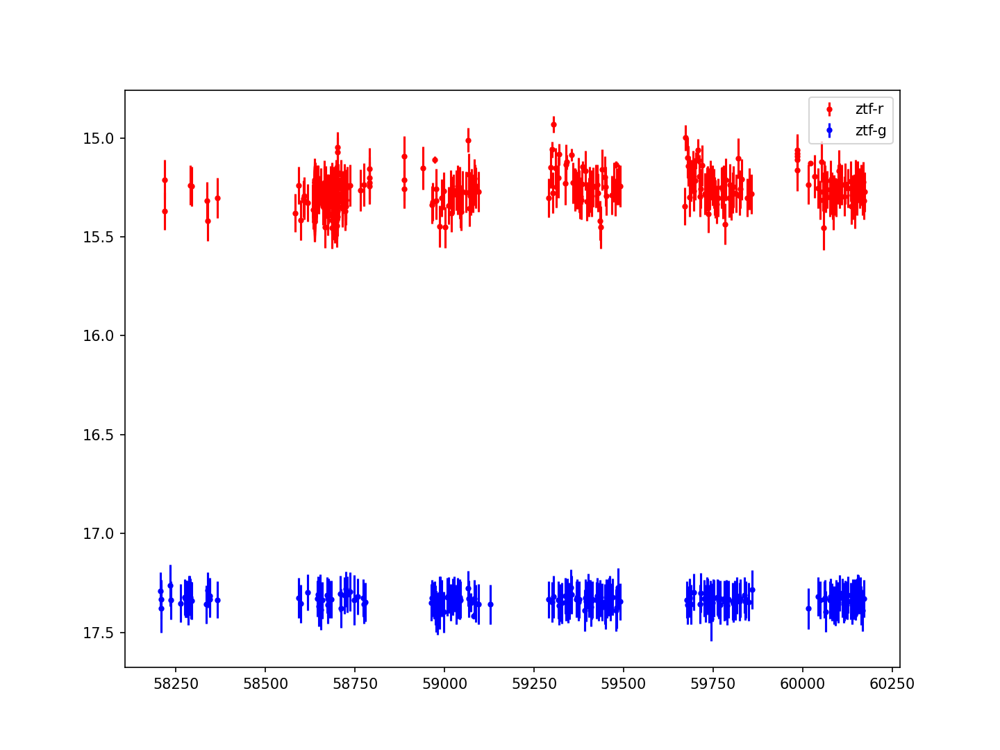

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.21983333333%2C+-20.35666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253983


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


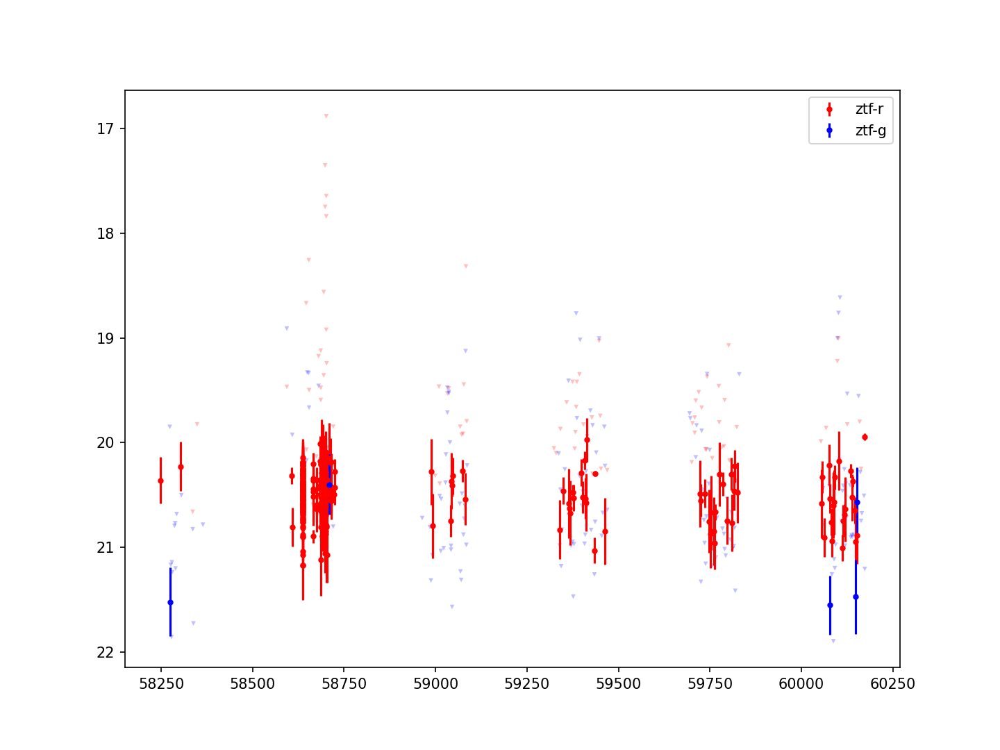

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.60212050824%2C+-21.42221793097&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253984


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


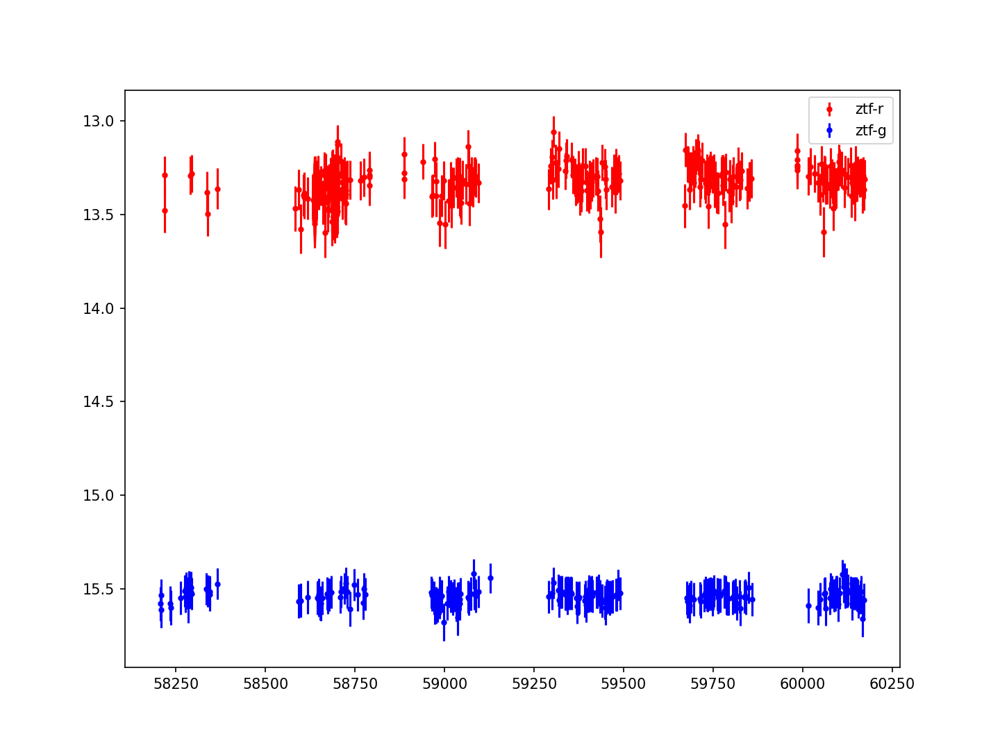

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.21927083333%2C+-20.36125&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253985


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


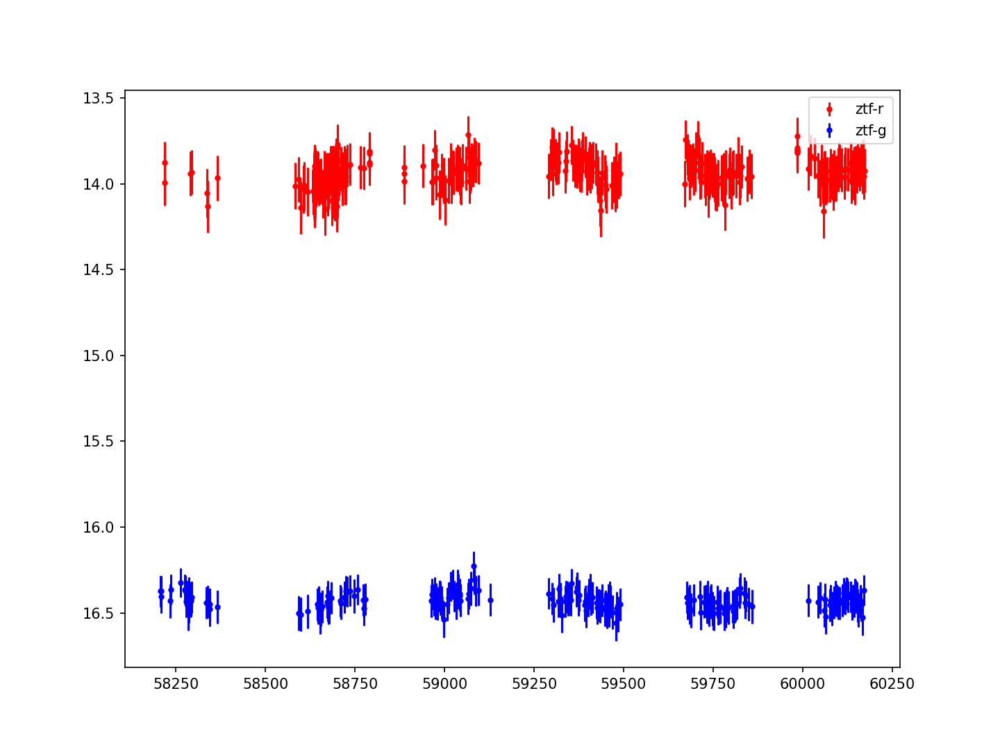

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.22030833333%2C+-20.35869722222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253988


<IPython.core.display.Javascript object>


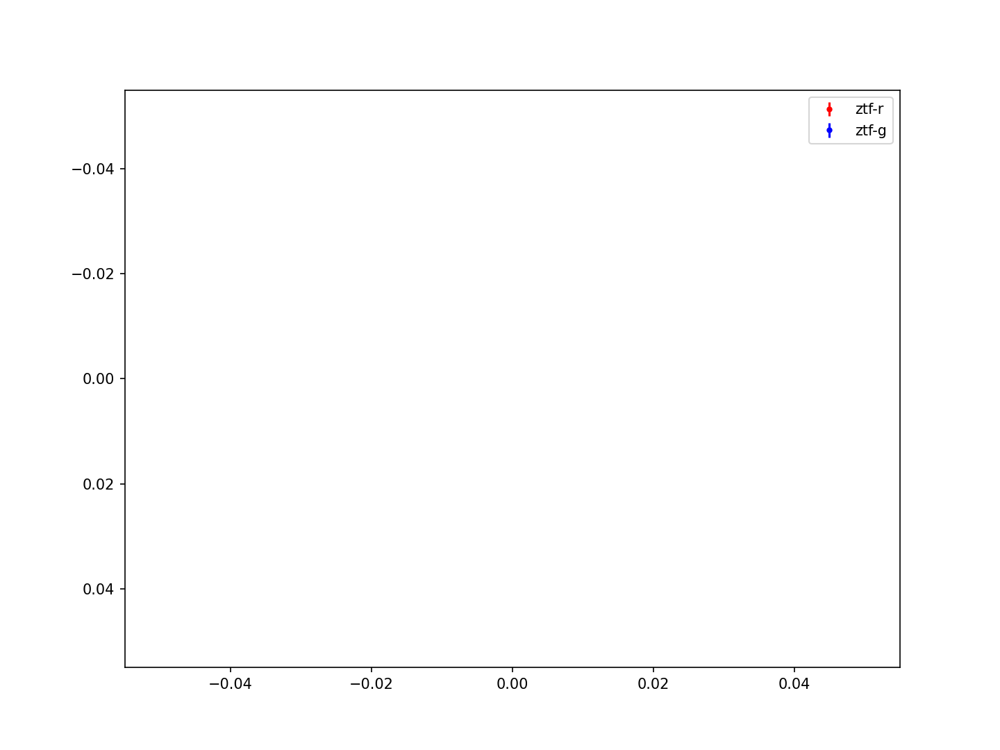

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=270.30166666667%2C+-25.74338888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253991


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


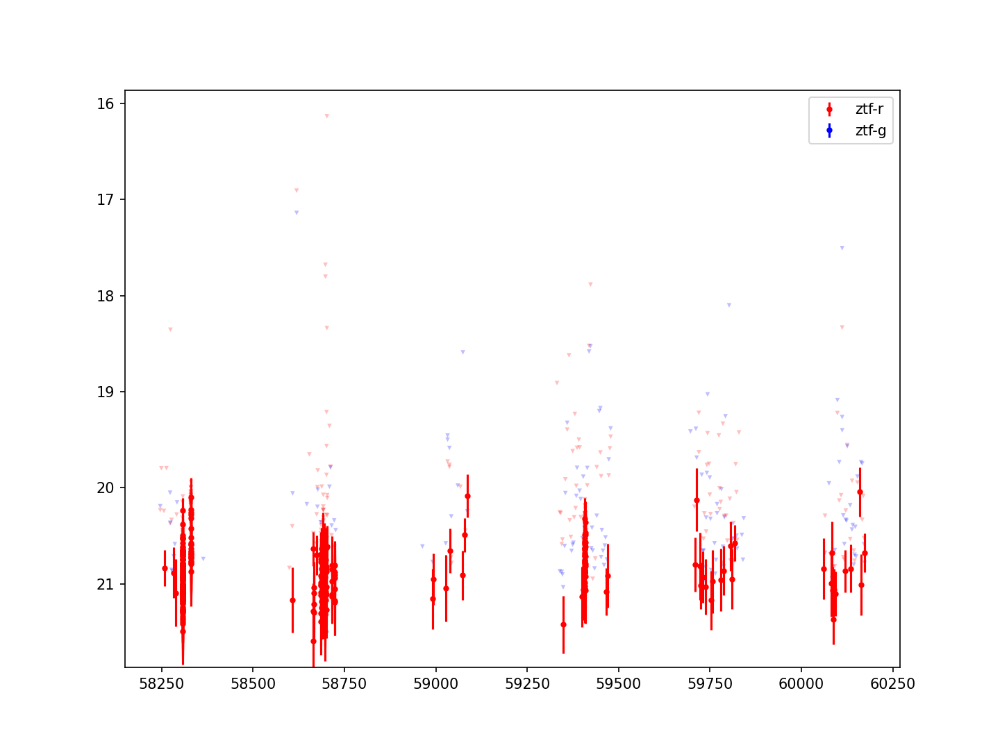

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=269.93965833333%2C+-22.02763333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253992


<IPython.core.display.Javascript object>


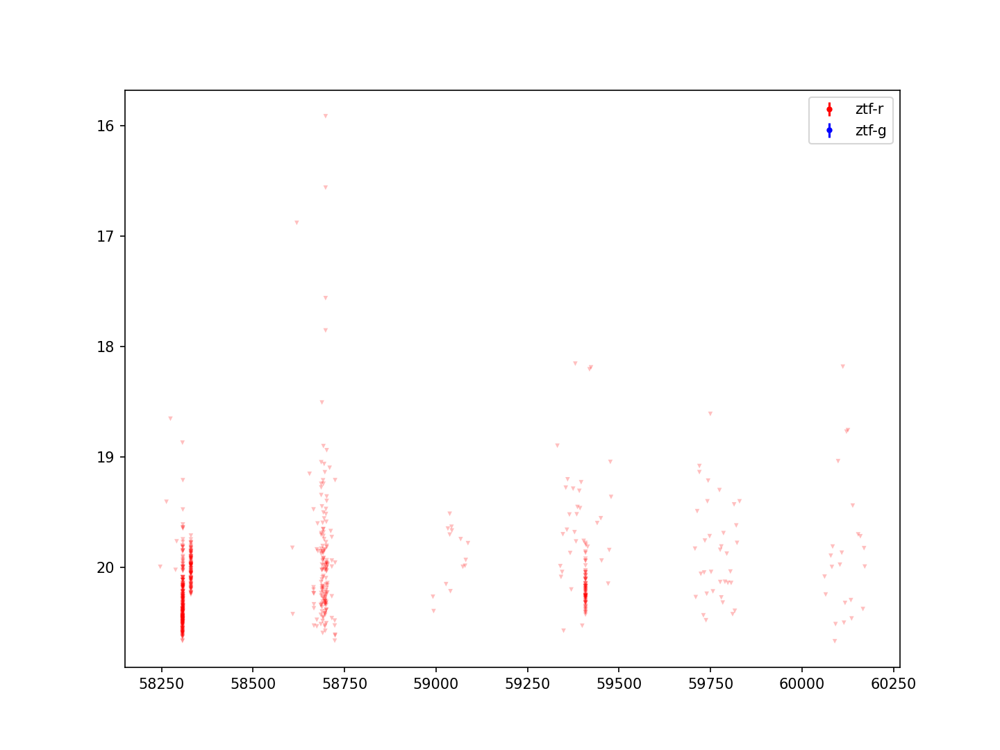

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=270.28425833333%2C+-25.07846111111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253994


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


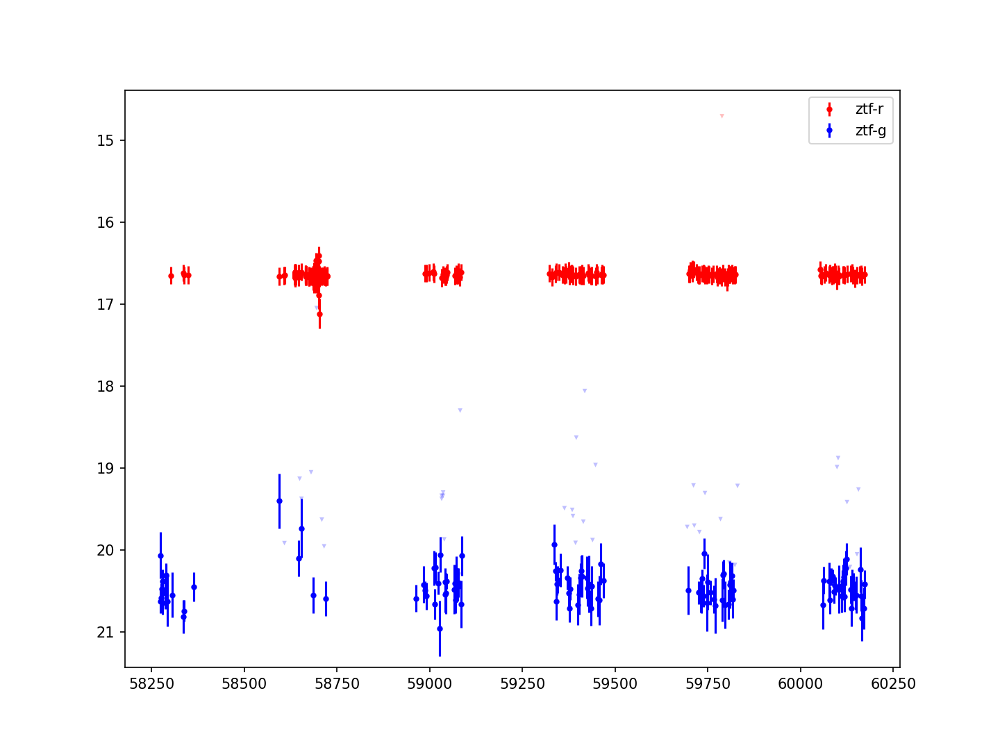

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.02009166667%2C+-24.78025&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253996


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


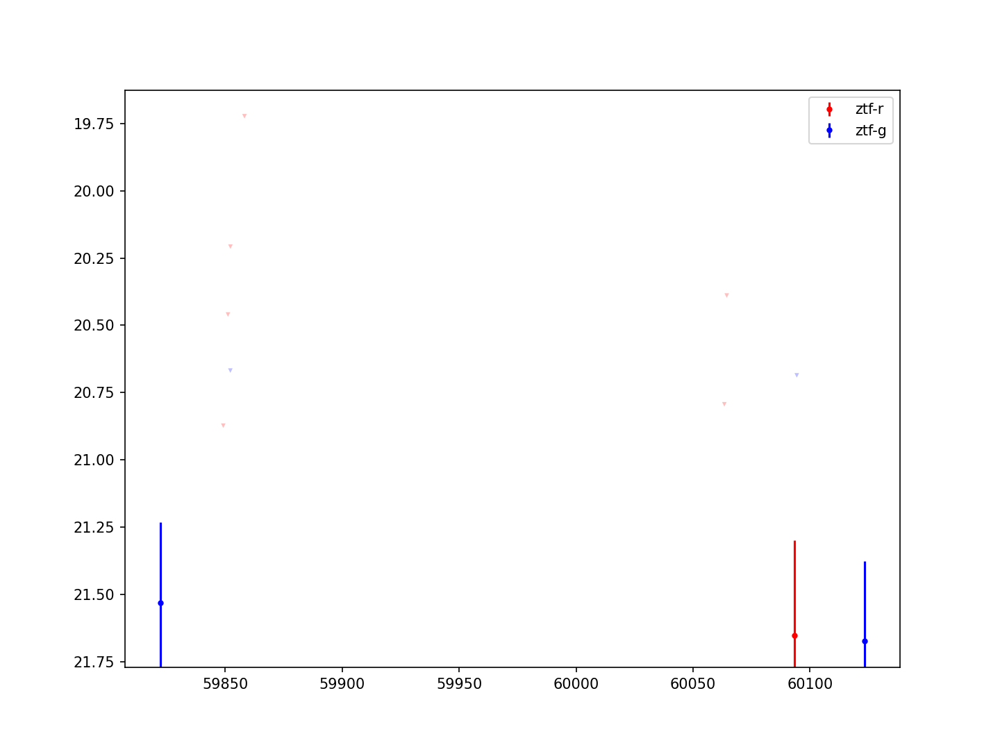

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=268.36787888657%2C+-1.45175364344&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253997


<IPython.core.display.Javascript object>


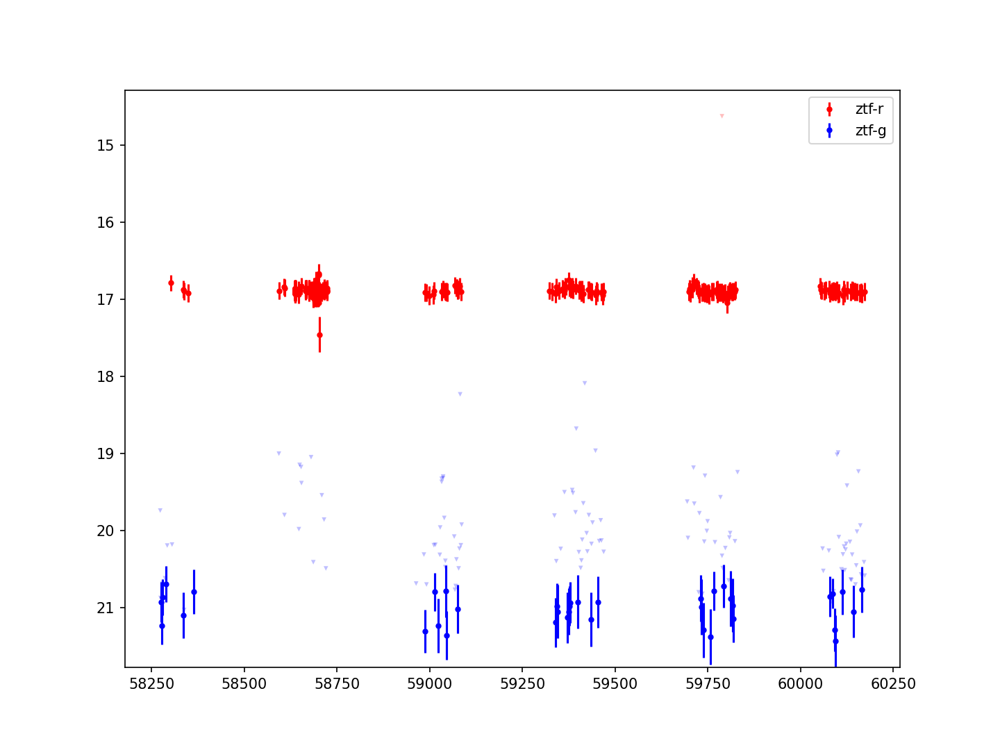

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.0190625%2C+-24.77836666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253998


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


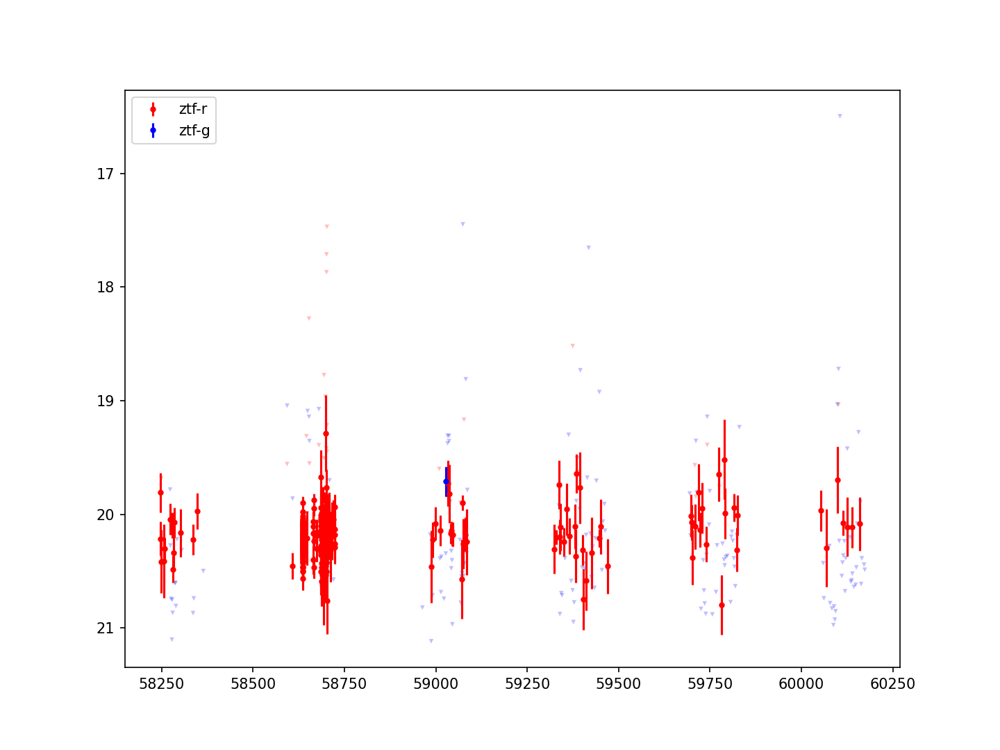

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=266.9837375%2C+-26.56370833333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 253999


<IPython.core.display.Javascript object>


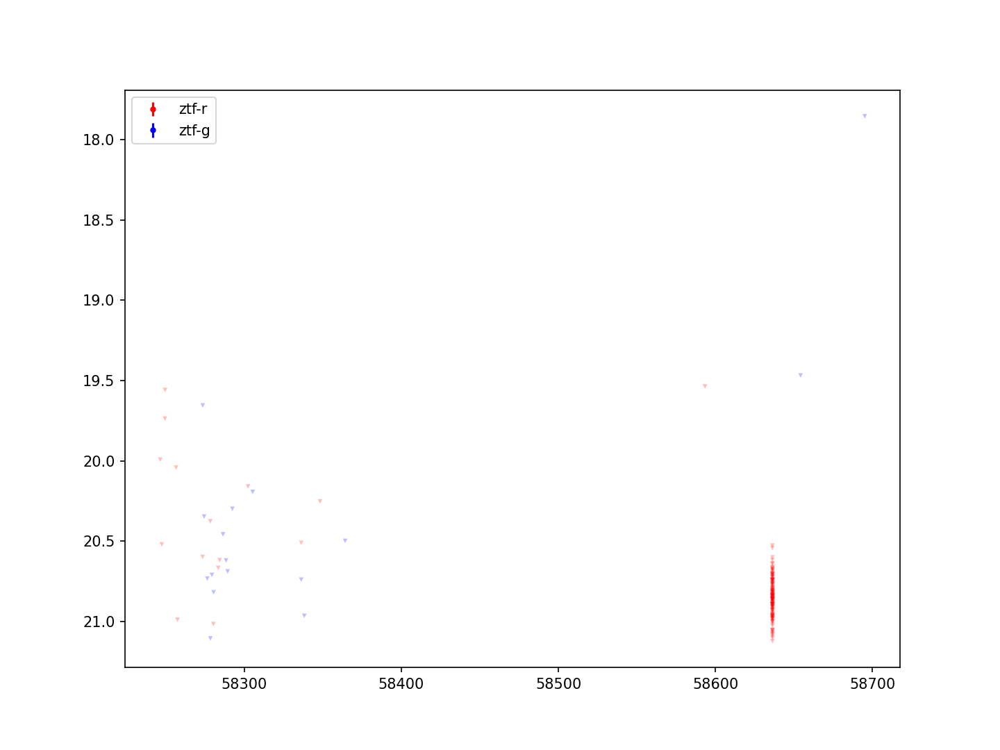

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.23220833333%2C+-24.89447222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254000


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


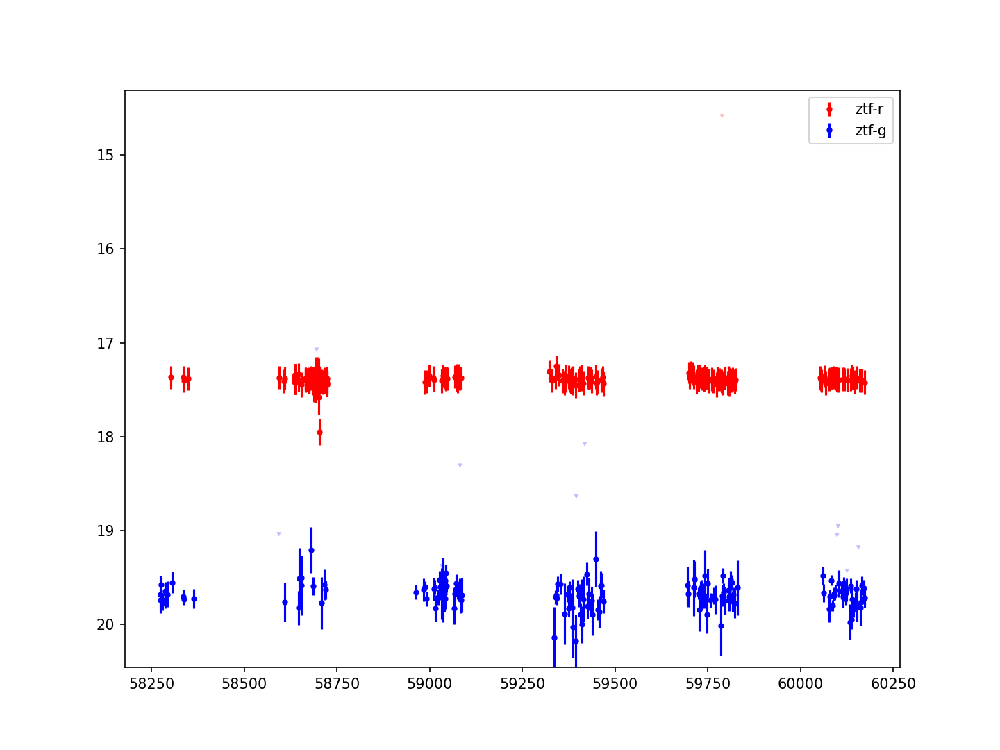

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.02254166667%2C+-24.77713055556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254002


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


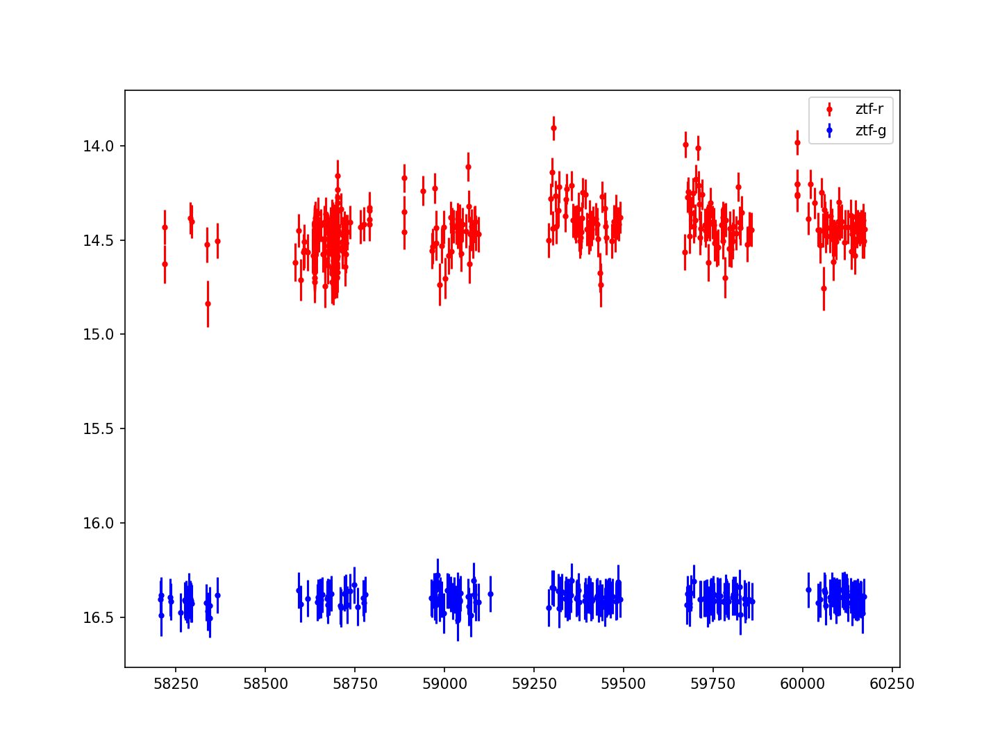

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.2215875%2C+-20.36077222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254003


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


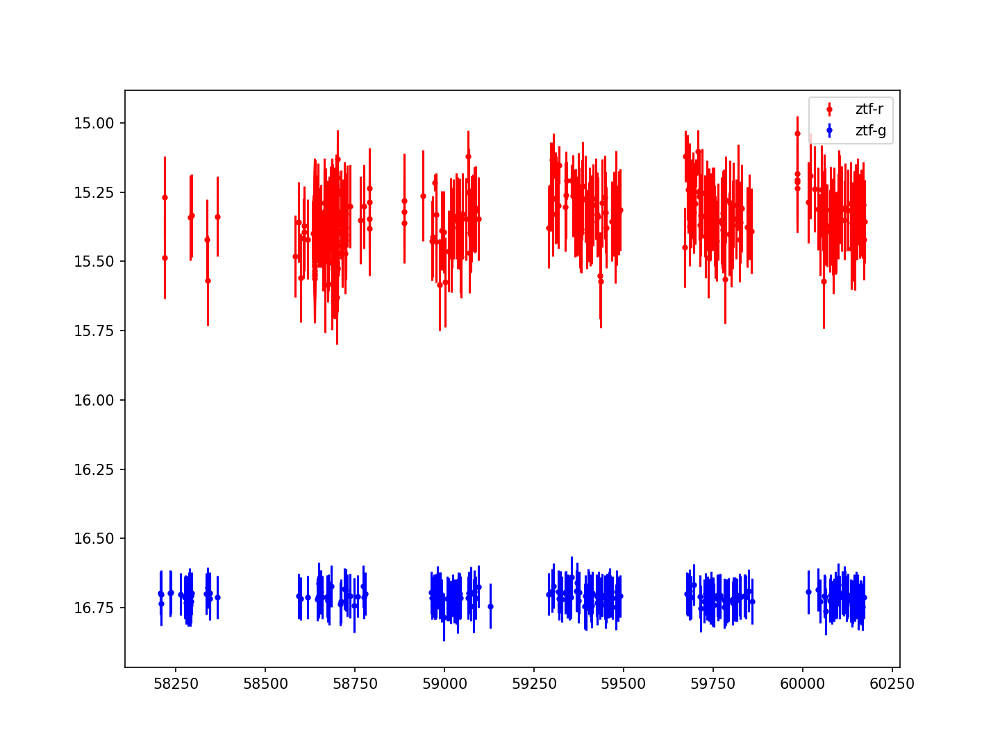

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.22134583333%2C+-20.35750833333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254004


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


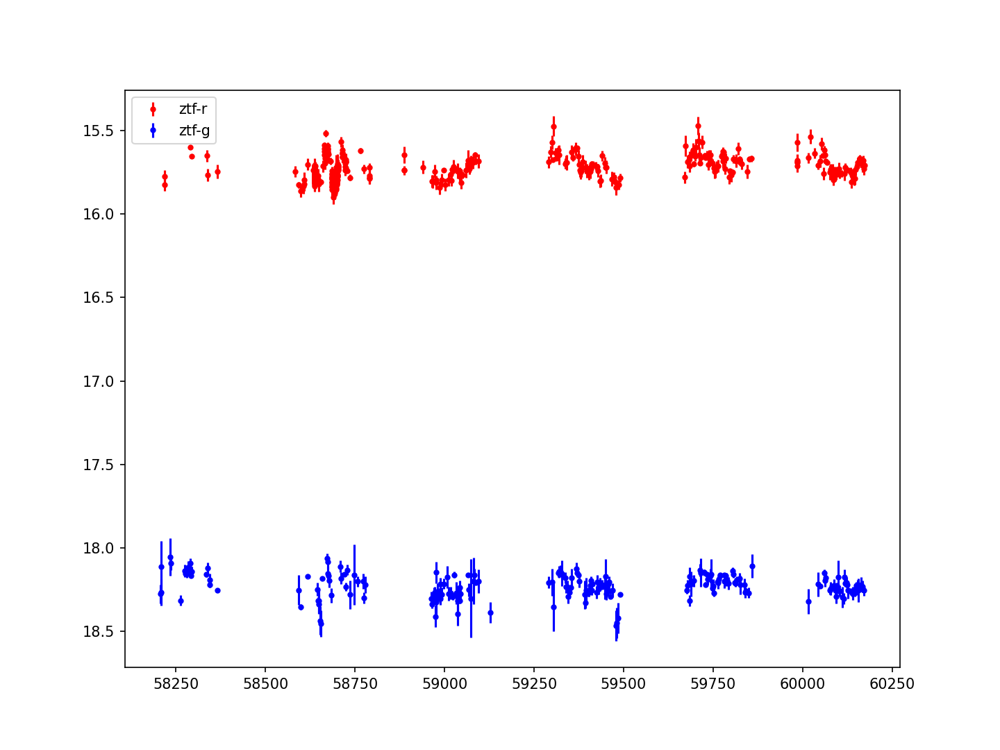

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.22308333333%2C+-20.36722222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254005


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


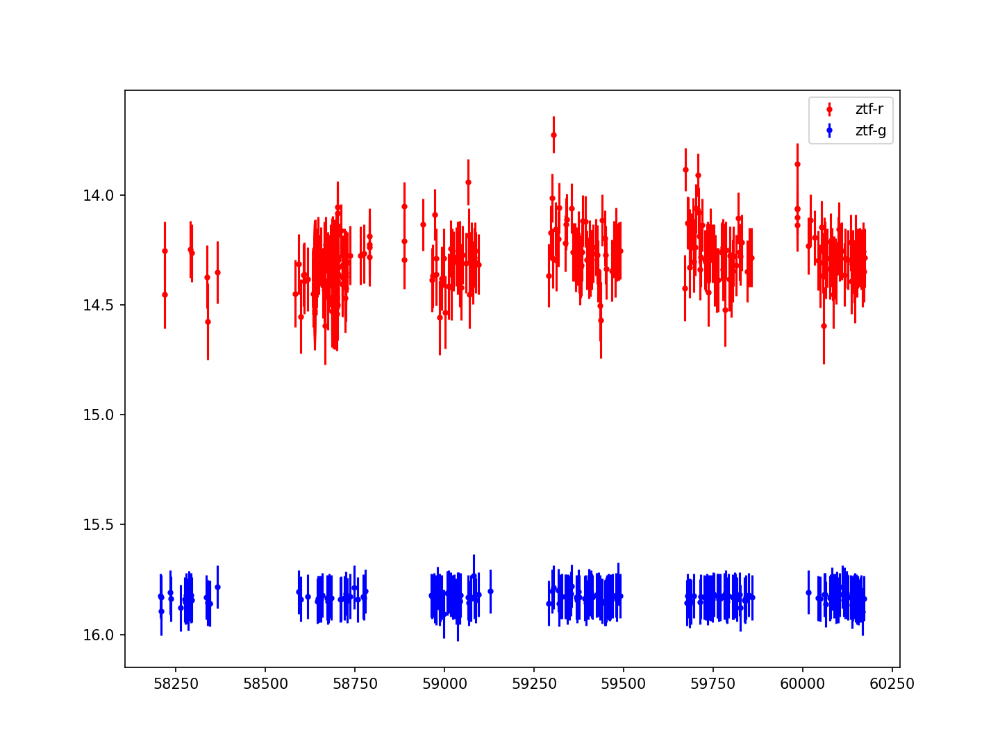

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.22030833333%2C+-20.36183611111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254006


<IPython.core.display.Javascript object>


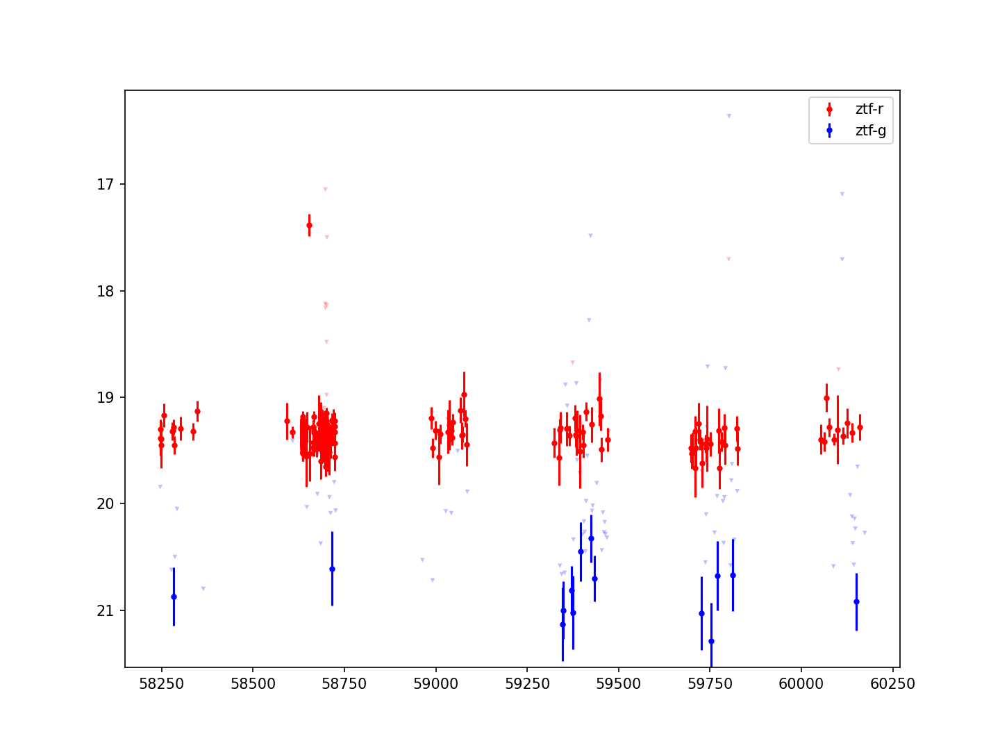

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=268.56029166667%2C+-27.90981666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254008


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


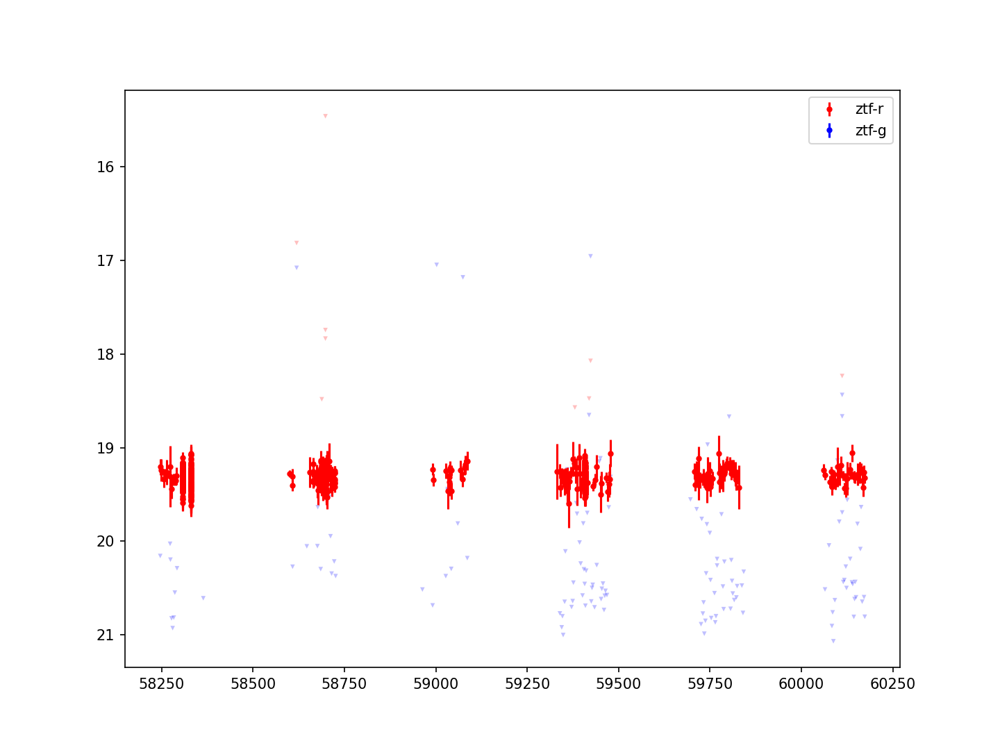

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=269.76195833333%2C+-23.71894444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254009


<IPython.core.display.Javascript object>


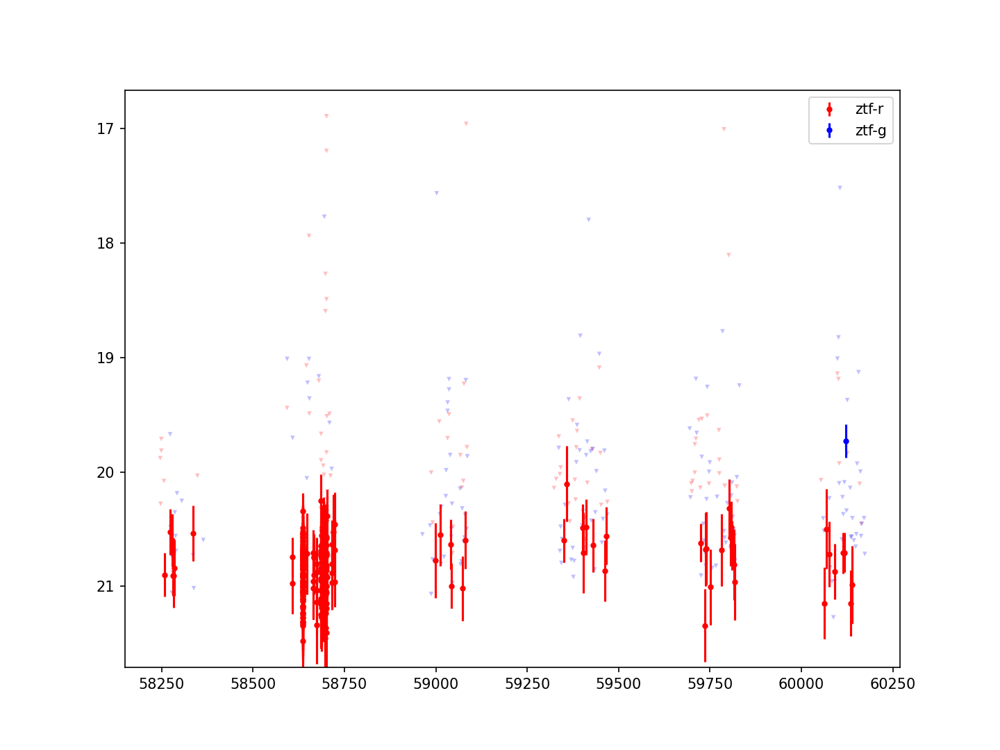

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=268.38279166667%2C+-23.82078611111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254011


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


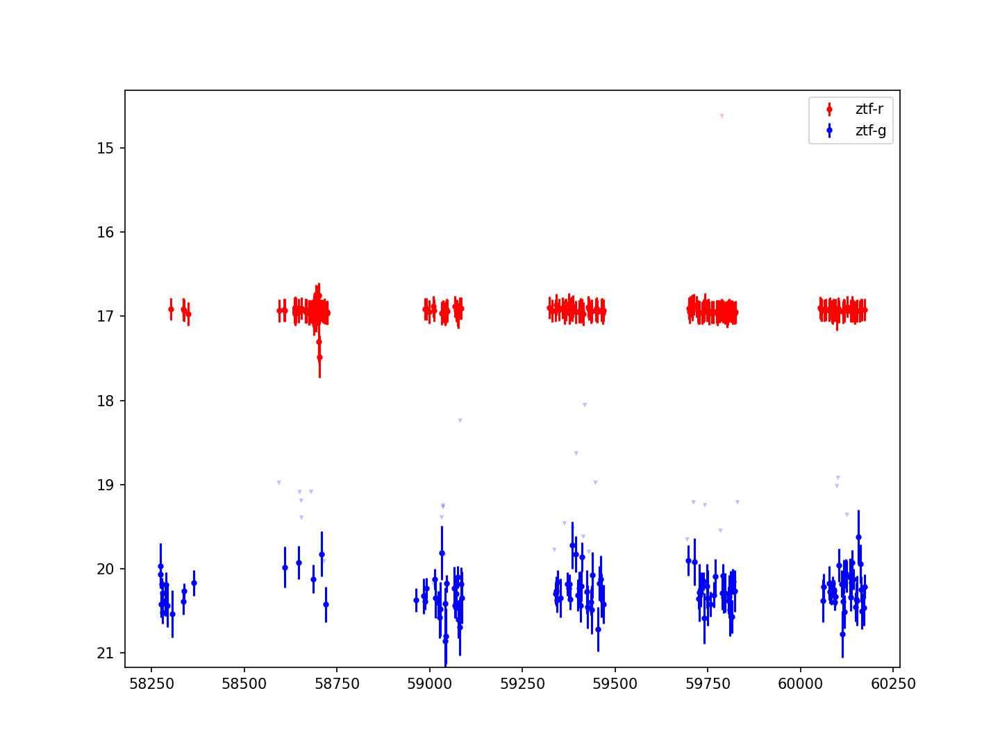

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.02089583333%2C+-24.77885277778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254014


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


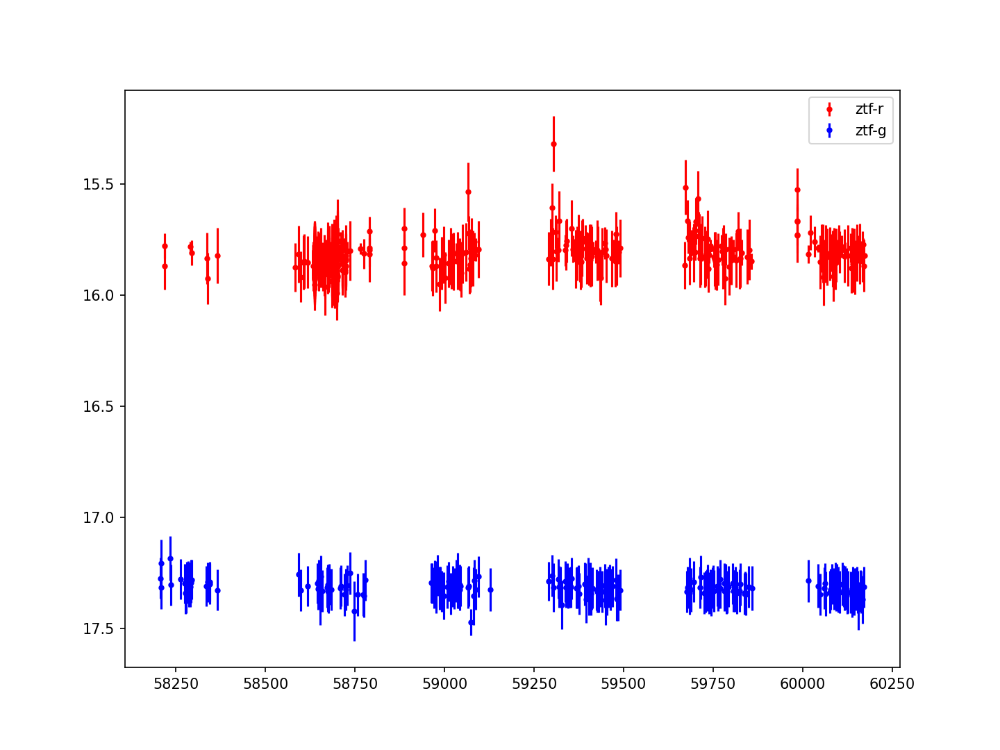

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.216125%2C+-20.35940277778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254020


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


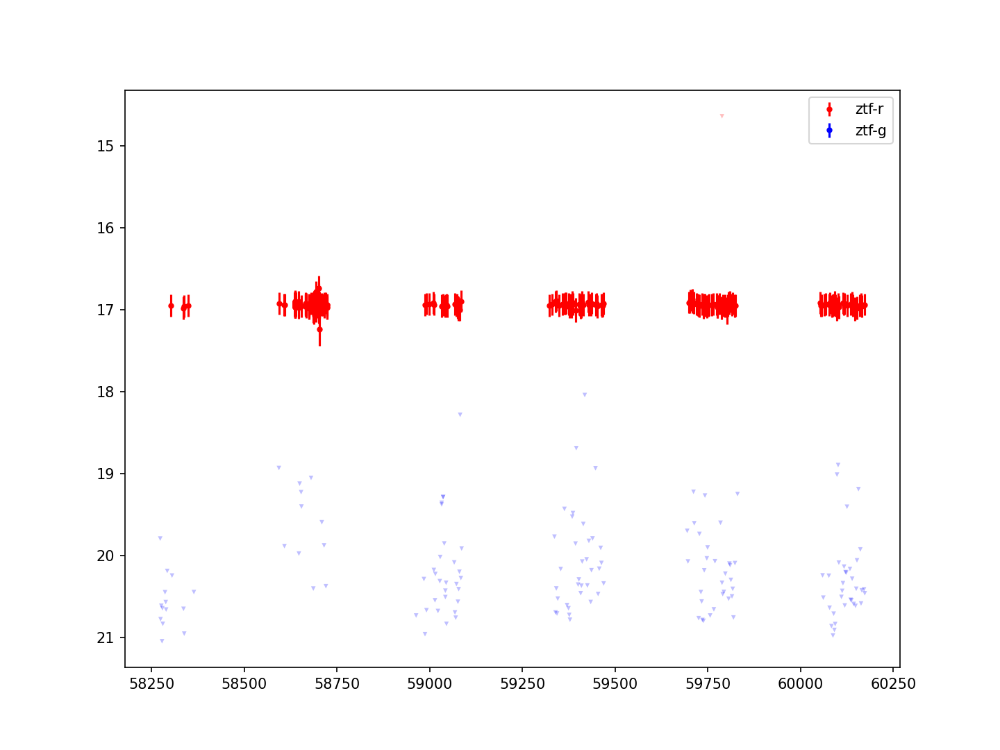

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.02179166667%2C+-24.77988888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254021


<IPython.core.display.Javascript object>


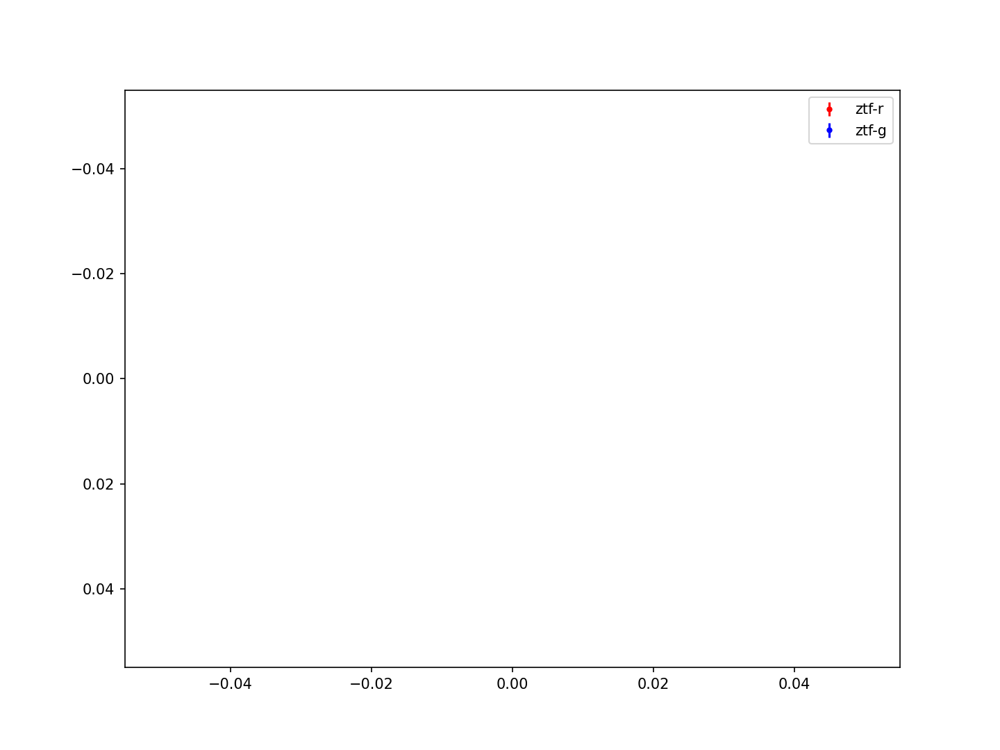

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=268.062875%2C+-22.34233333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254023


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


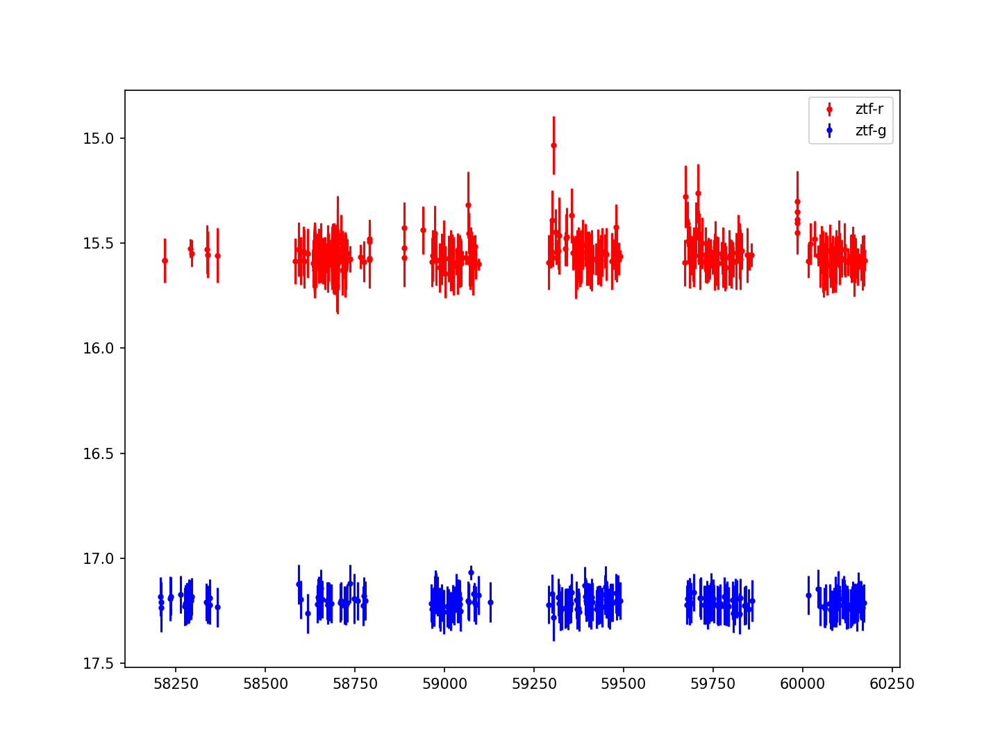

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=267.2173375%2C+-20.35900166667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254024


<IPython.core.display.Javascript object>


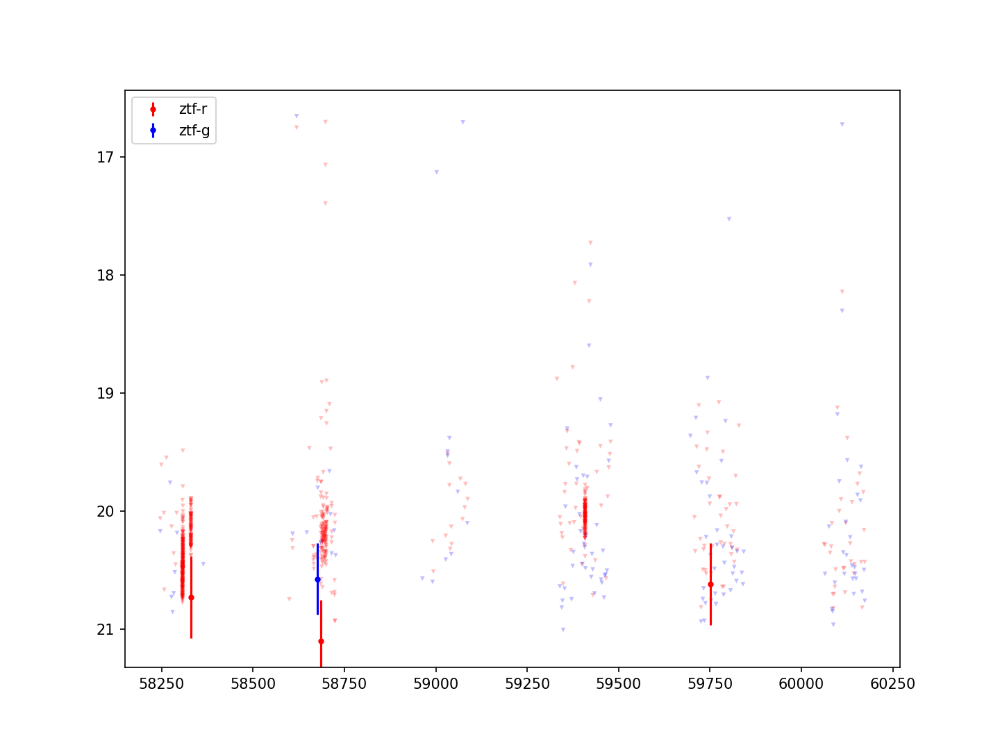

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=269.23833333333%2C+-25.10780555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254026


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


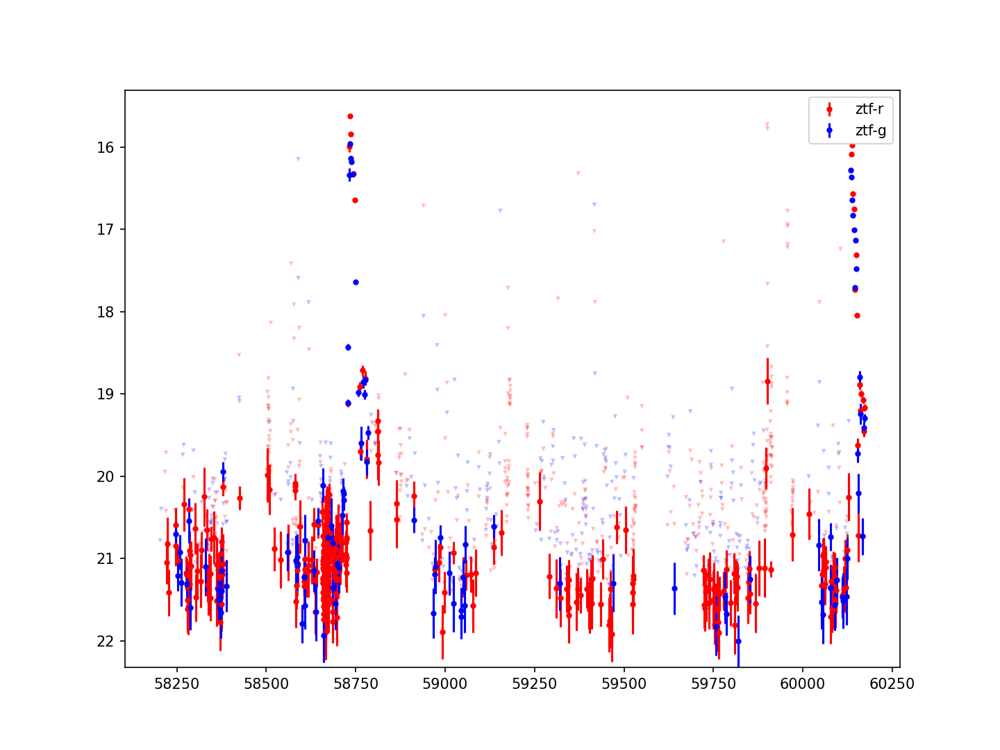

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=272.0314404034%2C+13.25150285125&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254112


<IPython.core.display.Javascript object>


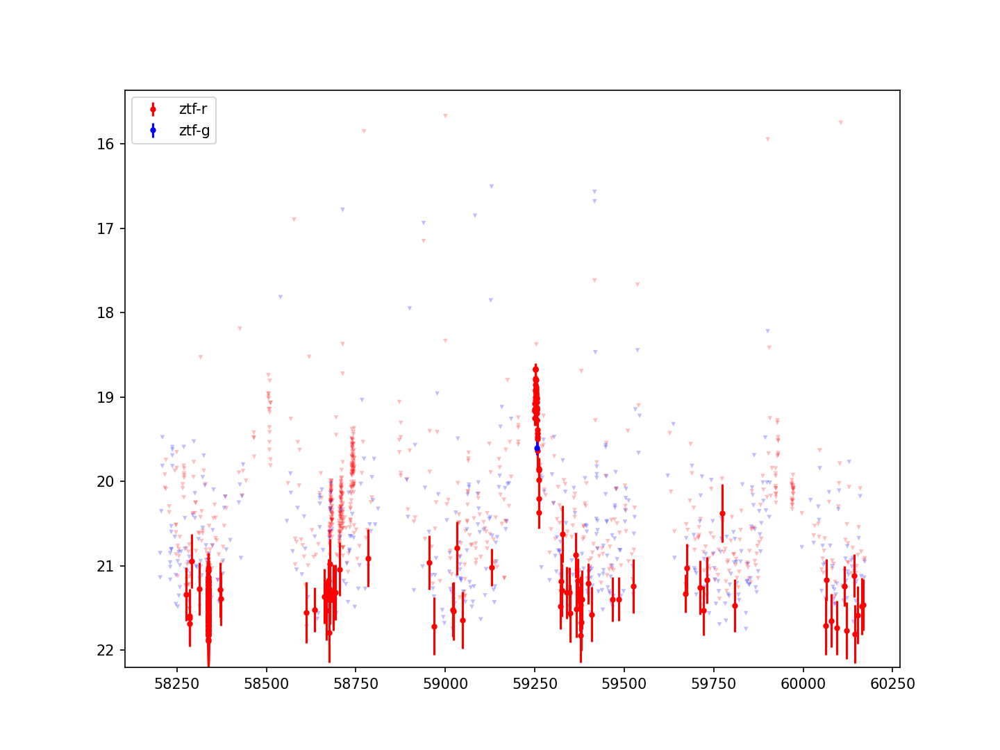

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=284.67325%2C+22.65816666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254113


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


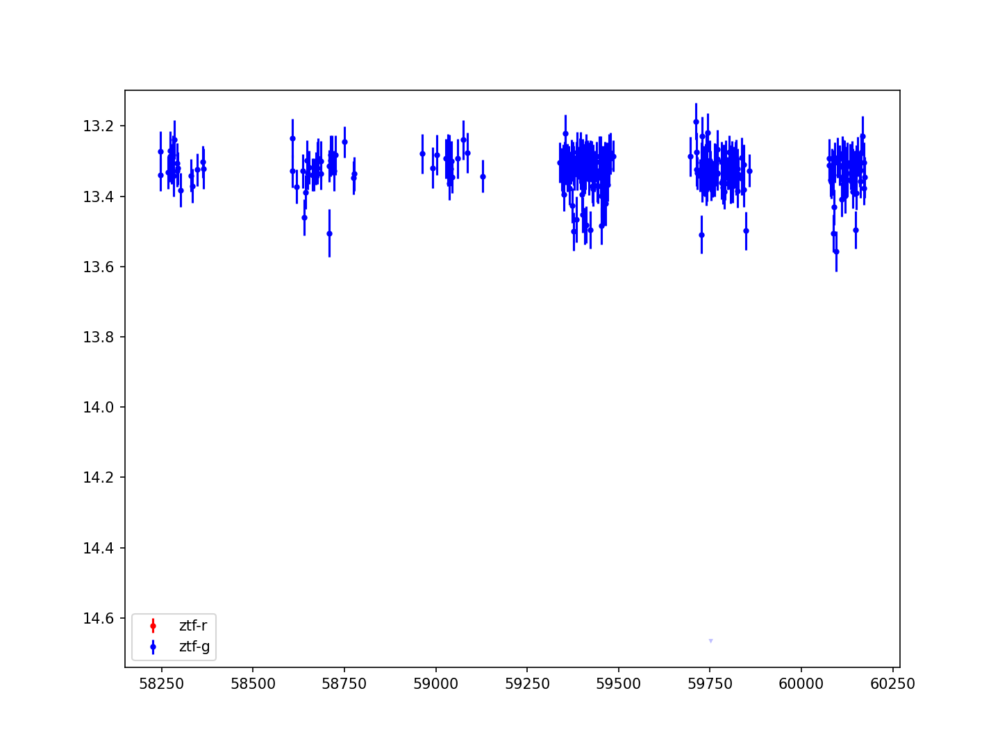

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.1354525%2C+-24.8688122&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254114


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


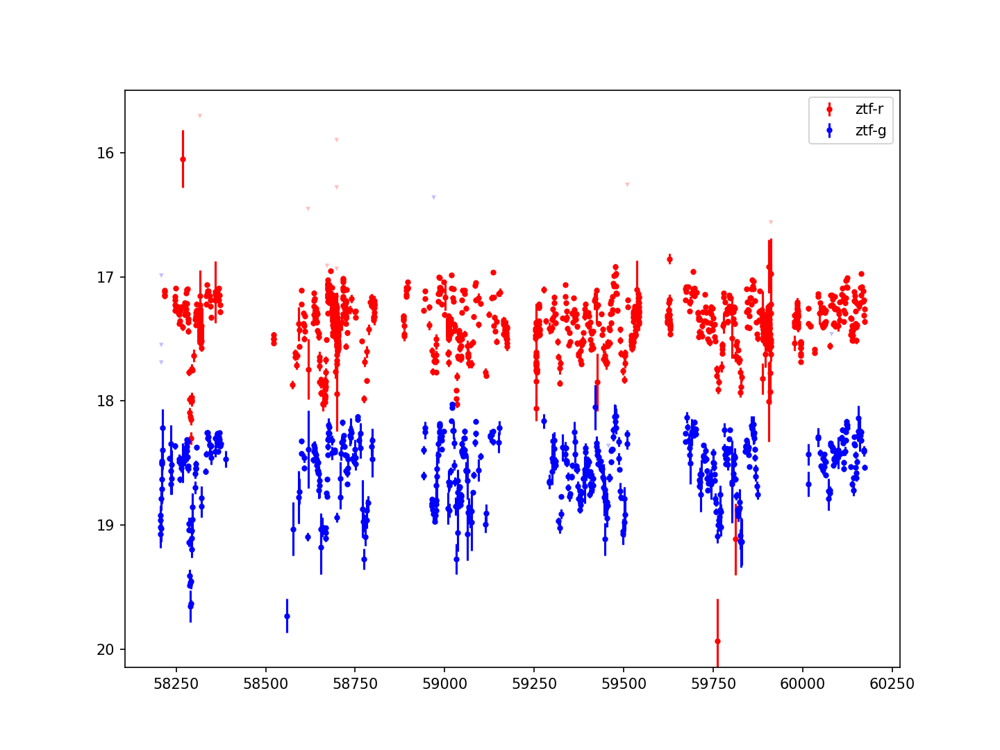

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=277.22756166806%2C+-11.44899508524&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254115


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


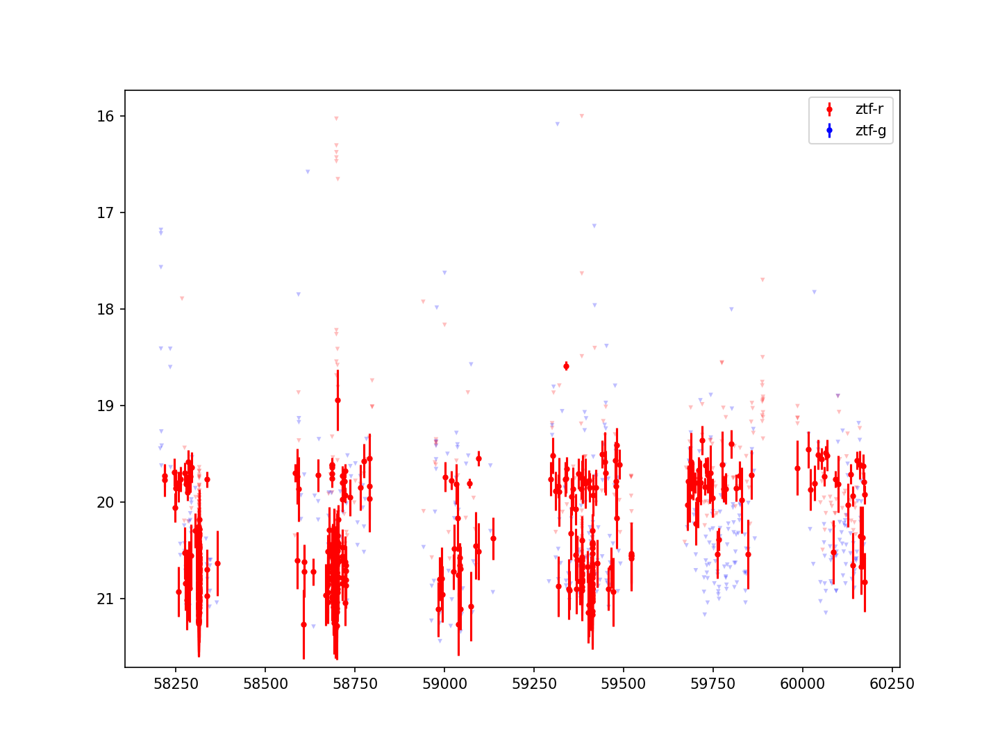

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=273.0405647%2C+-19.0406855&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254116


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


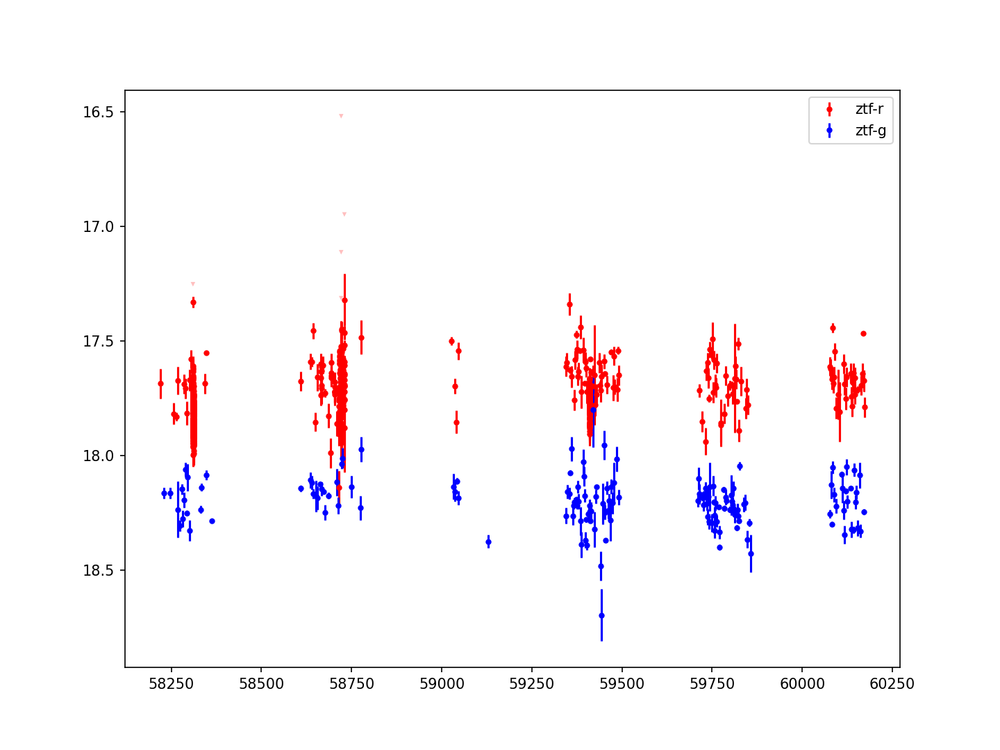

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=277.3675%2C+-23.79697222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254117


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


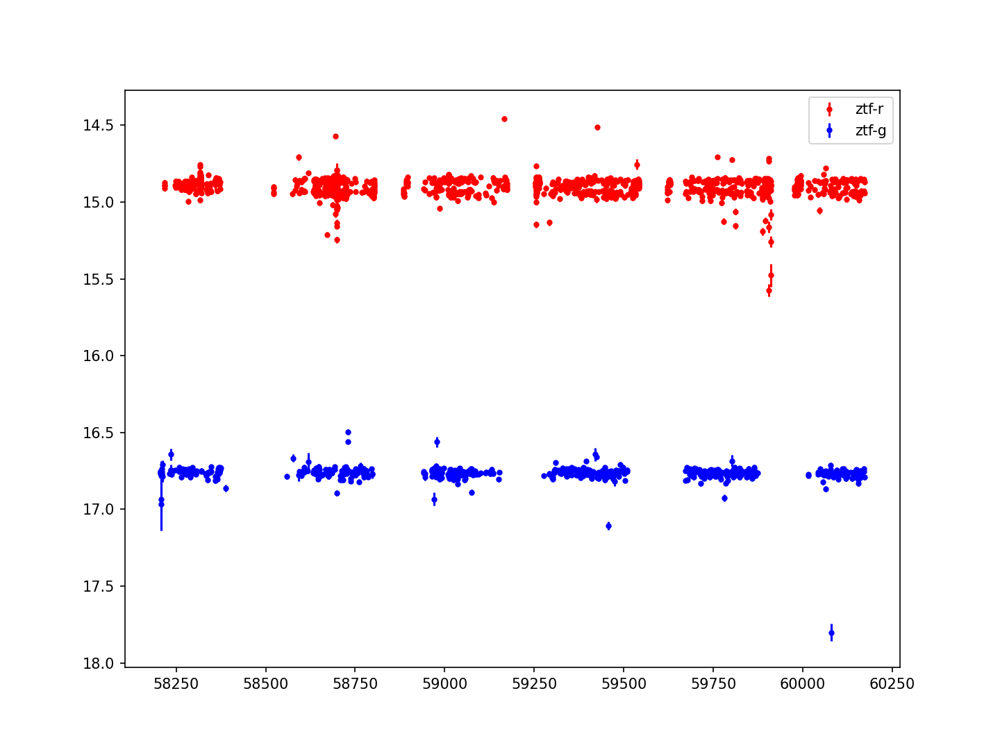

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=277.14073429454%2C+-10.61771826908&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254118


<IPython.core.display.Javascript object>


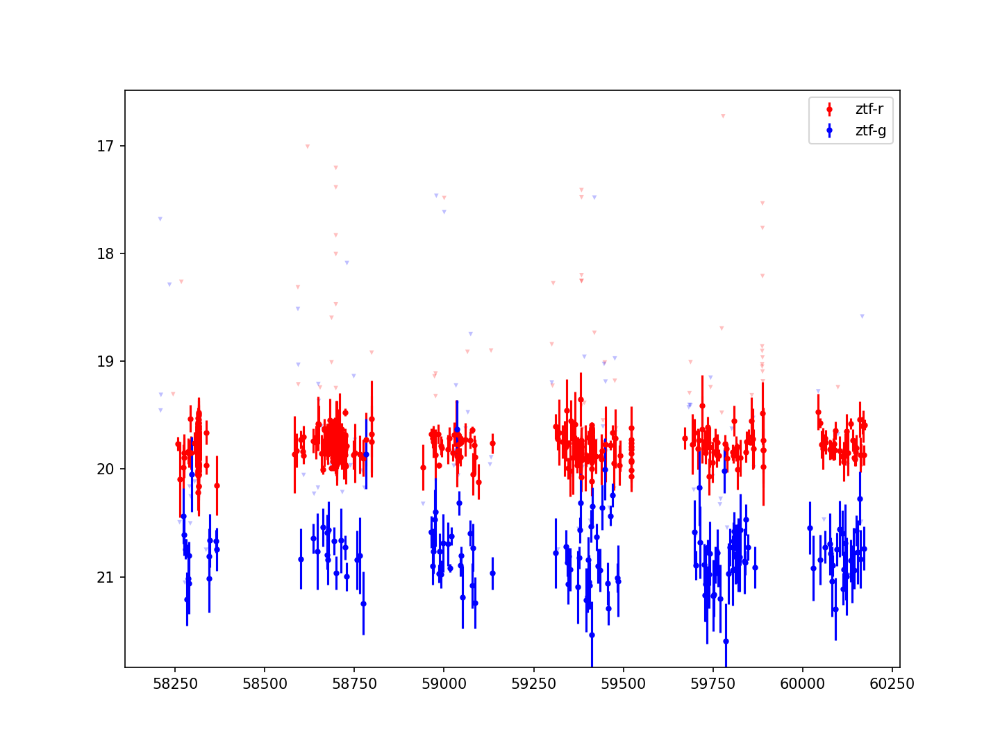

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=278.93095833333%2C+-19.32002777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254119


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


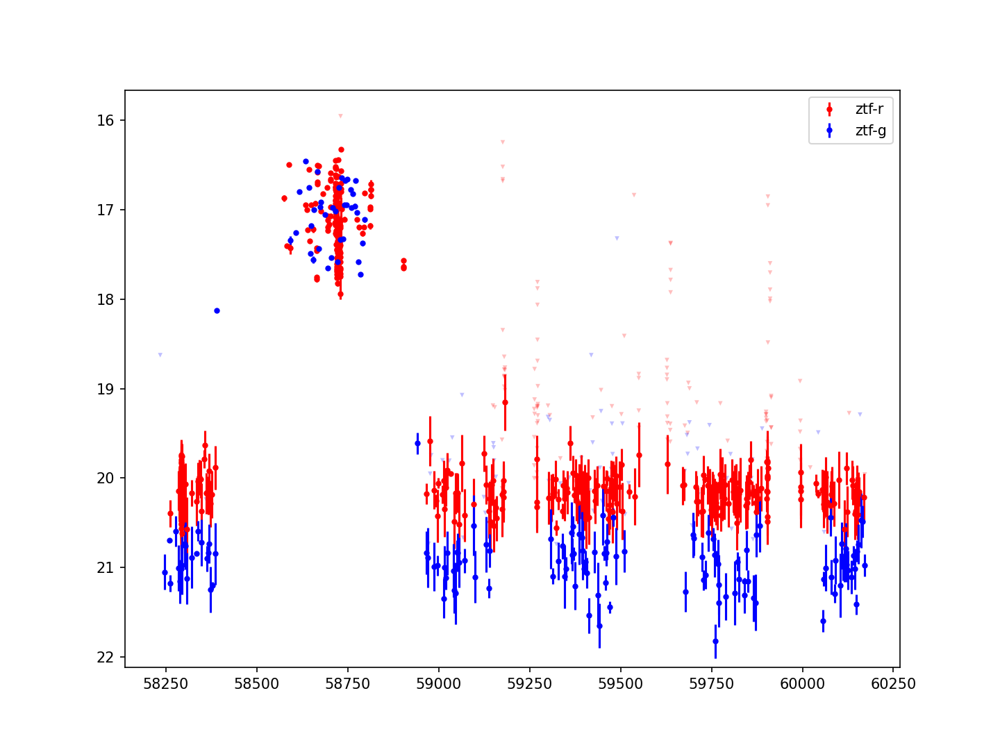

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=284.64546201086%2C+-8.23748601144&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254120


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


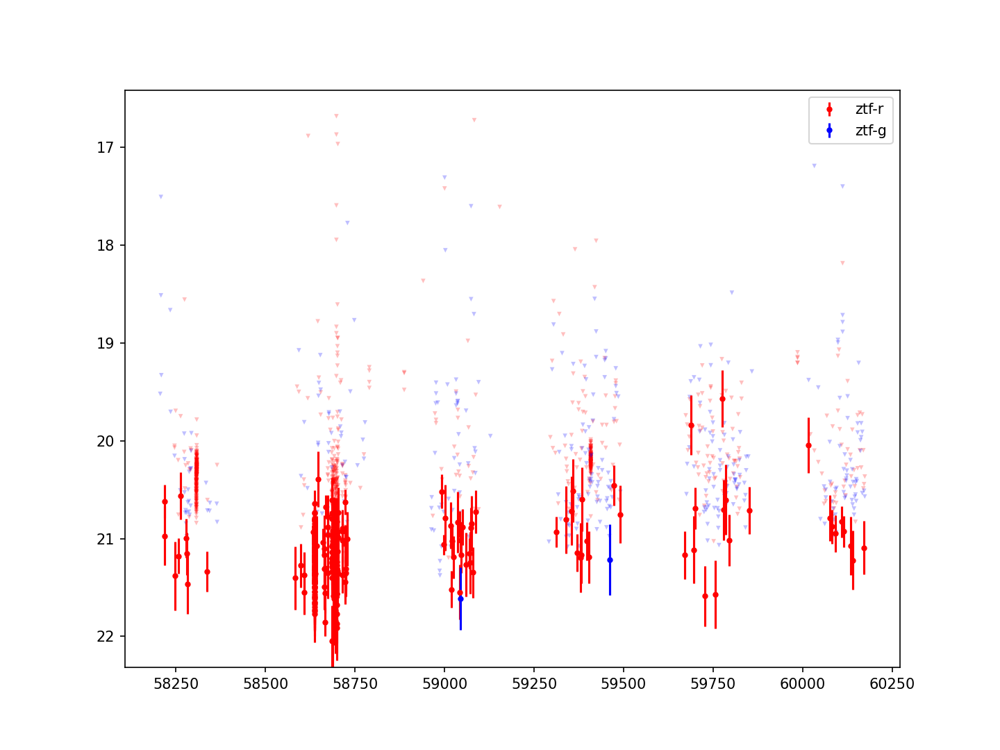

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=270.38395833333%2C+-20.5295&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254124


<IPython.core.display.Javascript object>


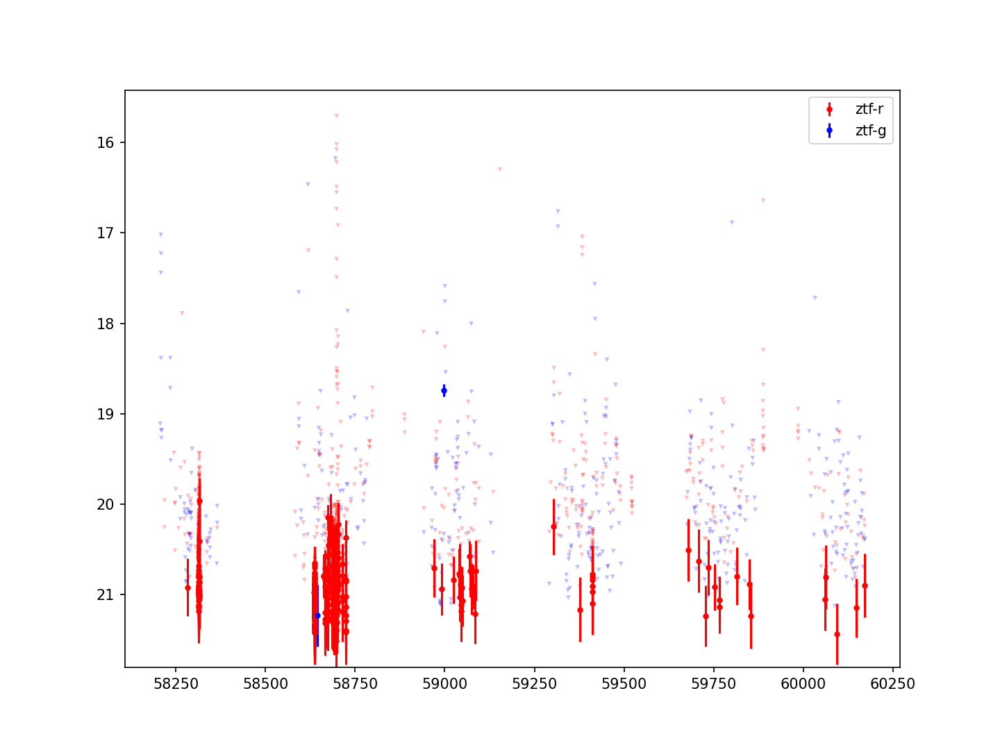

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=273.116531%2C+-18.209773&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254125


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


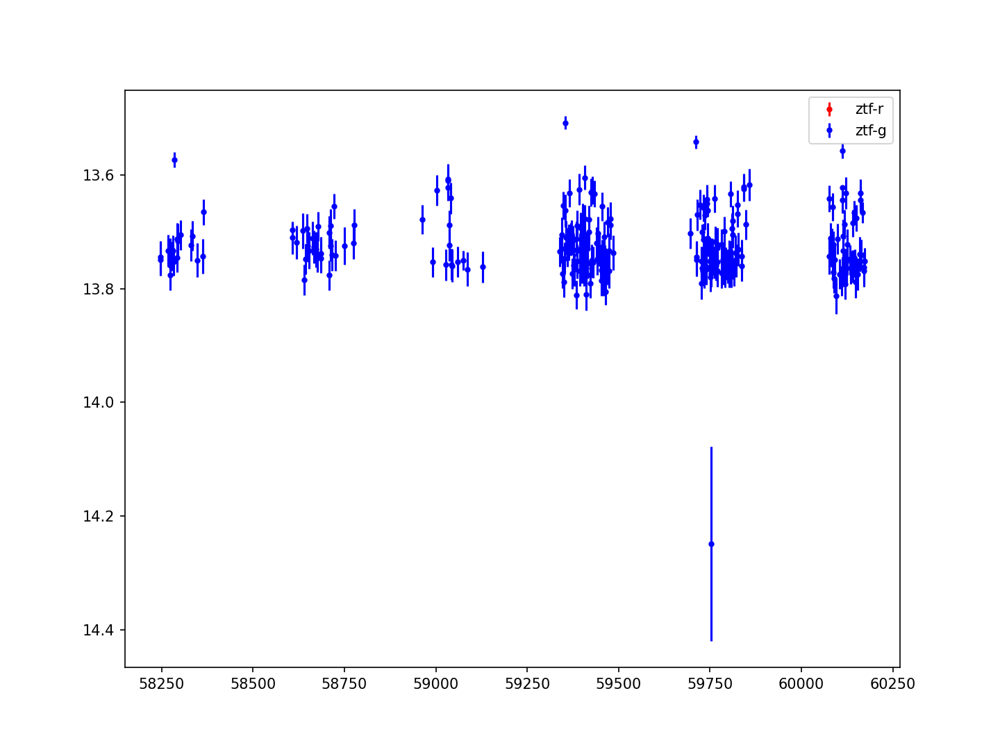

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.13595833333%2C+-24.87269444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254126


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


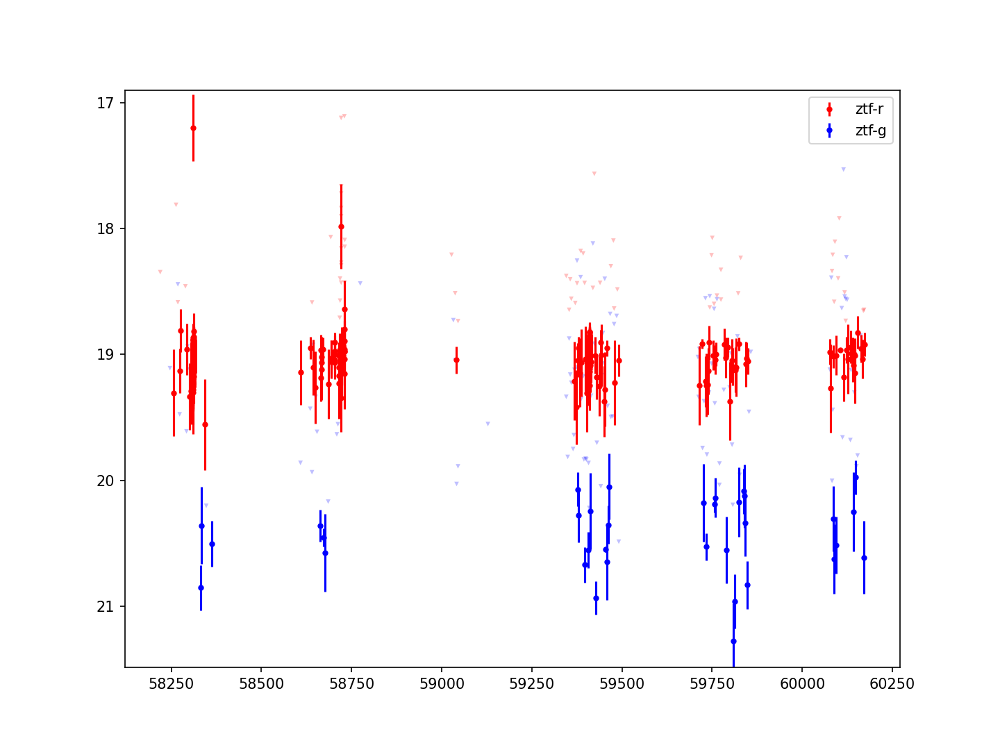

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=277.24195833333%2C+-25.02941111111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254127


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


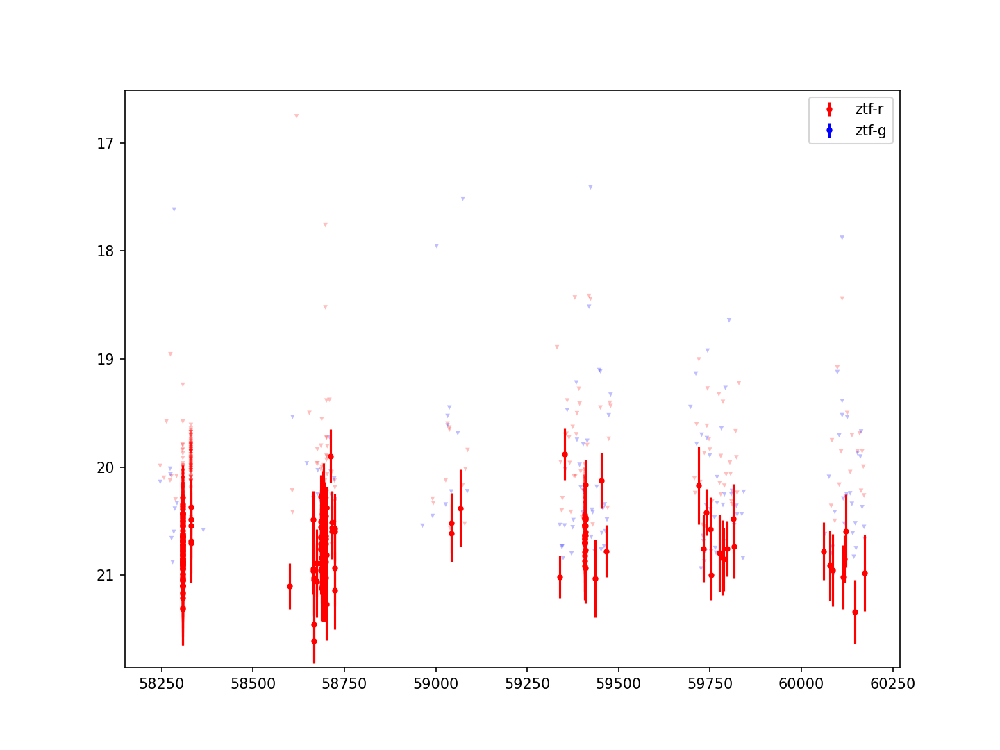

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=271.71133333333%2C+-24.59127777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254128


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


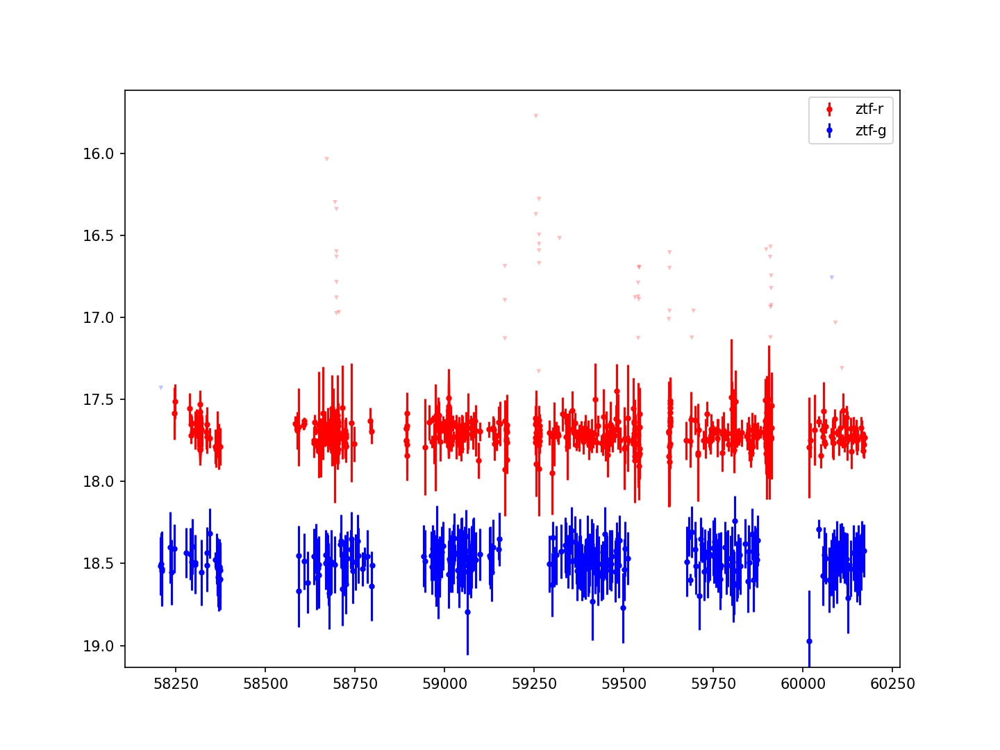

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=283.270275%2C+-8.70565&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254129


<IPython.core.display.Javascript object>


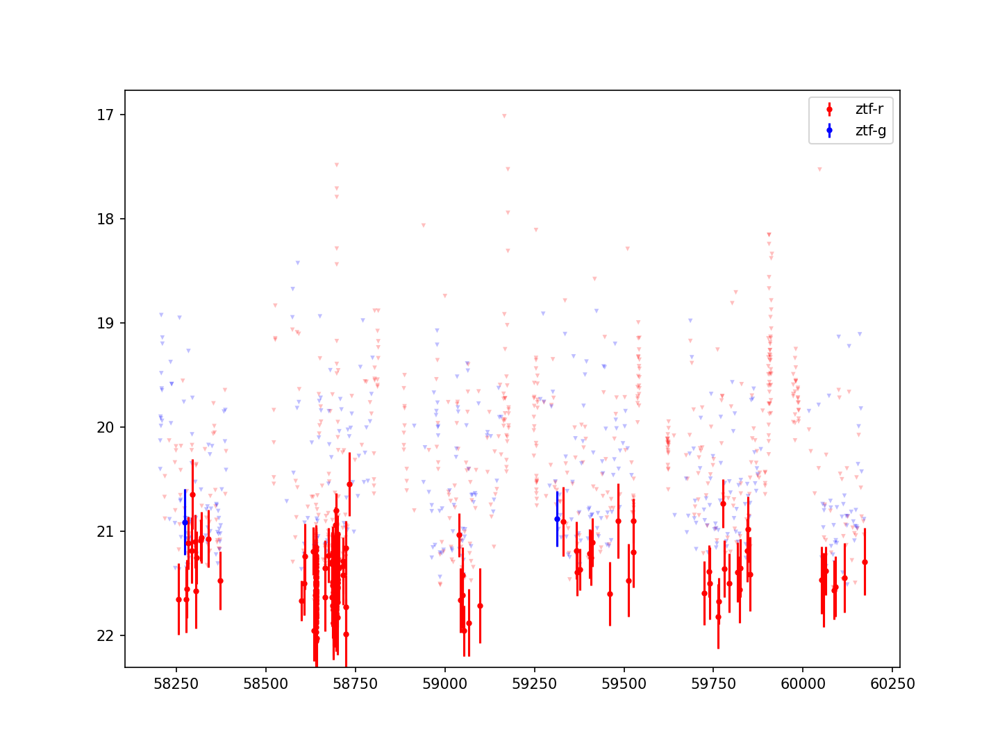

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.34175%2C+-0.01194444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254130


<IPython.core.display.Javascript object>


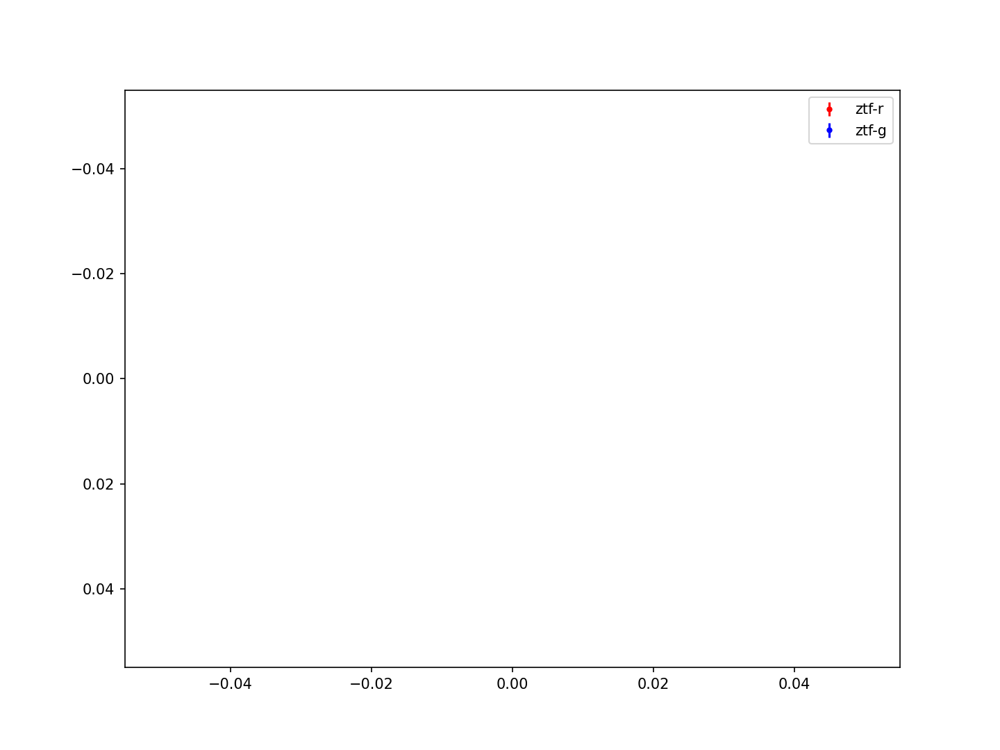

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=271.63404166667%2C+-22.23814444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254131


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


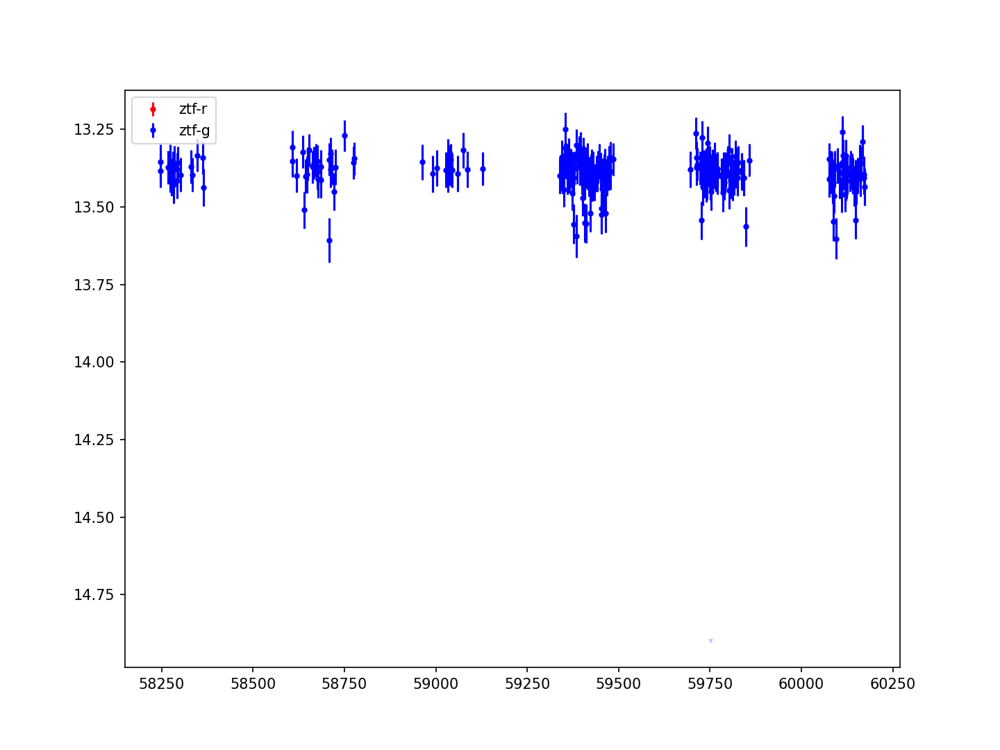

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.13675416667%2C+-24.86896111111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254133


<IPython.core.display.Javascript object>


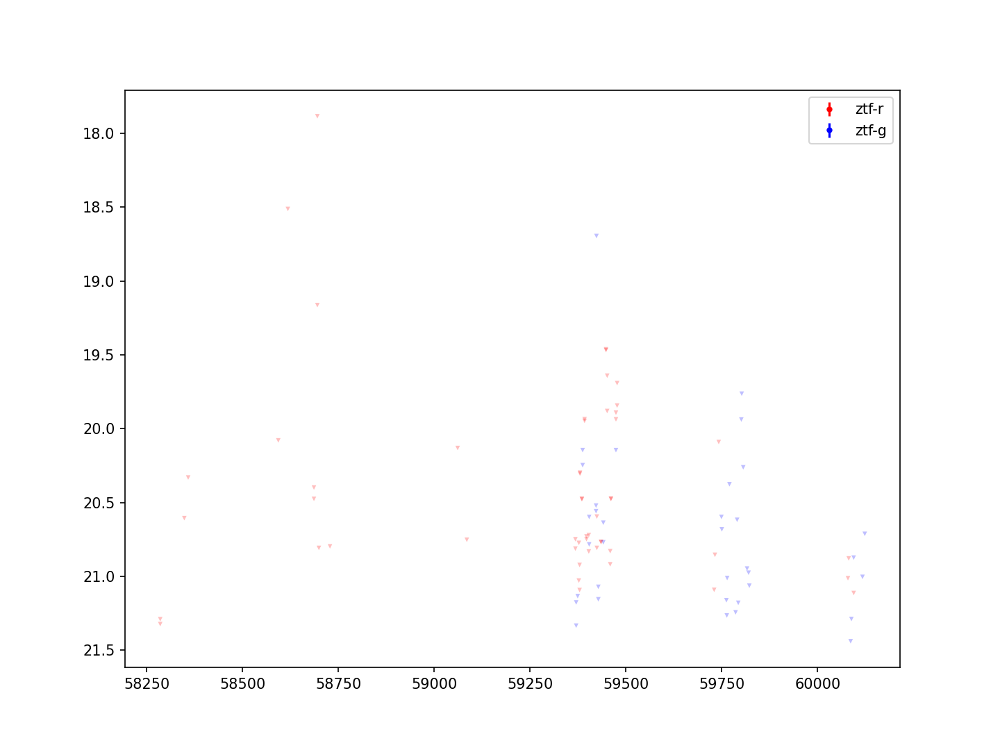

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=283.475%2C+7.45&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254134


<IPython.core.display.Javascript object>


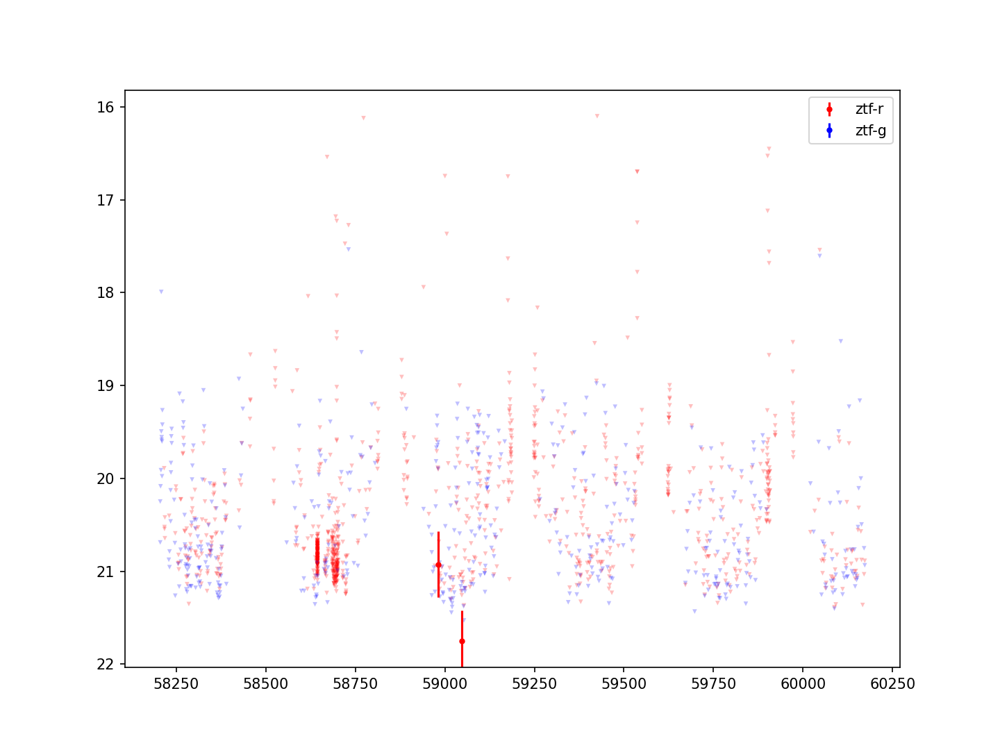

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=284.17875%2C+5.30952777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254135


<IPython.core.display.Javascript object>


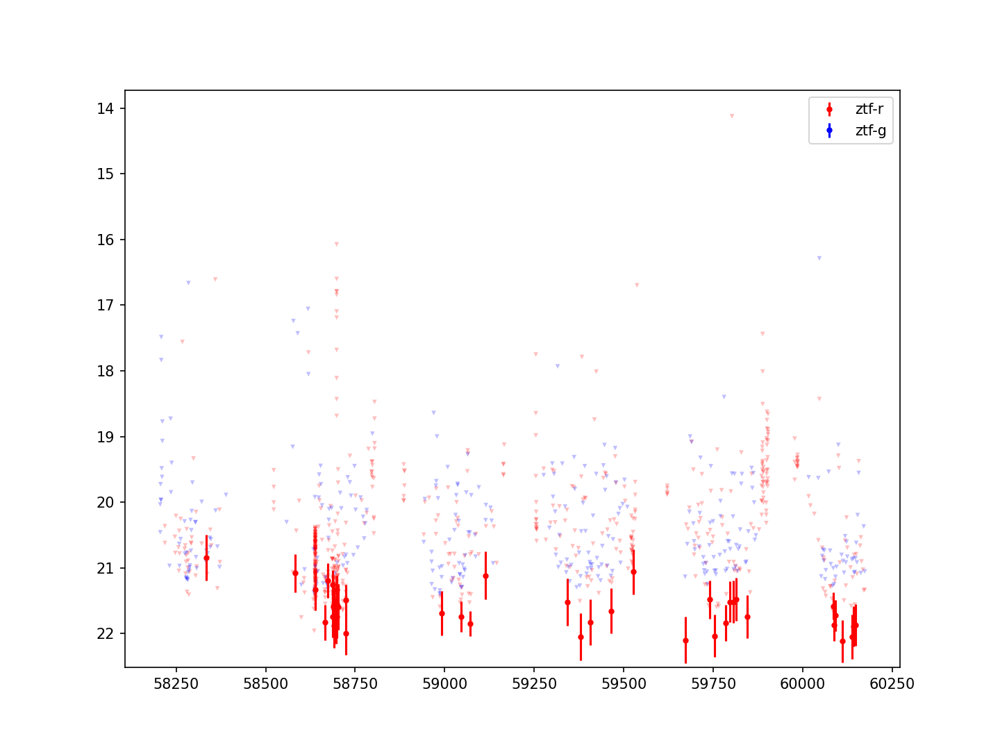

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=273.77575%2C+-12.09641666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254137


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


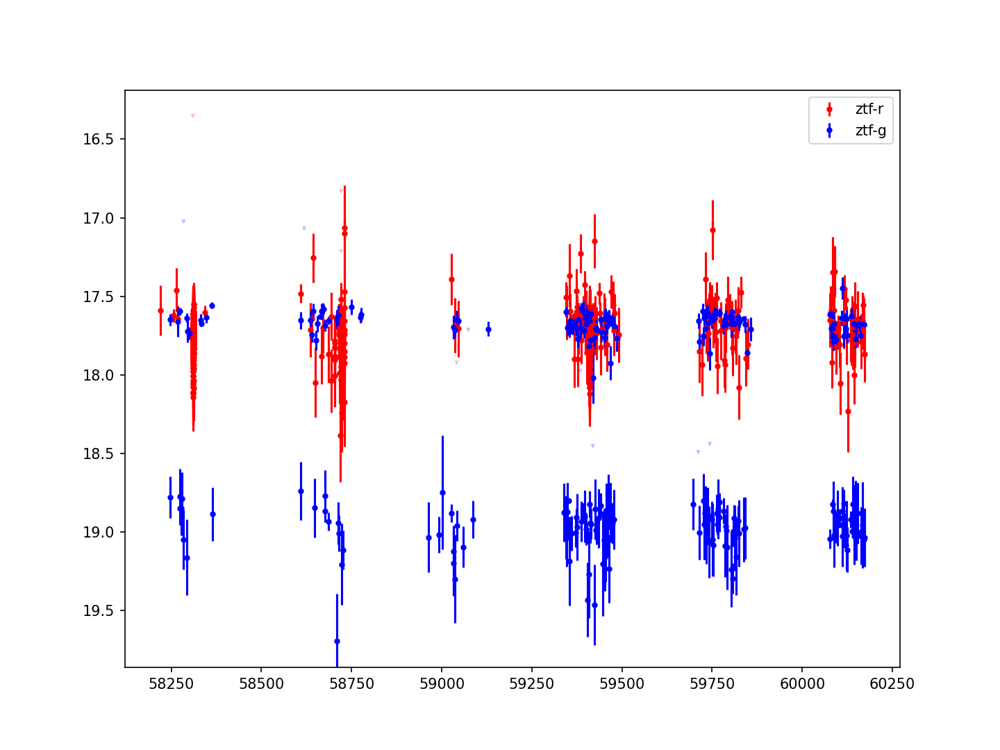

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=276.125%2C+-24.85&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254138


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


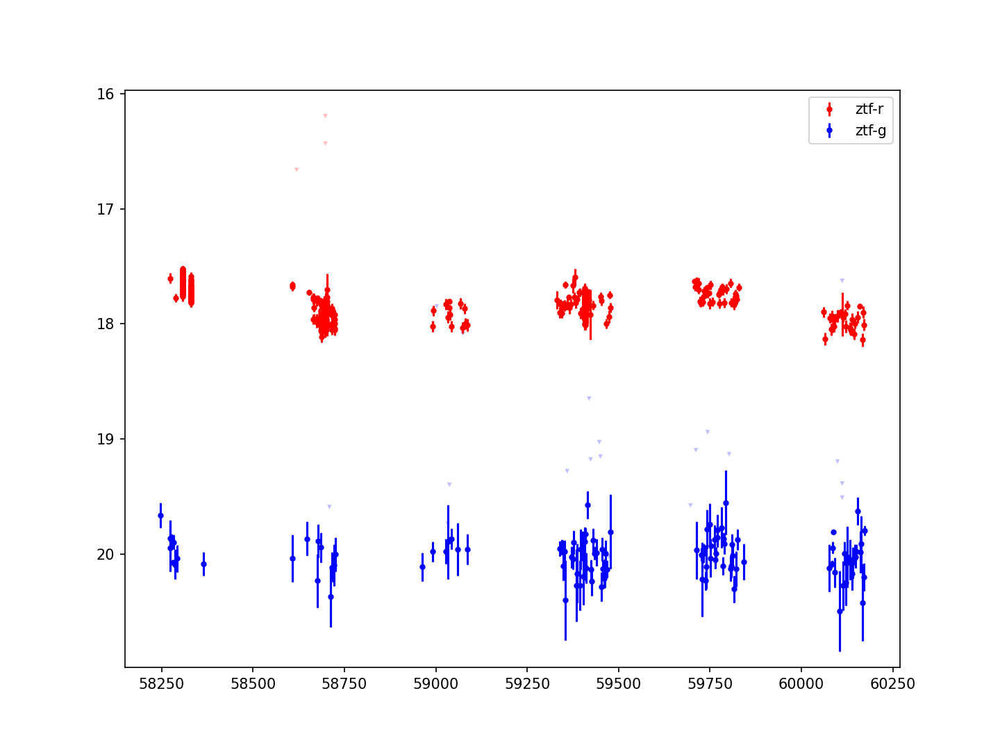

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=273.56145892015%2C+-22.93873976504&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254139


<IPython.core.display.Javascript object>


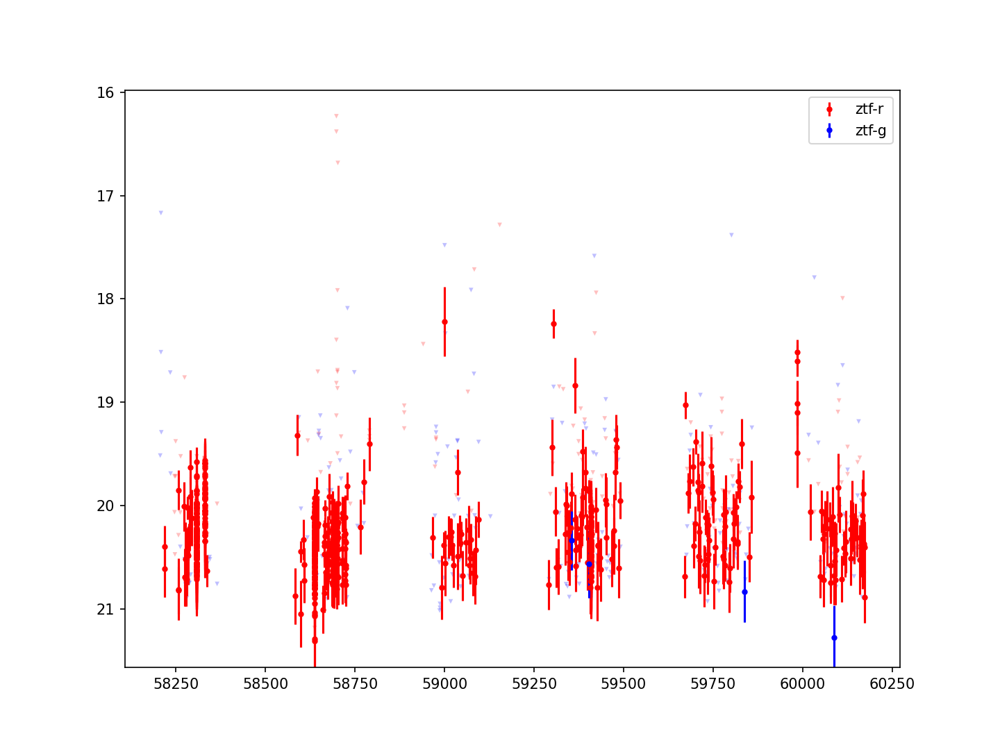

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=271.39166666667%2C+-20.51333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254141


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


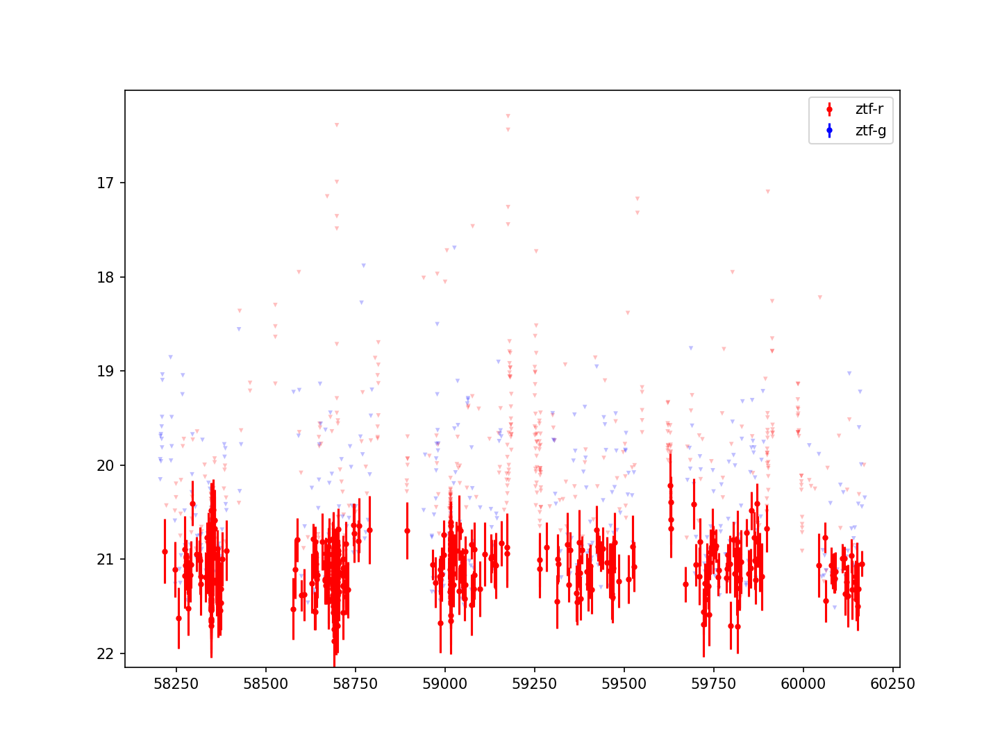

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=282.32102833333%2C+-3.06535&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254142


<IPython.core.display.Javascript object>


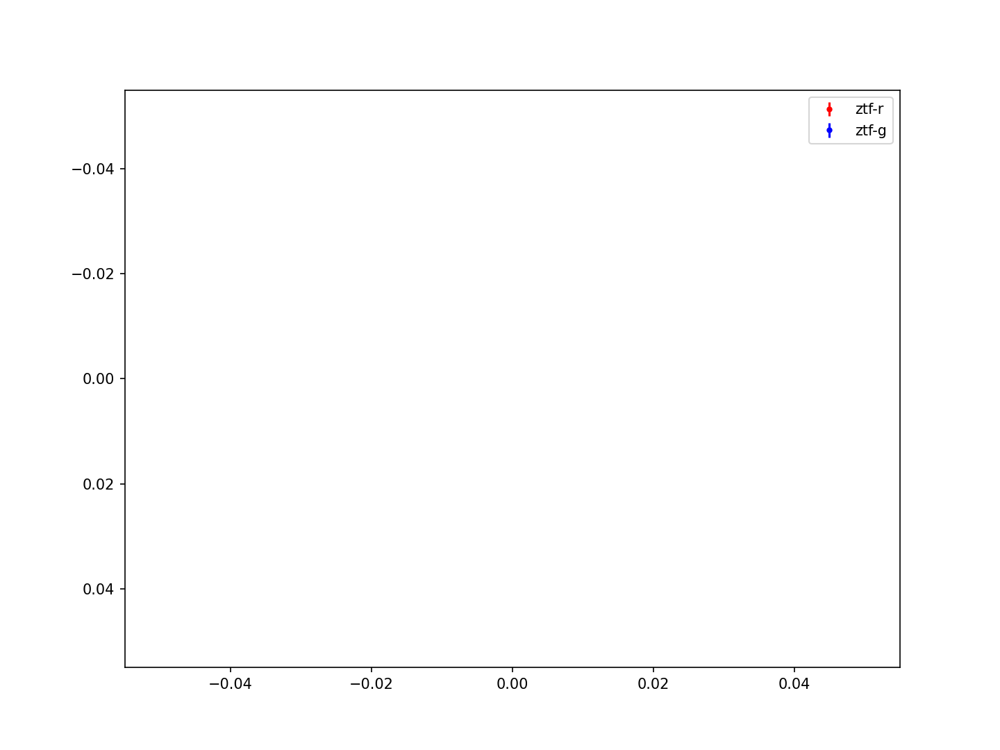

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=282.51373%2C+-0.9398&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254143


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


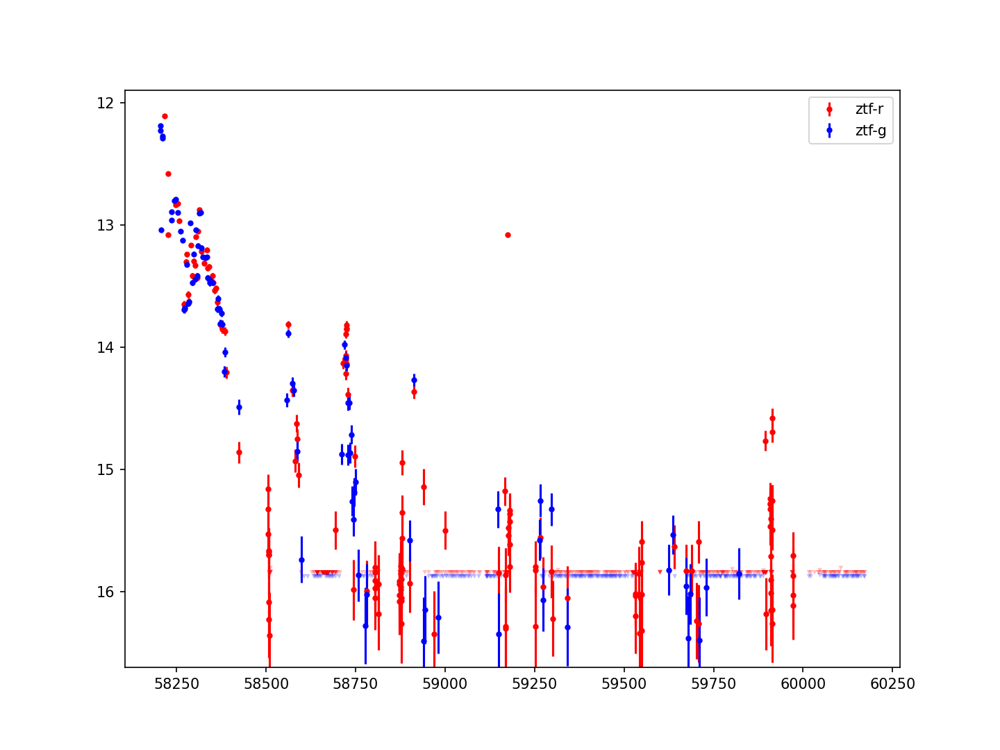

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=275.09141273506%2C+7.18532896893&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254144


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


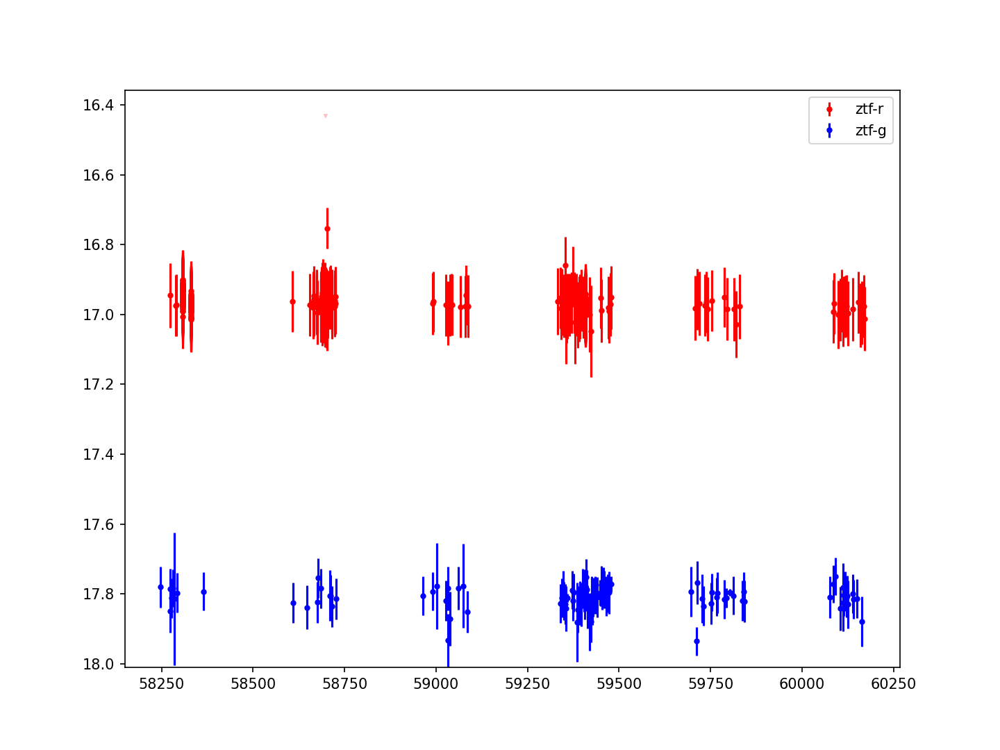

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.60179166667%2C+-24.53830833333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254145


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


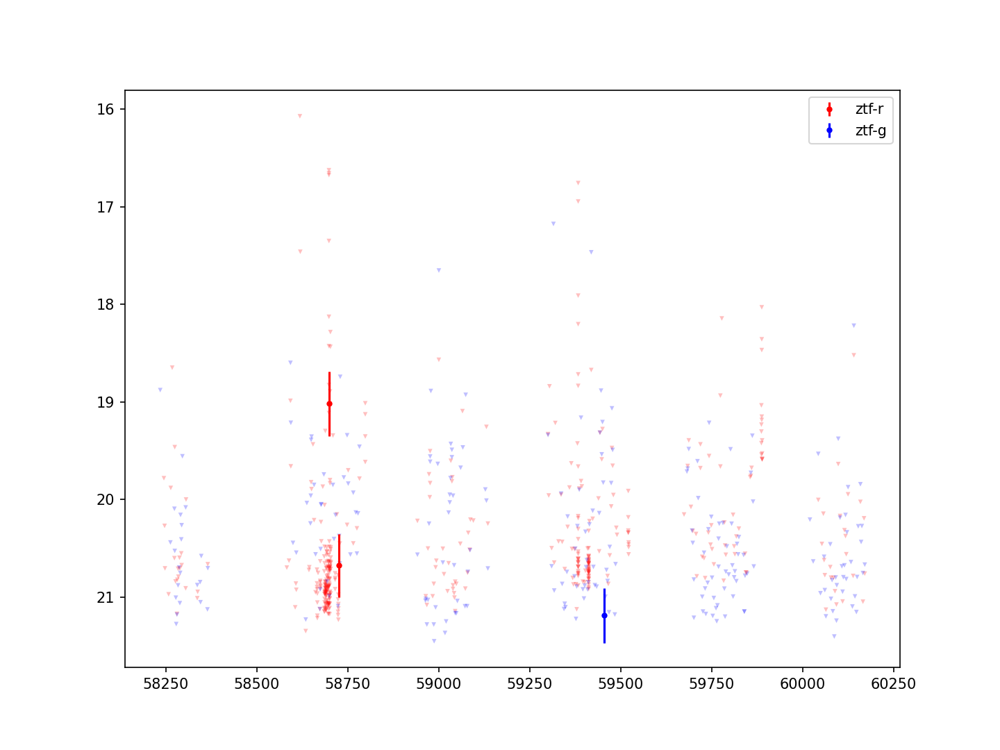

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.39291666667%2C+-15.51138888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254147


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


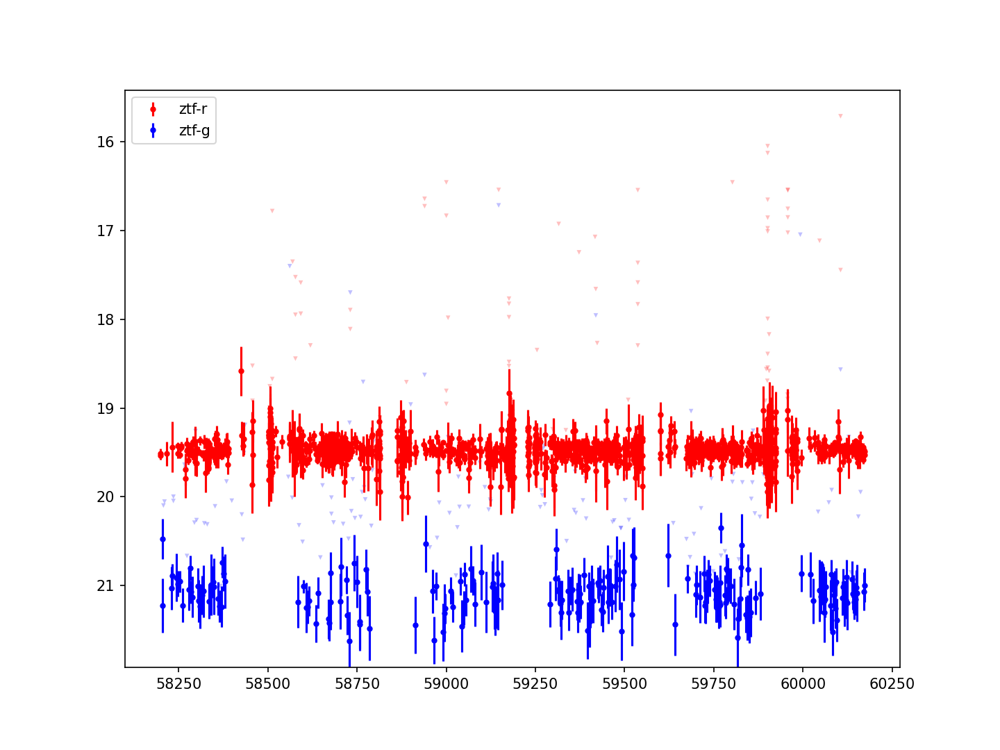

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.68333333333%2C+14.40333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254148


<IPython.core.display.Javascript object>


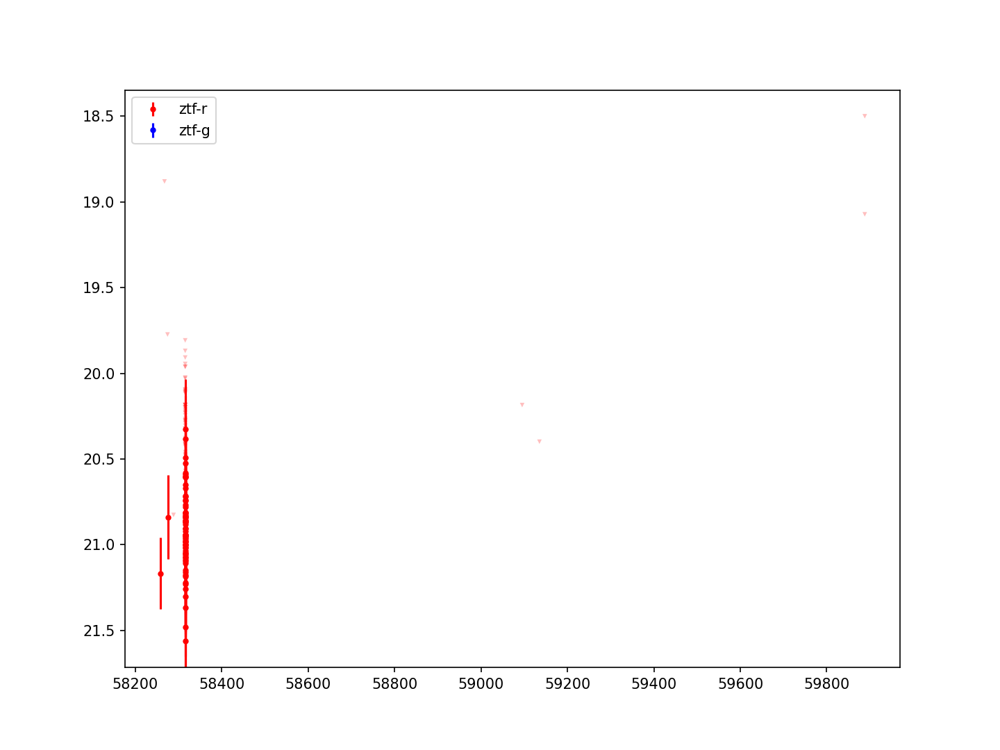

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.848993%2C+-17.104585&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254149


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


<IPython.core.display.Javascript object>


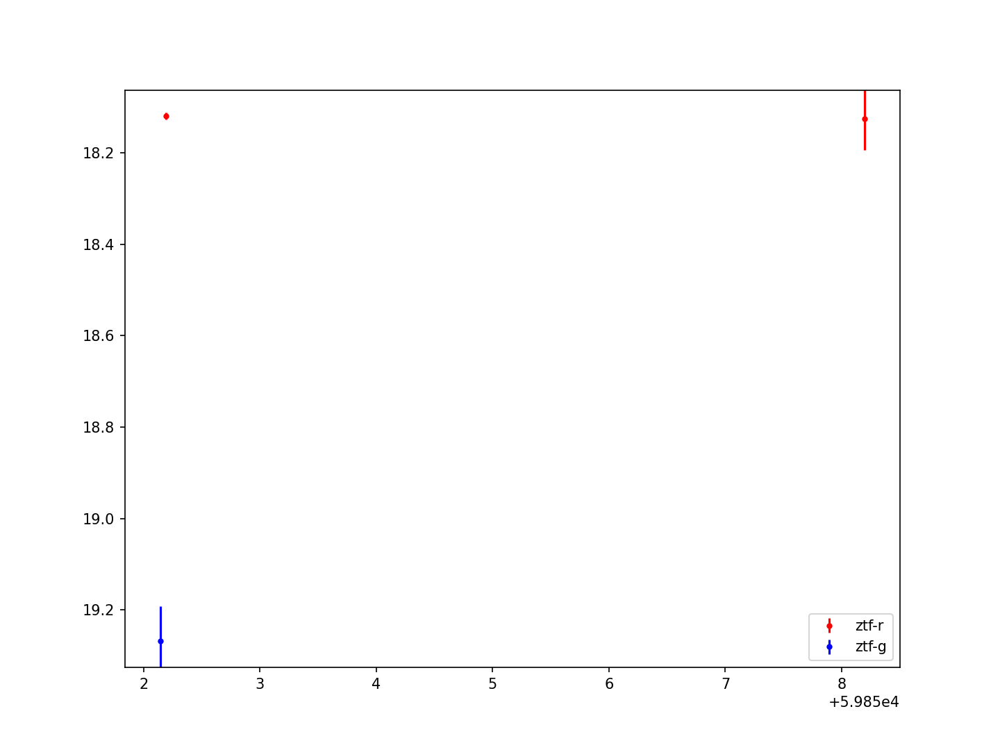

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=280.5726375%2C+-11.41757305556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254150


<IPython.core.display.Javascript object>


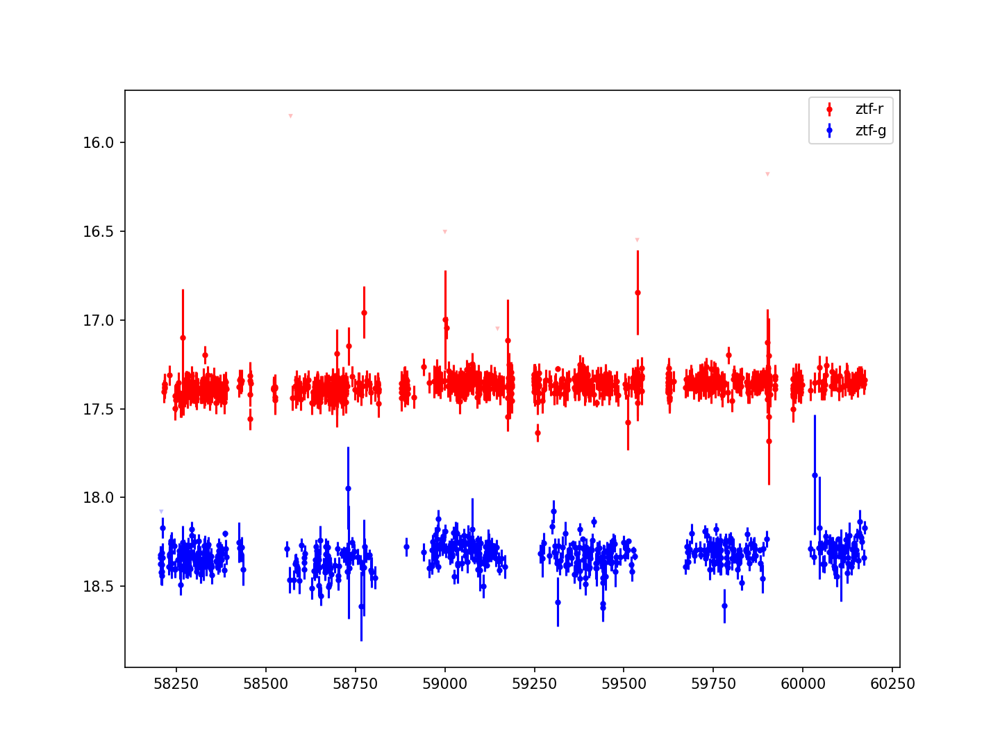

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=279.98982083333%2C+5.03597222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254151


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


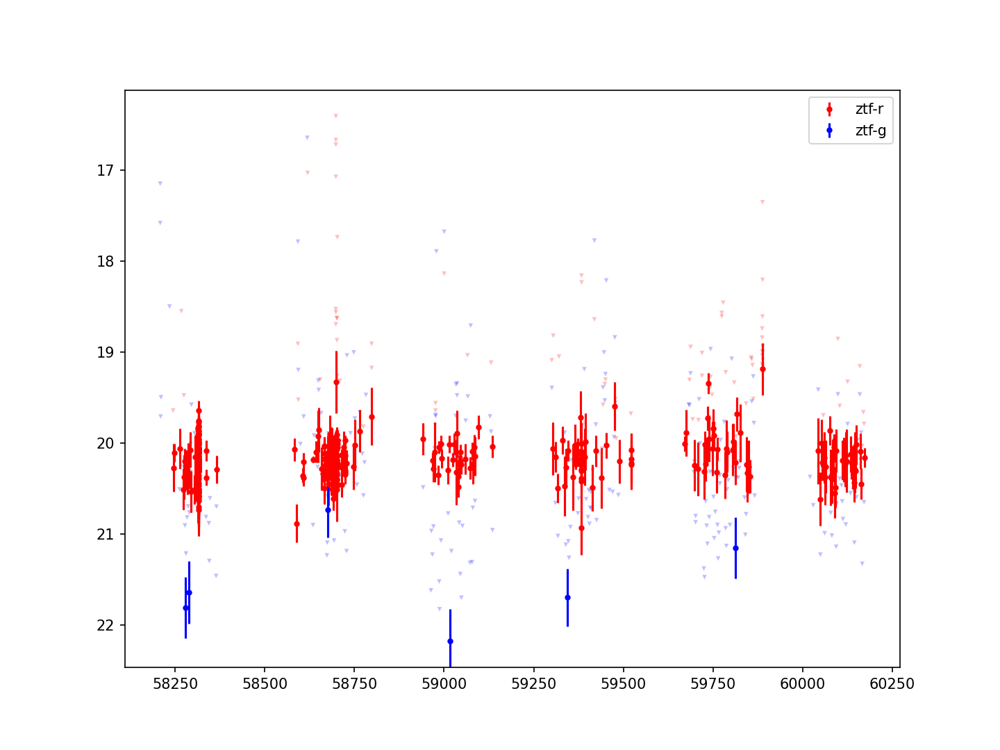

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=274.218333%2C+-19.632583&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254152


<IPython.core.display.Javascript object>


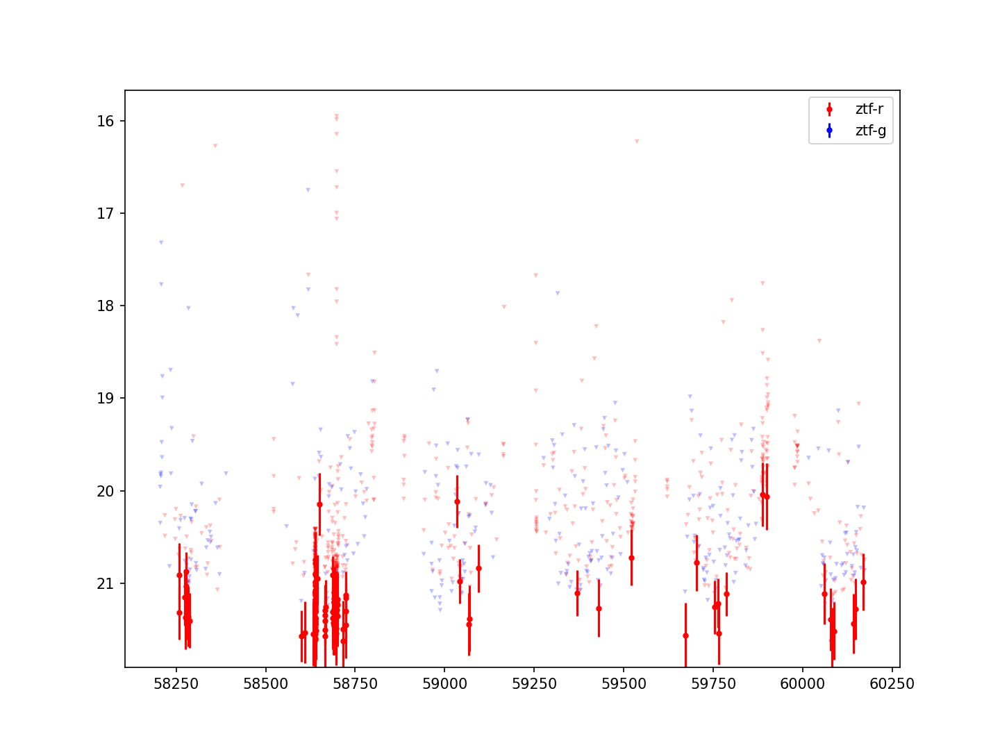

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=272.675%2C+-10.86666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254153


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


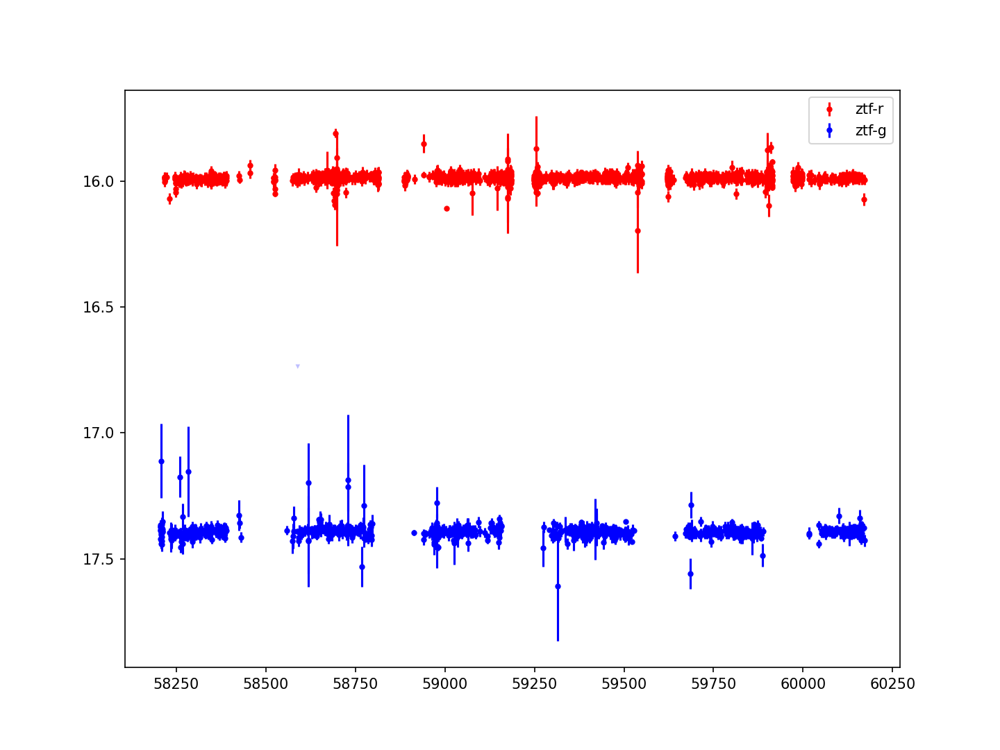

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=280.89479166667%2C+-3.71572222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254155


<IPython.core.display.Javascript object>


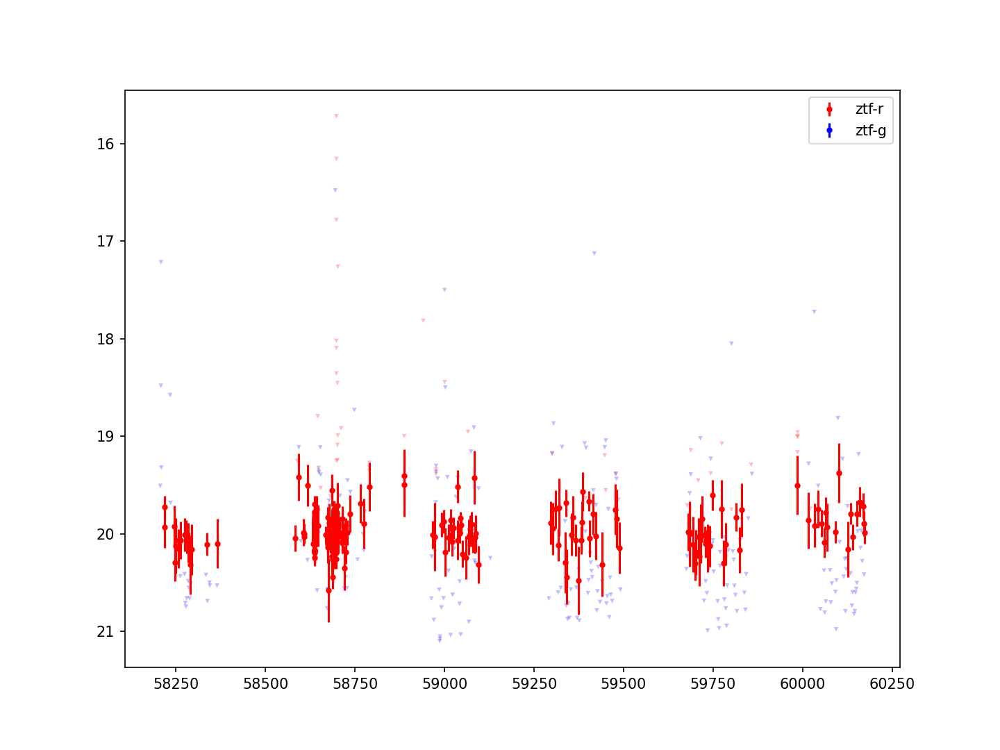

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=272.58691666667%2C+-19.06977777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254156


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


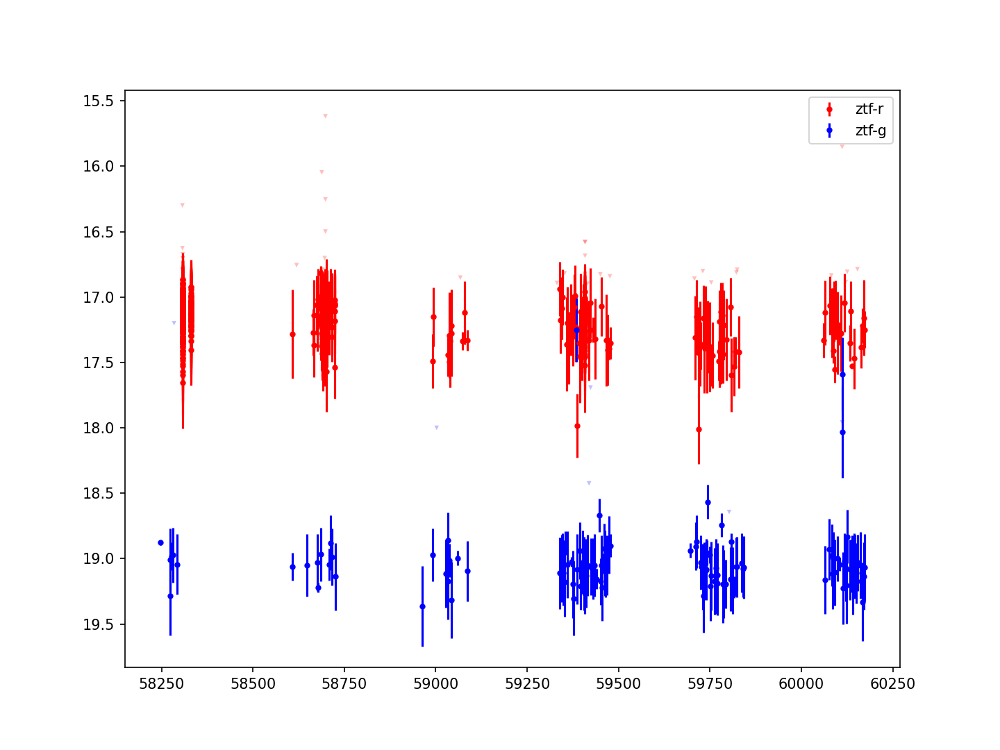

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=272.318875%2C+-25.90702777778&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254160


<IPython.core.display.Javascript object>


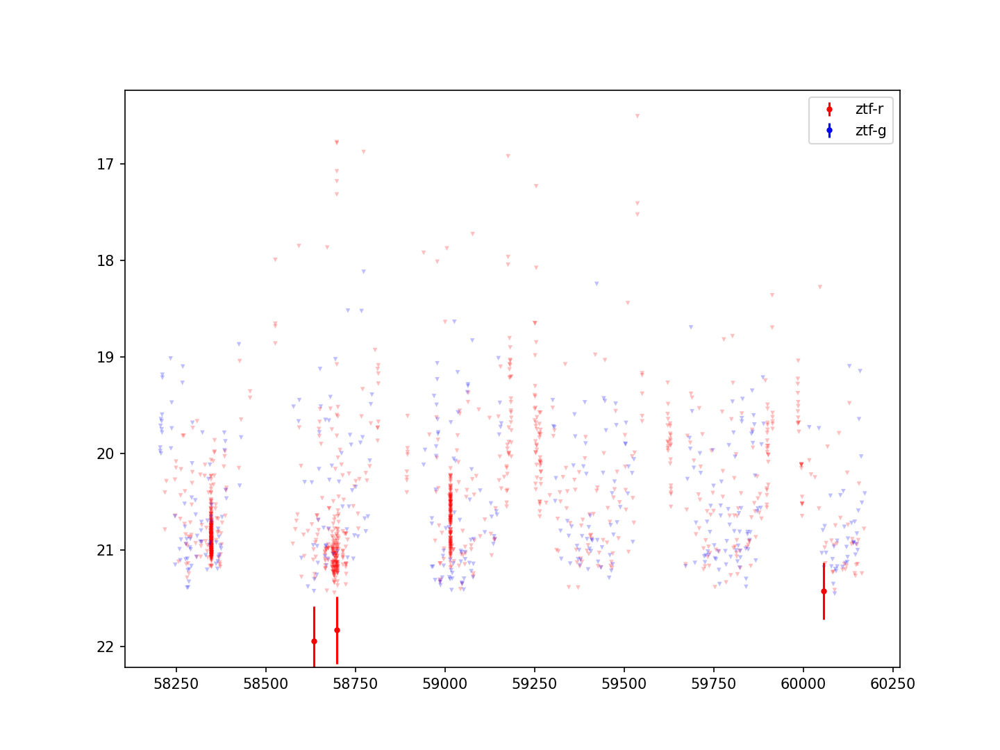

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=282.2%2C+-1.48666666667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254161


<IPython.core.display.Javascript object>


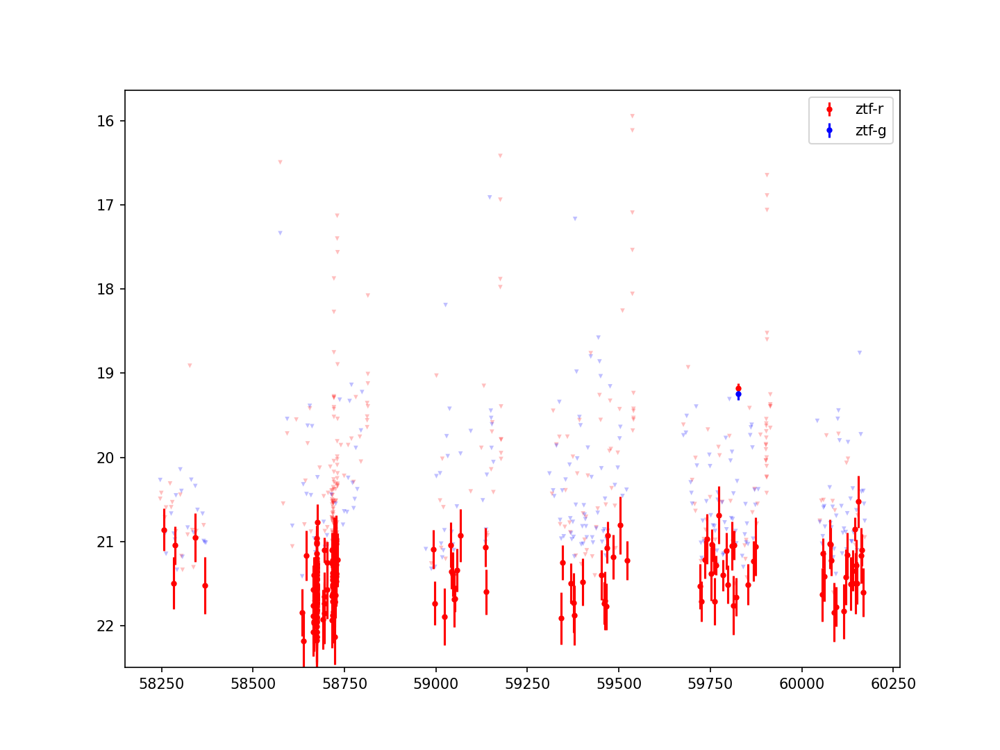

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=290.65416666667%2C+-17.28363888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254162


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


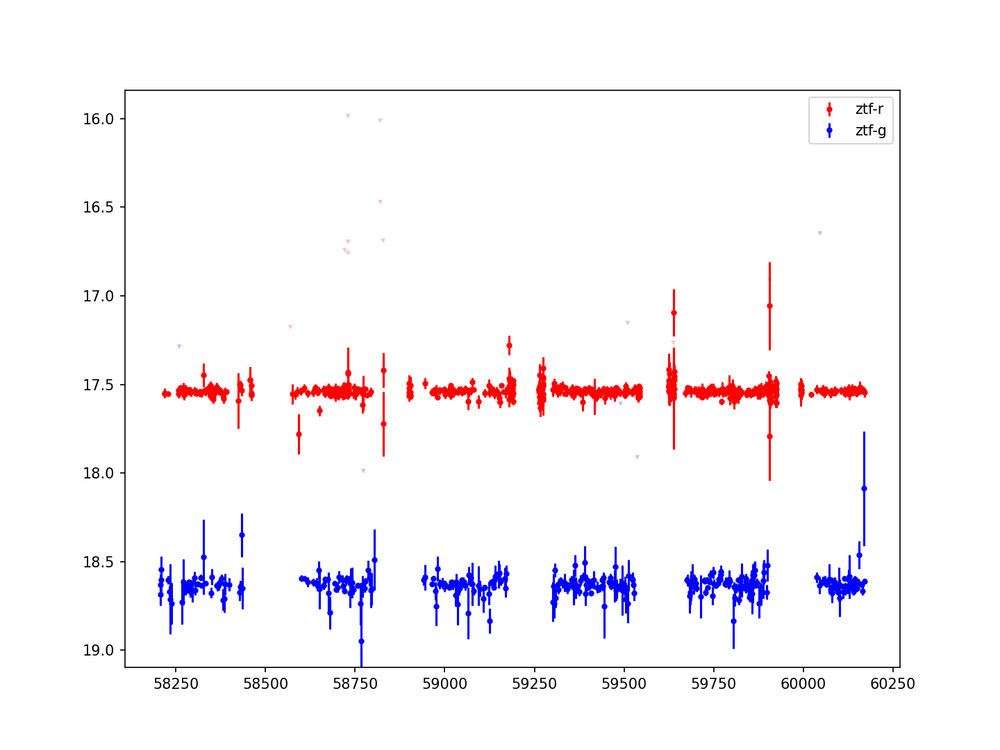

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=289.72083333333%2C+-5.25333333333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254163


<IPython.core.display.Javascript object>


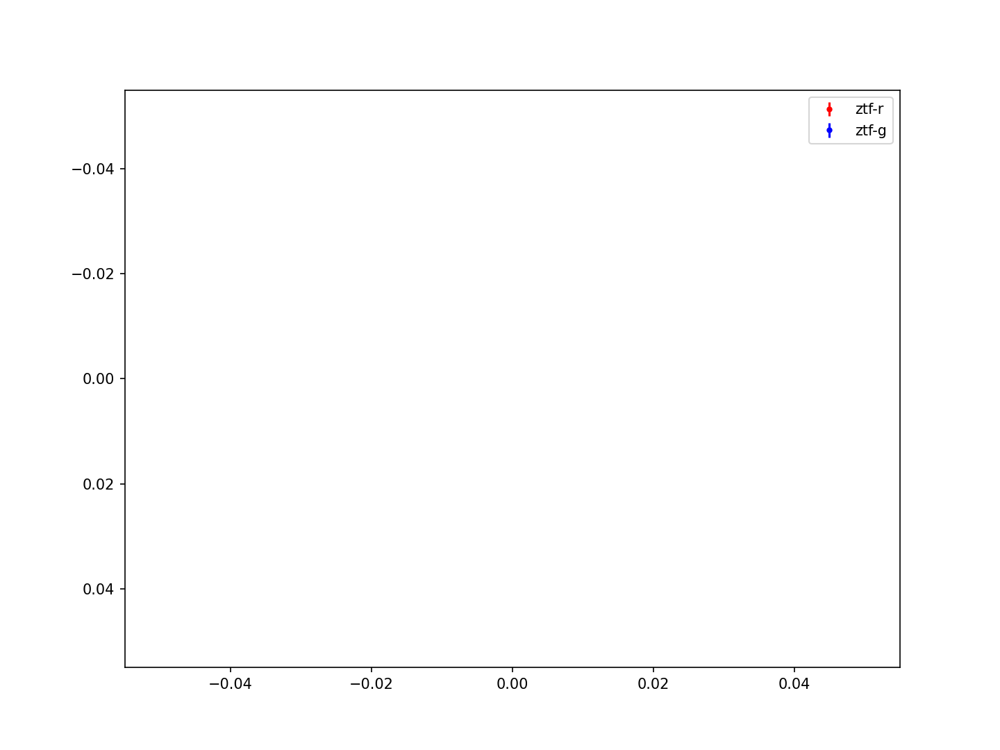

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=292.71148217295%2C+5.51613829189&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254164


<IPython.core.display.Javascript object>


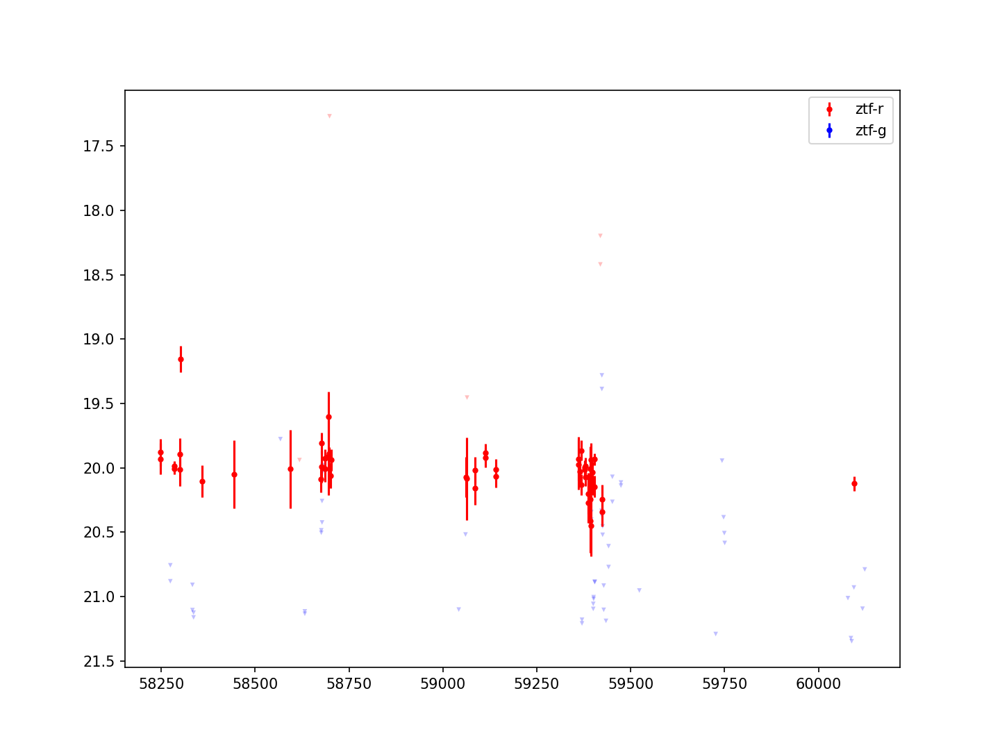

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=290.07083333333%2C+14.705&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254165


<IPython.core.display.Javascript object>


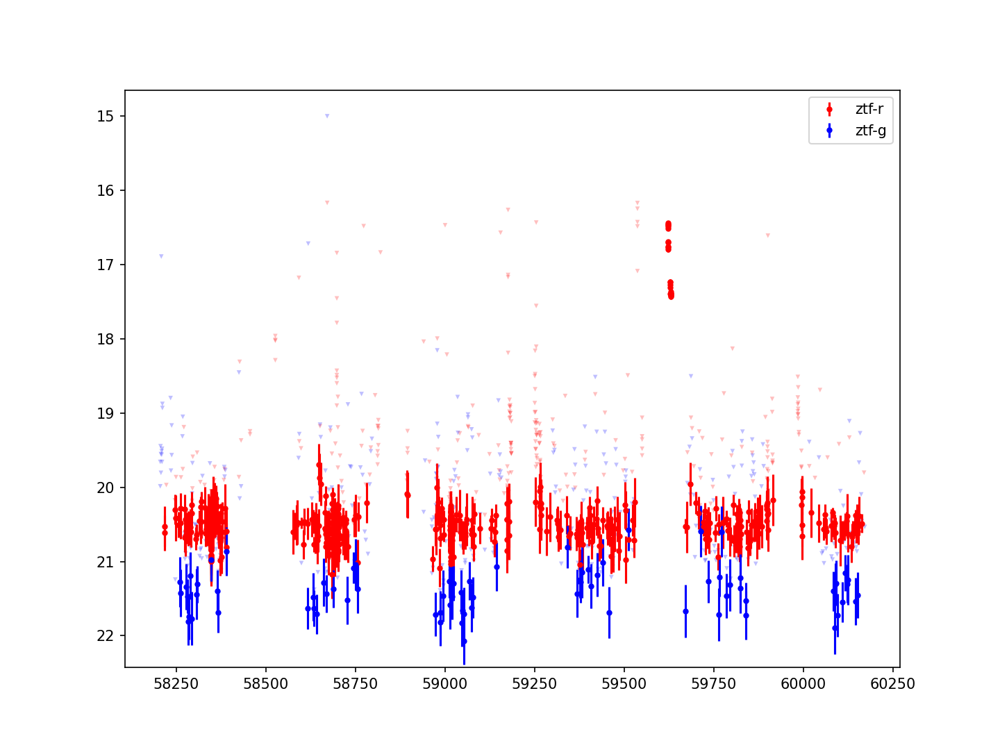

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=287.595%2C+-5.79886111111&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254166


<IPython.core.display.Javascript object>


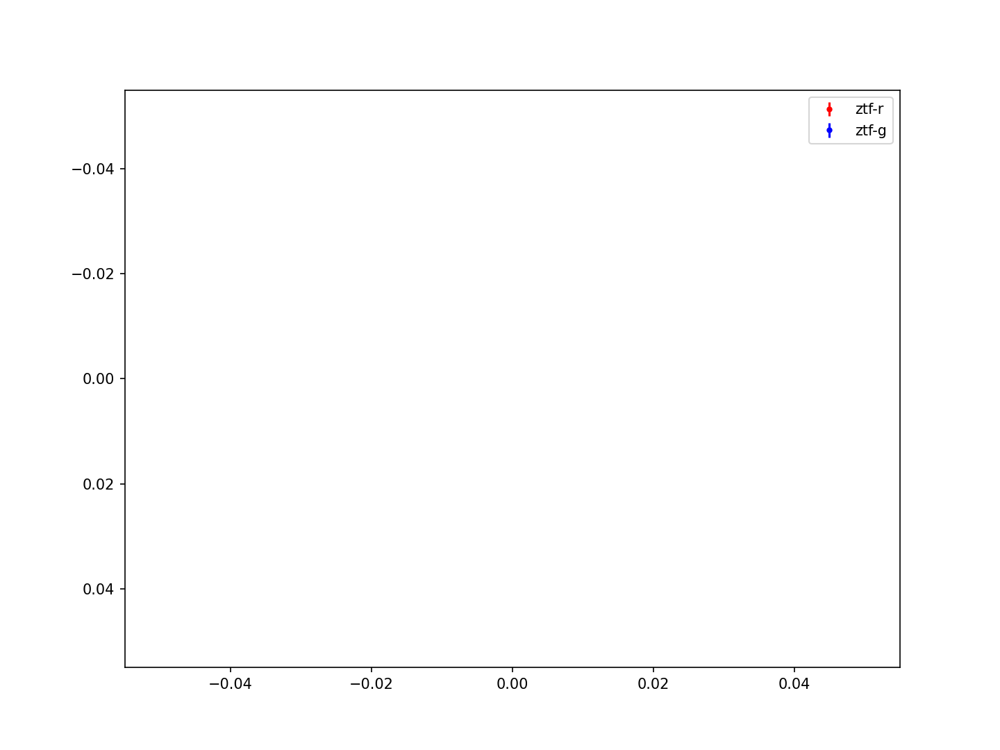

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=285.03600918346%2C+-24.920564951&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254168


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


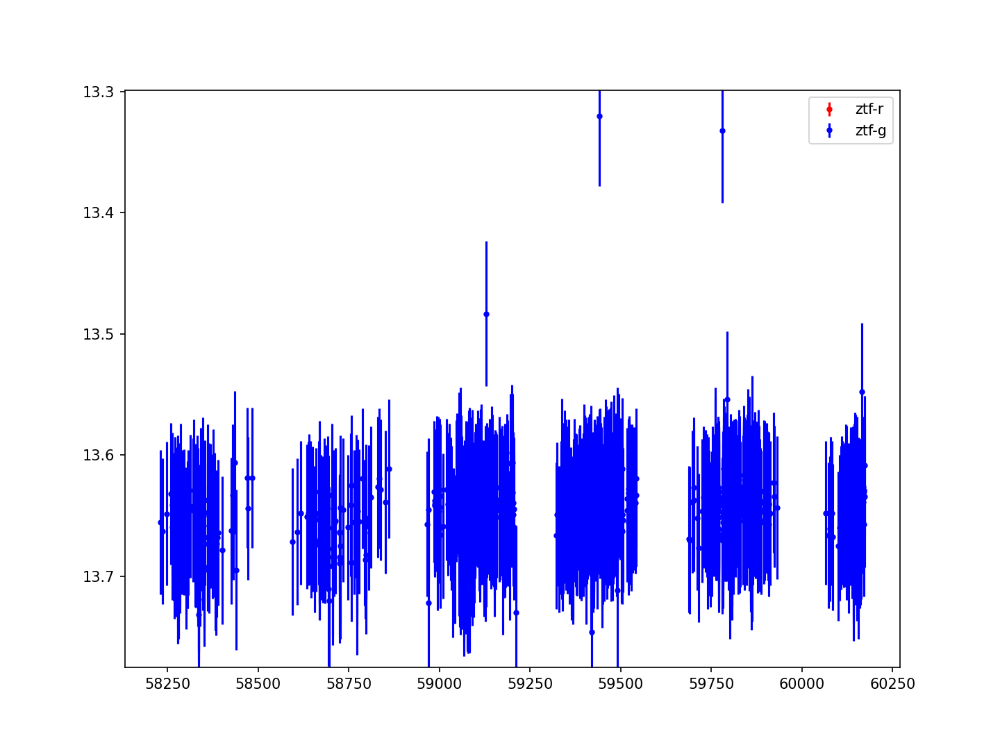

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=322.4923125%2C+12.16112222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254169


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


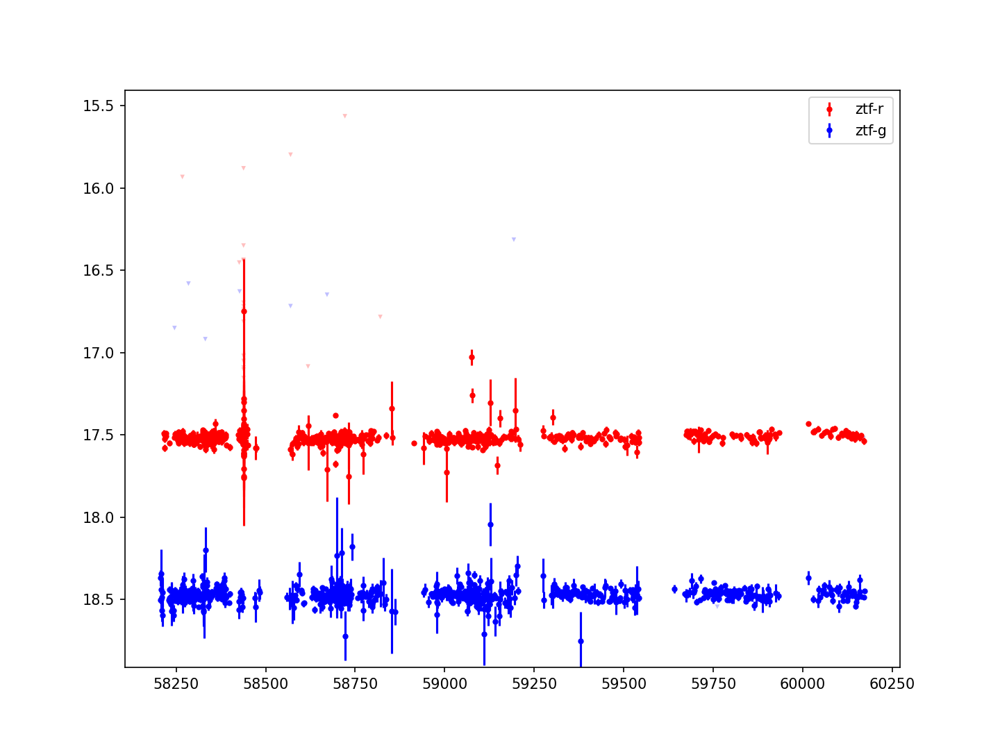

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=303.15730783536%2C+38.18351819815&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254170


<IPython.core.display.Javascript object>


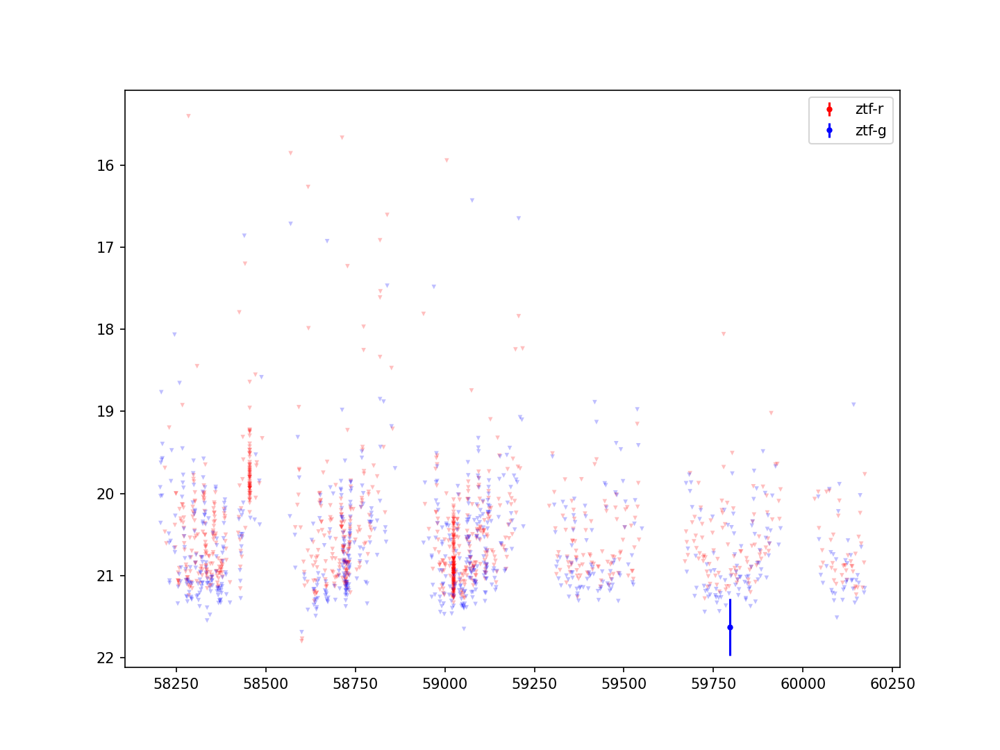

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=309.273335%2C+41.834774&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254171


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


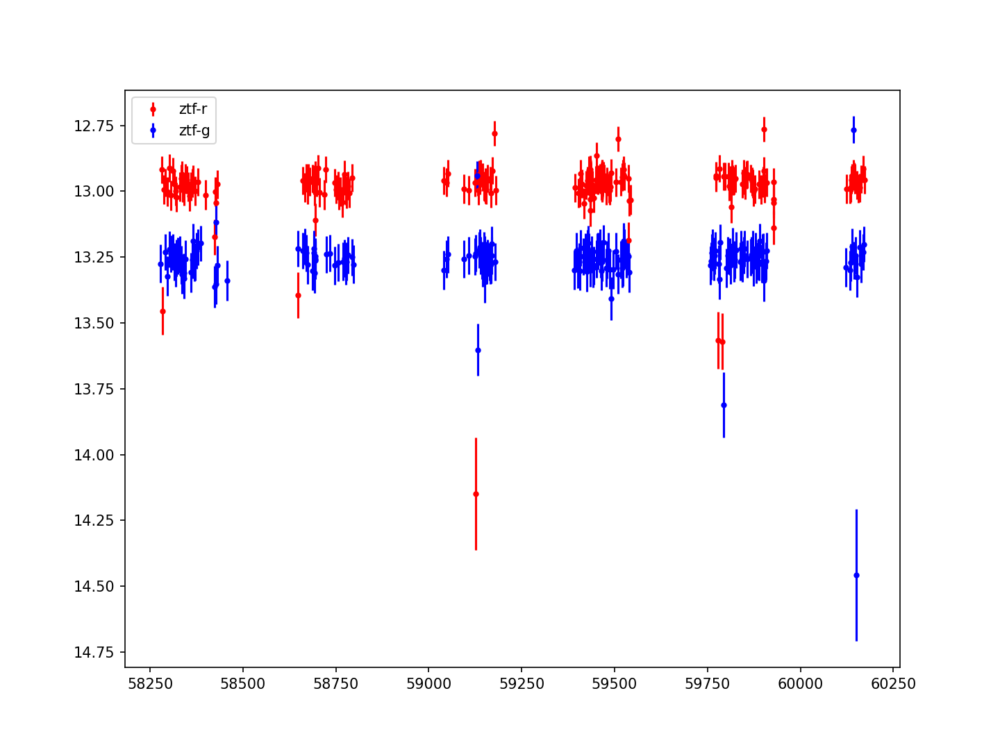

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=325.09220833333%2C+-23.179325&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254172


<IPython.core.display.Javascript object>


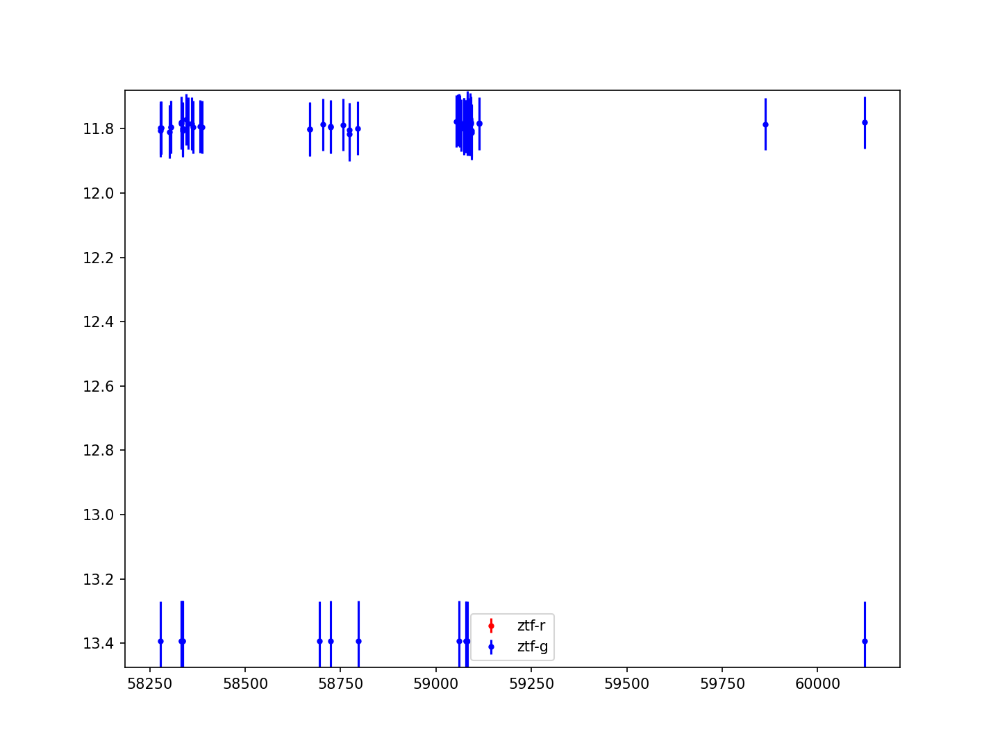

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=322.49296833333%2C+12.16740833333&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254173


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


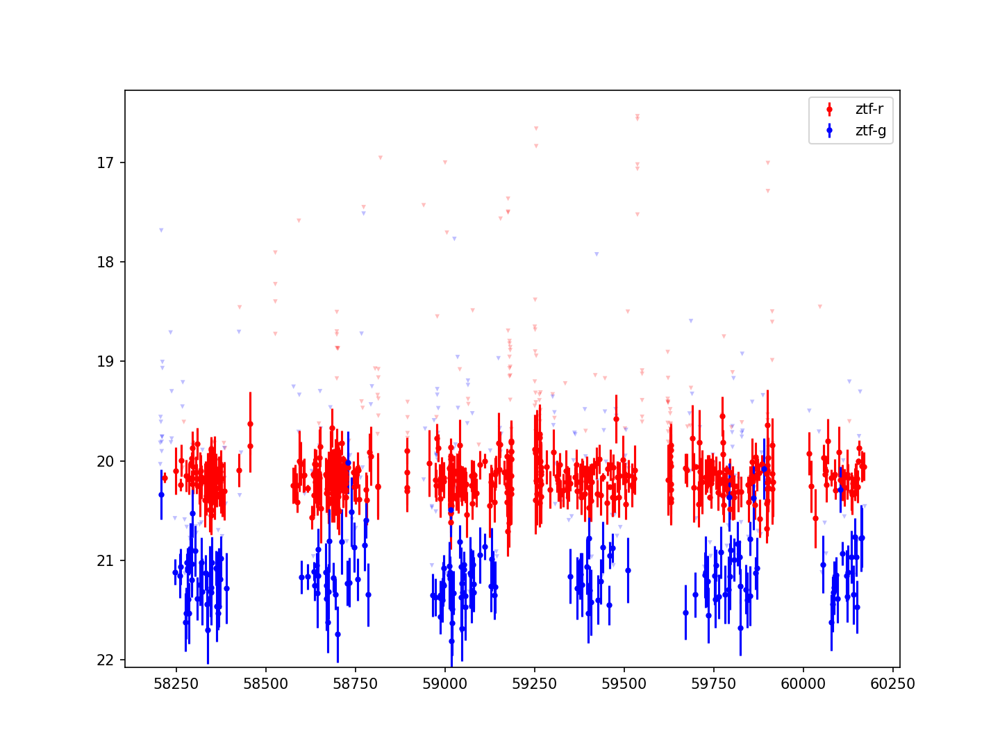

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=287.112375%2C+0.16880555556&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254174


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


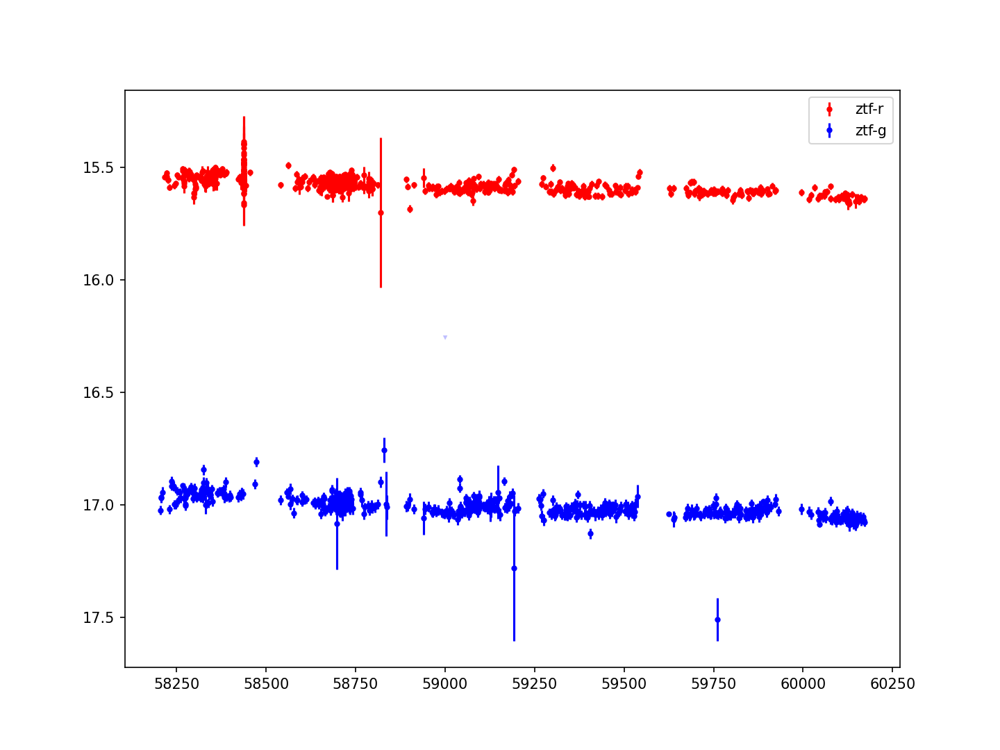

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=295.30866666667%2C+40.23488888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254175


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


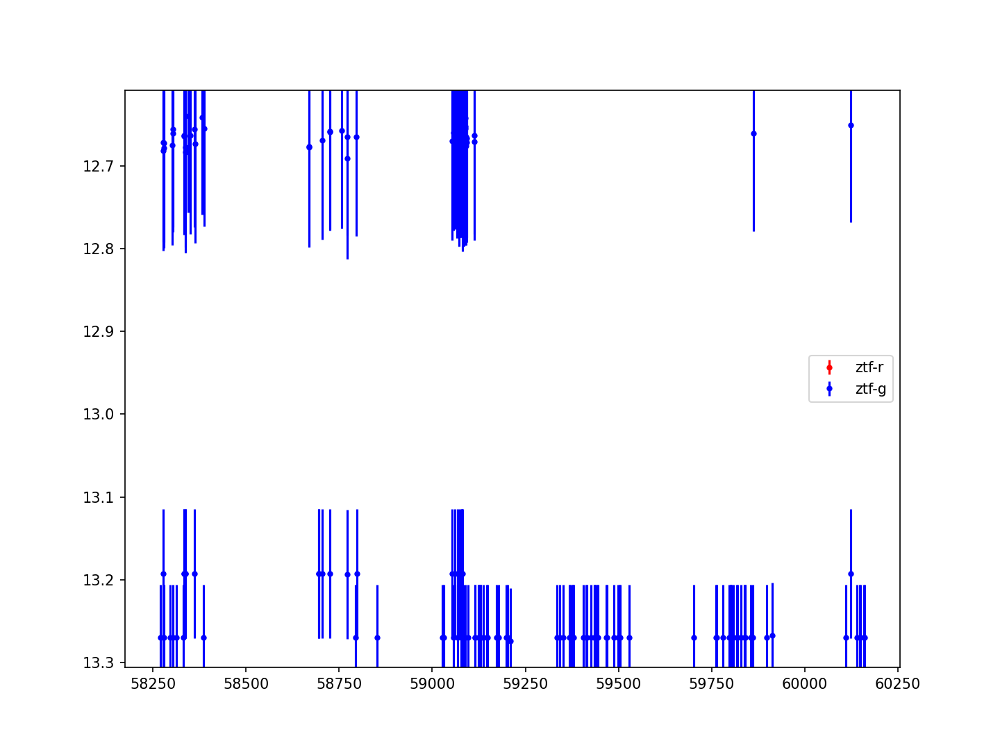

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=322.49191666667%2C+12.16738888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254176


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


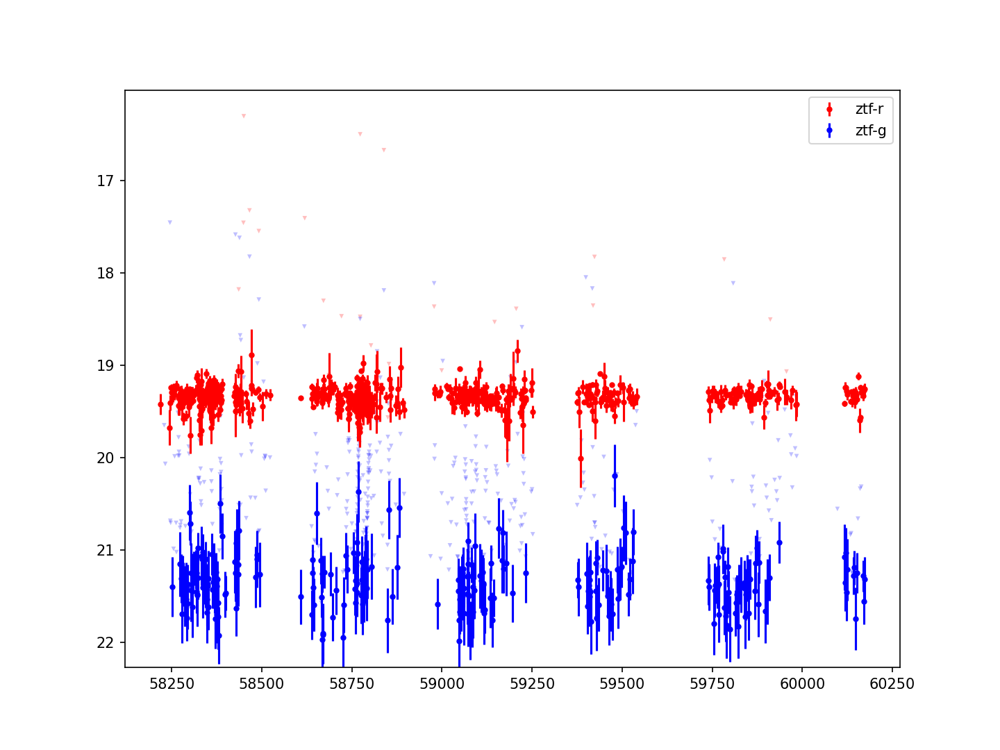

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=350.14221428355%2C+62.29270576989&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254177


<IPython.core.display.Javascript object>


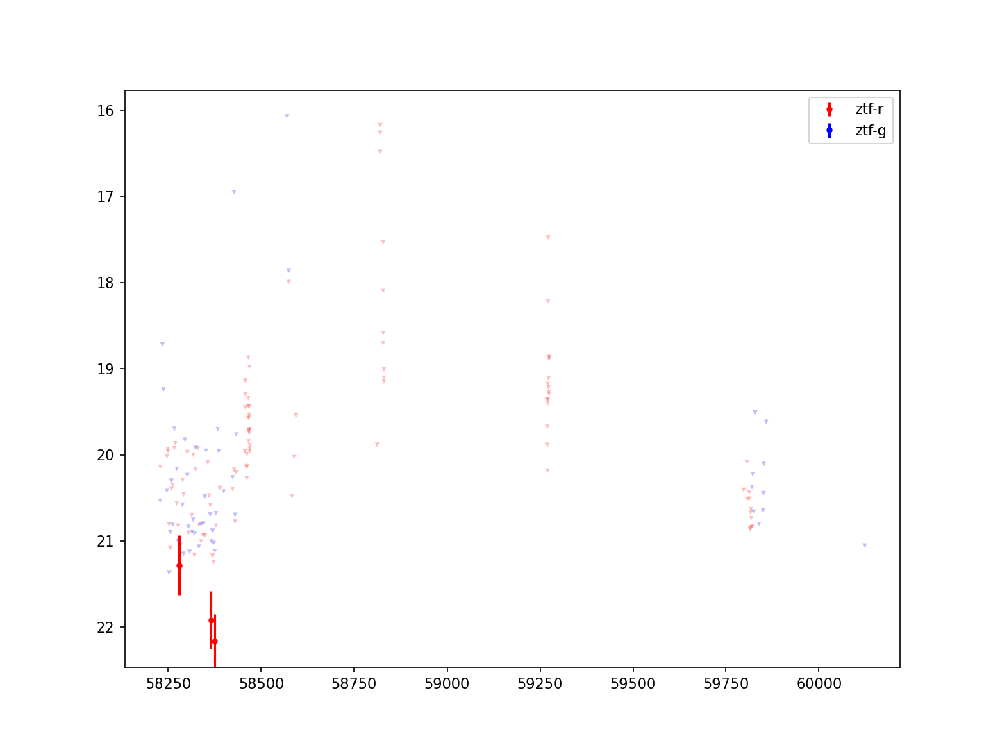

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=295.65833333333%2C+-3.9&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254178


<IPython.core.display.Javascript object>


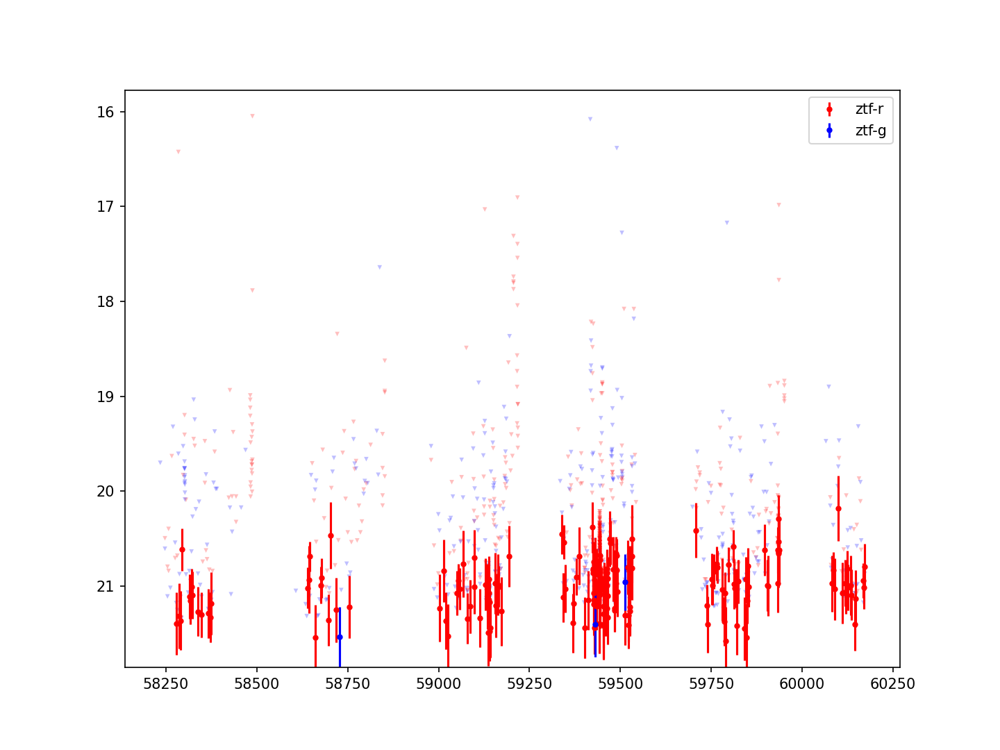

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=320.810579%2C+-5.7981281&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254179


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


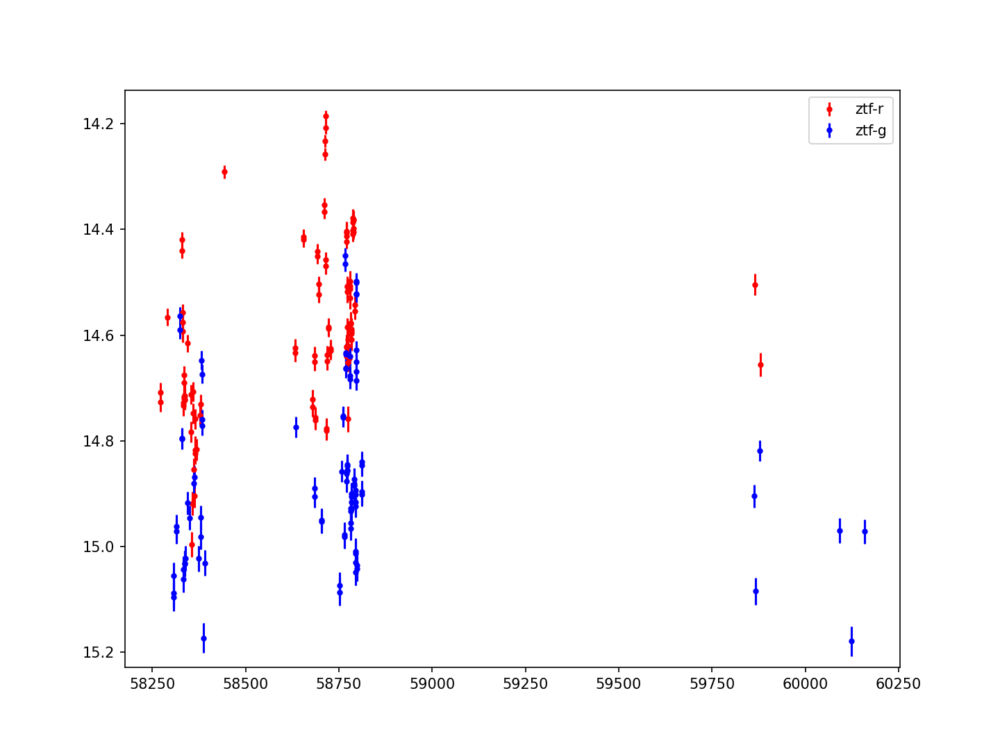

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=326.17146666896%2C+38.32140593926&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254180


<IPython.core.display.Javascript object>


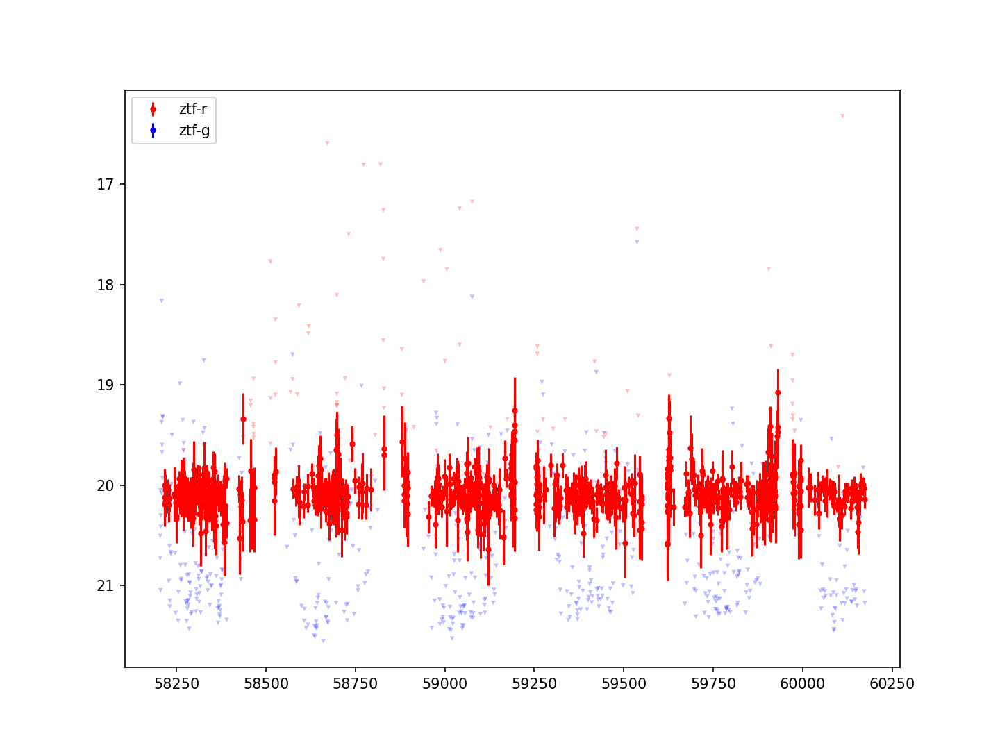

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=287.2211283%2C+9.3847308&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254181


<IPython.core.display.Javascript object>


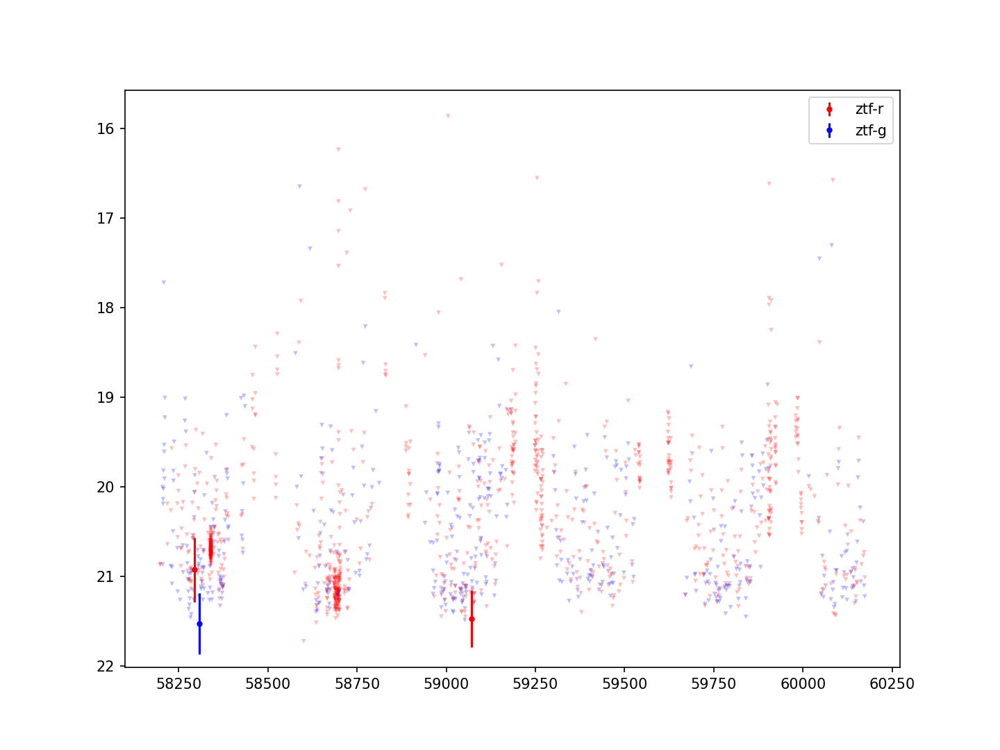

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=285.4175%2C+1.44194444444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254182


<IPython.core.display.Javascript object>


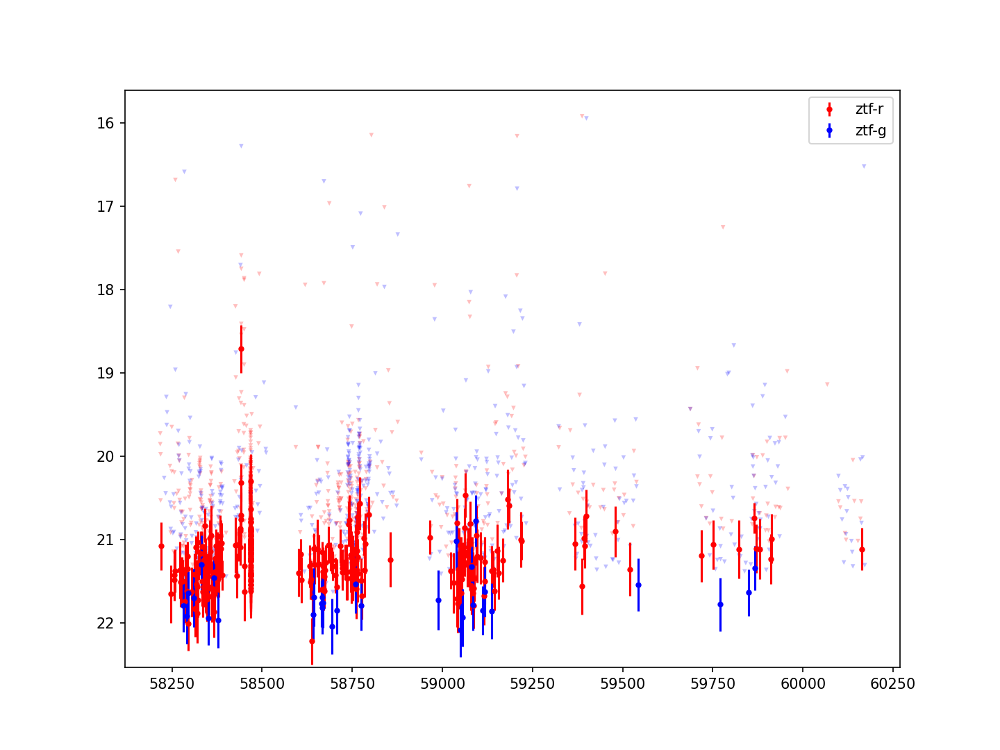

C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=336.206875%2C+54.38613888889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254183


C:\Users\allis\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


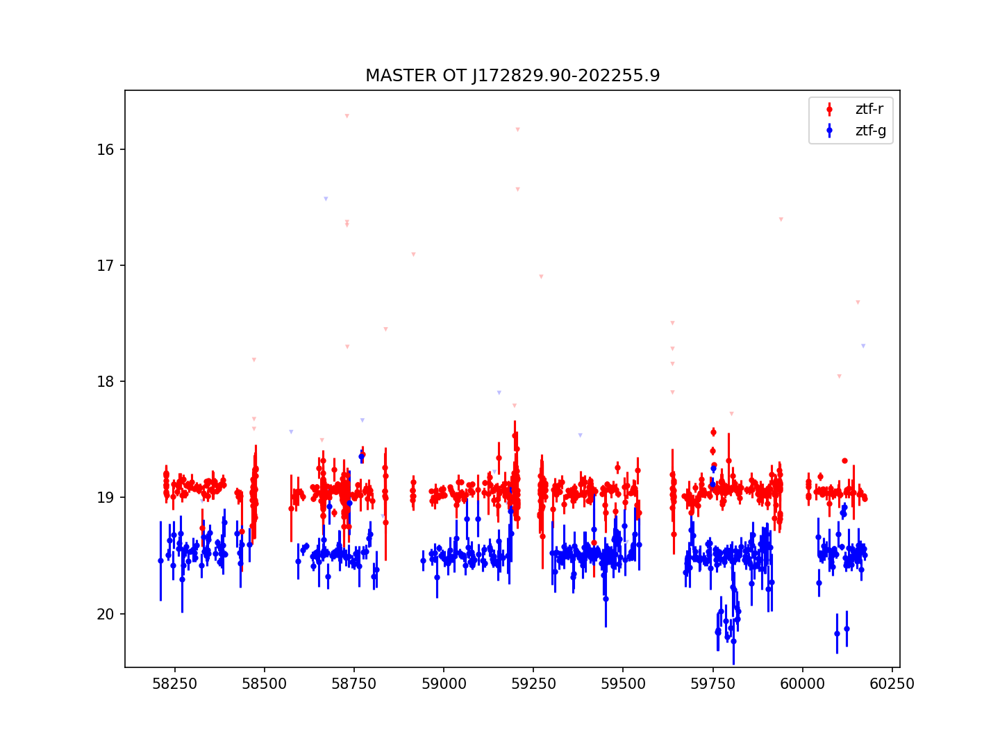

SIMBAD query:
https://simbad.u-strasbg.fr/simbad/sim-coo?Coord=299.16291666667%2C+3.44547222222&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3&Radius.unit=arcsec&submit=submit+query&CoordList=
Request ID: 254184


C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:44: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)
C:\Users\allis\anaconda3\lib\site-packages\numpy\core\_methods.py:40: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)


In [128]:
data = []
colors = ['blue', 'pink', 'red']
for f in [x for x in os.listdir(DATA_DIR) if '.txt' in x]:
    ztf_fp = get_lightcurve(DATA_DIR+f)
    
    plt.figure(figsize=(9.6,7.2))
    wr = ztf_fp['filter'] == 'ZTF_r'
    wg = ztf_fp['filter'] == 'ZTF_g'

    plt.errorbar(ztf_fp.loc[wr,'mjd'],ztf_fp.loc[wr,'dc_mag'],
                 ztf_fp.loc[wr,'dc_mag_err'],fmt='o',ls='none', color=colors[2], markersize = 3, label='ztf-r')
    plt.scatter(ztf_fp.loc[wr,'mjd'],ztf_fp.loc[wr,'dc_maglim'], marker='v',alpha=0.25,
                edgecolor='none',color=colors[2], s=10)
    plt.errorbar(ztf_fp.loc[wg,'mjd'],ztf_fp.loc[wg,'dc_mag'],
                 ztf_fp.loc[wg,'dc_mag_err'],fmt='o',ls='none', color=colors[0], markersize=3, label='ztf-g')
    plt.scatter(ztf_fp.loc[wg,'mjd'],ztf_fp.loc[wg,'dc_maglim'], marker='v',alpha=0.25,
                edgecolor='none',color=colors[0], s=10)

    row = output.loc[output['reqId'] == pd.to_numeric(f[:6])]
    row = row.reset_index()
    ra = row['ra'][0]
    dec = row['dec'][0]
    
    simbad_link(ra, dec)
    print(f"Request ID: {f[:6]}")
    
    
  #  plt.title(f"Request ID: {f[:6]}")
    plt.legend()
    plt.gca().invert_yaxis()
    plt.show()
    
    plt.savefig(f'catalog_phot_graphs/{f[:6]}.png')
